# TODO

1) move-ance of data points across groups as a distribution

2) KL divergence for each variability, and for 4-dimensional data

3) plot only the KDE density plot for each datamap, to compare them on the same graph. Same for the 3 subplots...have transparent histplots with foxed axis to display them all

# Imports

In [43]:
!apt-get install texlive texlive-latex-extra texlive-fonts-recommended dvipng cm-super

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
cm-super is already the newest version (0.3.4-17).
dvipng is already the newest version (1.15-1.1).
texlive is already the newest version (2021.20220204-1).
texlive-fonts-recommended is already the newest version (2021.20220204-1).
texlive-latex-extra is already the newest version (2021.20220204-1).
0 upgraded, 0 newly installed, 0 to remove and 24 not upgraded.


In [44]:
# !pip install tensorflow
# !pip install transformers
# !pip install tavolo
# !pip install matplotlib
# !pip install seaborn
# !pip install gensim
# !pip install scikit-learn
# !pip install tqdm
!pip install datasets
!pip install --upgrade tensorflow-datasets

In [45]:

%load_ext autoreload
%autoreload 2

import math
import re
import tempfile
from typing import Iterable, List, Optional, Tuple
import time
import json

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

import gensim.downloader as api
import numpy as np
import pandas as pd
import tensorflow_datasets as tfds
import tensorflow as tf
from datasets import load_dataset, Dataset
from datasets import Dataset as HFDataset
# import tavolo as tvl
from tensorflow.keras.models import load_model
from tensorflow.keras.metrics import Precision, Recall
import transformers
from tqdm import tqdm
from typing import TypedDict, List, Dict
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
from IPython.display import display, Markdown
from scipy.special import softmax
from sklearn.metrics import adjusted_mutual_info_score, accuracy_score, precision_score, recall_score, f1_score
from sklearn.cluster import KMeans
from sklearn.neighbors import KDTree
from transformers import InputExample
from transformers import (
    AutoTokenizer,
    DistilBertTokenizer,
    RobertaTokenizerFast,
    RobertaTokenizer,
    TFRobertaForSequenceClassification,
    TFDistilBertModel,
    TFDistilBertForSequenceClassification,
    glue_convert_examples_to_features,
    TFAutoModelForSequenceClassification,
    TFBertForSequenceClassification,
    TFRobertaForSequenceClassification,
    TFMPNetForSequenceClassification,
    TFAlbertForSequenceClassification
)

import nltk
nltk.download('punkt')
from nltk.tokenize import sent_tokenize

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [46]:
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [47]:
plt.rcParams.update({
    "text.usetex": True, # Use LaTeX to render text
    "font.family": "serif", # Use serif font, which matches LaTeX documents
    "text.latex.preamble": r"\usepackage{amsmath}", # To support LaTeX commands like \text
})

# Set plot style
sns.set_style('whitegrid')
sns.set_palette('Set2')

# Google Drive and GPU Setup

In [48]:
from google.colab import drive
drive.mount('/content/drive/')

import os
os.chdir('/content/drive/MyDrive/Colab Notebooks/Cambridge/L101')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [49]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

/bin/bash: line 1: nvidia-smi: command not found


# Define Functions

In [68]:
def prepare_data_lists(input_examples):
    idx_list = []
    question_list = []
    sentence_list = []
    label_list = []

    for example in input_examples:
        idx_list.append(example.guid)
        question_list.append(example.text_a)
        sentence_list.append(example.text_b)
        label_list.append(int(example.label))

    return idx_list, question_list, sentence_list, label_list


def convert_to_qnli_format(data):
    qnli_style_data = []
    # 1. Transforming from adversarial_squad format into QNLI format
    for item in tqdm(data):
        context = item['context']
        question = item['question']
        sentences = sent_tokenize(context)

        if '-high-conf-turk' in item['id']:
            # Adversarial Sentence
            mislead_sentence = sentences[-1]
            qnli_style_data.append({'idx': item['id'], 'label': 1, 'question': question, 'sentence': mislead_sentence})
        else:
            # Non-Adversarial Sentence
            answer_start = item['answers']['answer_start'][0]
            correct_sentence = next(s for s in sentences if context.find(s) <= answer_start < context.find(s) + len(s))
            qnli_style_data.append({'idx': item['id'], 'label': 0, 'question': question, 'sentence': correct_sentence})

    # 2. Creating a HuggingFace InputExample object for each sample
    input_examples = [InputExample(guid=sample['idx'],
                                   text_a=sample['question'],
                                   text_b=sample['sentence'],
                                   label=str(sample['label']))
                      for sample in qnli_style_data]

    # 3. Prepare separate lists for each field
    idx_list, question_list, sentence_list, label_list = prepare_data_lists(input_examples)

    # 4. Create a TensorFlow dataset
    return tf.data.Dataset.from_tensor_slices({
        'idx': idx_list,
        'question': question_list,
        'sentence': sentence_list,
        'label': label_list
    })


def convert_to_csv(data_list, file_name, dataset=None):
    # Create a DataFrame and decode binary strings
    if dataset == 'glue/qnli':
        df = pd.DataFrame(data_list)
        df['question'] = df['question'].str.decode('utf-8')
        df['sentence'] = df['sentence'].str.decode('utf-8')
    elif dataset == 'snli':
        df = pd.DataFrame(data_list)
        df['premise'] = df['premise'].str.decode('utf-8')
        df['hypothesis'] = df['hypothesis'].str.decode('utf-8')
    else:
        print('Enter a valid dataset please')
        return

    # Define the label text based on the dataset
    def process_label(label):
        if dataset == 'glue/qnli':
            return f"{label} ({['entailment', 'neutral', 'contradiction'][label]})"
        elif dataset == 'snli':
            return f"{label} ({'entailment' if label == 0 else 'not entailment'})"
        else:
            return str(label)

    # Apply the label processing
    df['label'] = df['label'].apply(process_label)

    # Rearrange columns based on the dataset
    if dataset == 'snli':
        df = df[['idx', 'premise', 'hypothesis', 'label']]
    elif dataset == 'glue/qnli':
        df = df[['idx', 'question', 'sentence', 'label']]

    # Export to CSV
    df.to_csv(file_name, index=False)


def get_samples_by_index(dataset: tf.data.Dataset, indices: List[int]) -> List[dict]:
    """
    Get samples by their index

    :param dataset:
    :param indices:
    :return:
    """

    # Convert indices to tensor with dtype tf.int64
    indices_tensor = tf.convert_to_tensor(indices, dtype=tf.int64)

    def filter_fn(sample):
        # Cast idx of the sample to int64 for comparison
        sample_idx = tf.cast(sample['idx'], tf.int64)
        return tf.reduce_any(tf.equal(sample_idx, indices_tensor))

    # Apply filter to the dataset
    filtered_dataset = dataset.filter(filter_fn)

    # Collect samples
    samples = list(filtered_dataset.as_numpy_iterator())

    return samples



class InnerDict(TypedDict):
    gold_label_probs: List[float]
    confidence: float
    variability: float
    correctness: float
    forgetfulness: float

TrainingDynamicsDictType = Dict[str, InnerDict]

def get_training_dynamics_by_index(training_dynamics: TrainingDynamicsDictType, indices: List[int]) -> TrainingDynamicsDictType:
    return {k: v for k, v in training_dynamics.items() if int(k) in indices}

def get_samples_and_training_dynamics_by_index(dataset: tf.data.Dataset, training_dynamics: TrainingDynamicsDictType, indices: List[int]):
    return get_samples_by_index(dataset, indices), get_training_dynamics_by_index(training_dynamics, indices)

def save_training_dynamics(tdc_map, reference_set):
    gold_label_probs = tdc_map.gold_labels_probabilities
    confidence = tdc_map.confidence
    variability = tdc_map.variability
    correctness = tdc_map.correctness
    forgetfulness = tdc_map.forgetfulness
    # For partial dataset training, track the count to limit when to stop looping over reference_set
    dataset_map_length = len(gold_label_probs)

    # MUST MAKE ABSOLUTE SURE
    json_dict = {}
    for i, example in enumerate(tqdm(tfds.as_numpy(reference_set), desc='Saving training default dataset to json')):
        idx = convert_numpy(example["idx"])
        json_dict[idx] = {
            "gold_label_probs": convert_numpy(gold_label_probs[i]),
            "confidence": confidence[i],
            "variability": variability[i],
            "correctness": correctness[i],
            "forgetfulness": forgetfulness[i],
        }

        if i == (dataset_map_length-1):
            break

    # with open(f'training_dynamics/{tag}.json', 'w') as file:
    #     # Dump the list of dictionaries to the file
    #     json.dump(json_dict, file)

    # Create directory if it does not exist
    directory_path = f'training_dynamics/{tdc_map._dataset_name}'
    if not os.path.exists(directory_path):
        os.makedirs(directory_path)

    json_file_name = f'{directory_path}/{tdc_map._model_name}.json'
    print(f'\nSaving training dynamics to {json_file_name}.')
    with open(json_file_name, 'w') as file:
        json.dump(json_dict, file)


def pretty_print_samples(samples: List[dict], title: Optional[str]):
    """
    Print samples as Markdown

    :param samples: Samples to print
    :param title: Title
    :return:
    """

    # Convert samples to markdown
    samples_as_markdown = list()
    for sample in samples:
        samples_as_markdown.append(f"""
 - **Question**: {sample['question']}

   **Sentence**: {sample['sentence']}

   **Label**: {'True' if sample['label'] == 0 else 'False'}


""")
    samples_as_markdown = "\n".join(samples_as_markdown)

    markdown_output = f"""
### {title}
{samples_as_markdown}
"""

    display(Markdown(markdown_output))

def convert_numpy(obj):
    if isinstance(obj, np.integer):
        return int(obj)
    elif isinstance(obj, np.floating):
        return float(obj)
    elif isinstance(obj, np.ndarray):
        return obj.tolist()
    elif isinstance(obj, bytes):
        return obj.decode('utf-8')
    else:
        return obj

def extract_by_training_dynamics(datamap: np.ndarray,
                                 n_ambiguous: int = 0,
                                 n_easy2learn: int = 0,
                                 n_hard2learn: int = 0) -> Tuple[list, list, list]:
    """
    Extract indices of different types of samples

    :param datamap: Datamap
    :param n_ambiguous: Number of ambiguous samples to extract
    :param n_easy2learn: Number of easy-to-learn samples to extract
    :param n_hard2learn: Number of hard-to-learn samples to extract
    :return: Three lists of ambiguous, easy-to-learn and hard-to-learn indices
    """

    kdt = KDTree(datamap, metric='euclidean')
    ambiguous = list()
    easy2learn = list()
    hard2learn = list()

    if n_easy2learn:
        _, easy2learn = kdt.query([[0, 1]],
                                  k=n_easy2learn)

    if n_ambiguous:
        _, ambiguous = kdt.query([[1, 0.5]],
                                 k=n_ambiguous)

    if n_hard2learn:
        _, hard2learn = kdt.query([[0, 0]],
                                  k=n_hard2learn)

    return list(ambiguous[0]), list(easy2learn[0]), list(hard2learn[0])

def load_training_dynamics_from_json(path_to_json):
    with open(path_to_json, 'r') as file:
        training_dynamics_dict = json.load(file)

    indexes = []
    gold_labels_probabilities = []
    confidences = []
    variabilities = []
    correctnesses = []
    forgetfulnesses = []

    for idx, td_dict in tqdm(training_dynamics_dict.items(), desc=f'Fetching training dynamics from saved json file: {path_to_json}'):
        indexes.append(int(idx))
        gold_labels_probabilities.append(td_dict['gold_label_probs'])
        confidences.append(td_dict['confidence'])
        variabilities.append(td_dict['variability'])
        correctnesses.append(td_dict['correctness'])
        forgetfulnesses.append(td_dict['forgetfulness'])


    gold_labels_probabilities = np.array(gold_labels_probabilities)

    return np.array(gold_labels_probabilities), np.array(confidences), np.array(variabilities), np.array(correctnesses), np.array(forgetfulnesses), indexes, training_dynamics_dict


def convert_from_hf_to_tf_dataset(hf_dataset):
    # Convert Hugging Face dataset to TensorFlow dataset
    features = {key: hf_dataset[key] for key in hf_dataset.features}
    return tf.data.Dataset.from_tensor_slices(features)



def get_datasets(dataset_name, train_subset_indices=None, additional_subset=None, ):
    print(f'Fetching dataset: {dataset_name}')
    train_unshuffled = None
    train = None
    validation = None
    test = None

    def filter_fn(data):
        # Assuming that the dataset has a field named 'idx' for indices
        return tf.reduce_any(tf.equal(train_subset_indices, data['idx']))

    def add_idx_to_dataset(dataset):
        # Enumerate over the dataset to add the idx field
        if isinstance(dataset, HFDataset):
            def add_idx(example, idx):
                return {'idx': idx, **example}

            # Use map with with_indices=True for Arrow datasets
            return dataset.map(add_idx, with_indices=True)

        return dataset.enumerate().map(lambda idx, datapoint: {'idx': idx, **datapoint}, num_parallel_calls=tf.data.experimental.AUTOTUNE)

    if dataset_name == 'glue/qnli':
        train_unshuffled = tfds.load(dataset_name, split='train', shuffle_files=False, try_gcs=False)
        train = tfds.load(dataset_name, split='train', shuffle_files=True)
        validation_ = tfds.load(dataset_name, split='validation', shuffle_files=True)

        # using sharded validation set
        validation = validation_.shard(2, index=0)  # Split validation into test and validation
        test = validation_.shard(2, index=1)


    elif dataset_name == 'multi_nli':
        if additional_subset is None:
            validation_matched = tfds.load(dataset_name, split='validation_matched', shuffle_files=False, try_gcs=False)
            validation_mismatched = tfds.load(dataset_name, split='validation_mismatched', shuffle_files=False, try_gcs=False)
            validation = validation_matched.concatenate(validation_mismatched)
        elif additional_subset == 'matched':
            validation = tfds.load(dataset_name, split='validation_matched', shuffle_files=False, try_gcs=False)
        elif additional_subset == 'mismatched':
            validation = tfds.load(dataset_name, split='validation_mismatched', shuffle_files=False, try_gcs=False)

    elif dataset_name == 'adv_qnli':
        test = load_dataset("adv_glue", "adv_qnli")['validation']
        test = convert_from_hf_to_tf_dataset(test)


    elif dataset_name == 'adv_mnli':
        if additional_subset is None:
            test_matched = load_dataset("adv_glue", "adv_mnli")['validation']
            test_mismatched = load_dataset("adv_glue", "adv_mnli_mismatched")['validation']
            test_matched = convert_from_hf_to_tf_dataset(test_matched)
            test_mismatched = convert_from_hf_to_tf_dataset(test_mismatched)
            test = test_matched.concatenate(test_mismatched)
        elif additional_subset == 'matched':
            test = load_dataset("adv_glue", "adv_mnli")['validation']
            test = convert_from_hf_to_tf_dataset(test)
        elif additional_subset == 'mismatched':
            test = load_dataset("adv_glue", "adv_mnli_mismatched")['validation']
            test = convert_from_hf_to_tf_dataset(test)

    elif dataset_name == 'scitail':
        def transform_example(example):
            new_example = {
                'sentence': example['sentence1'],
                'label': 0 if example['gold_label'] == 'entails' else 1,
                'question': example['question']
            }
            return new_example

        test = load_dataset("scitail", "predictor_format")['test']
        test = test.map(transform_example)
        test = convert_from_hf_to_tf_dataset(test)
        test = add_idx_to_dataset(test)

    elif dataset_name == 'anli':
        def rename_context_to_premise(dataset):
            return dataset.map(lambda x: {'premise': x['context'], **{k: v for k, v in x.items() if k != 'context'}})

        if additional_subset is None:
            test_r1 = tfds.load('anli/r1', split='test', shuffle_files=False, try_gcs=False)
            test_r2 = tfds.load('anli/r2', split='test', shuffle_files=False, try_gcs=False)
            test_r3 = tfds.load('anli/r3', split='test', shuffle_files=False, try_gcs=False)
            test = test_r1.concatenate(test_r2).concatenate(test_r3)
        elif additional_subset == 'r1':
            dataset_name = 'anli/r1'
            test = tfds.load(dataset_name, split='test', shuffle_files=False, try_gcs=False)
        elif additional_subset == 'r2':
            dataset_name = 'anli/r2'
            test = tfds.load(dataset_name, split='test', shuffle_files=False, try_gcs=False)
        elif additional_subset == 'r3':
            dataset_name = 'anli/r3'
            test = tfds.load(dataset_name, split='test', shuffle_files=False, try_gcs=False)
        test = add_idx_to_dataset(test)
        test = rename_context_to_premise(test)

    elif dataset_name == 'glue/rte':
        test = train_unshuffled = tfds.load(dataset_name, split='test', shuffle_files=False, try_gcs=False)

    elif dataset_name == 'adversarial_squad':
        # https://huggingface.co/datasets/squad_adversarial
        squad_adversarial_addsent = load_dataset("squad_adversarial", "AddSent")
        squad_adversarial_addsent = squad_adversarial_addsent['validation']
        squad_adversarial_addsent = add_idx_to_dataset(squad_adversarial_addsent)

        # assign each partition the same...for this dataset we don't care about true training, just calculating training dynamics
        train_unshuffled = squad_adversarial_addsent
        train = squad_adversarial_addsent
        validation = squad_adversarial_addsent
        test = squad_adversarial_addsent


    elif dataset_name == 'glue_diagnostics':
        # download from pietrolesci huggingface
        test = load_dataset("pietrolesci/glue_diagnostics")['test']
        test = convert_from_hf_to_tf_dataset(test)
        test = add_idx_to_dataset(test)

        def filter_lex(item):
            return tf.not_equal(item['lexical semantics'], tf.constant(b'', dtype=tf.string))

        def filter_pas(item):
            return tf.not_equal(item['predicate-argument structure'], tf.constant(b'', dtype=tf.string))

        def filter_log(item):
            return tf.not_equal(item['logic'], tf.constant(b'', dtype=tf.string))

        def filter_kno(item):
            return tf.not_equal(item['knowledge'], tf.constant(b'', dtype=tf.string))

        # Apply the filter based on the additional_subset
        if additional_subset == 'lex':
            test = test.filter(filter_lex)
        elif additional_subset == 'pas':
            test = test.filter(filter_pas)
        elif additional_subset == 'log':
            test = test.filter(filter_log)
        elif additional_subset == 'kno':
            test = test.filter(filter_kno)

        # assign each partition the same...for this dataset we don't care about true training, just calculating training dynamics
        train_unshuffled = test
        train = test
        validation = test
        test = test


    elif dataset_name == 'winogrande':
        train_unshuffled = tfds.load(dataset_name, split='train_l', shuffle_files=False, try_gcs=False)
        train = tfds.load(dataset_name, split='train_l', shuffle_files=True)
        validation = tfds.load(dataset_name, split='validation', shuffle_files=True)
        test = tfds.load(dataset_name, split='test', shuffle_files=False)

    elif dataset_name == 'snli':
        # remove data points with:
        # - empty premise
        # - empty hypothesis
        # - label of -1 (no consensus)
        def filter_snli(data):
            def filter_fn(d):
                # Check if premise and hypothesis are not empty strings and label is not -1
                premise_non_empty = tf.not_equal(d['premise'], tf.constant(b'', dtype=tf.string))
                hypothesis_non_empty = tf.not_equal(d['hypothesis'], tf.constant(b'', dtype=tf.string))
                label_not_negative_one = tf.not_equal(d['label'], tf.constant(-1, dtype=tf.int64))

                return tf.logical_and(tf.logical_and(premise_non_empty, hypothesis_non_empty), label_not_negative_one)

            # Apply the filter function to the dataset
            filtered_data = data.filter(filter_fn)
            return filtered_data

        train_unshuffled = tfds.load('snli', split='train', shuffle_files=False, try_gcs=False)
        train = tfds.load('snli', split='train', shuffle_files=True)
        validation = tfds.load('snli', split='validation', shuffle_files=True)
        test = tfds.load('snli', split='test', shuffle_files=False)
        print(f'type of train_unshuffled is: {type(train_unshuffled)}')
        print(f'type of test is: {type(test)}')

        train_unshuffled = filter_snli(train_unshuffled)
        train = filter_snli(train)
        validation = filter_snli(validation)
        test = filter_snli(test)
        print(f'type of train_unshuffled is: {type(train_unshuffled)}')
        print(f'type of test is: {type(test)}')

        train_unshuffled = add_idx_to_dataset(train_unshuffled)
        train = add_idx_to_dataset(train)
        validation = add_idx_to_dataset(validation)
        test = add_idx_to_dataset(test)
        print(f'type of train_unshuffled is: {type(train_unshuffled)}')
        print(f'type of test is: {type(test)}')



    elif dataset_name == 'wsc':
        validation = tfds.load('super_glue/wsc.fixed', split='validation', shuffle_files=True)

    if train_subset_indices:
        # filter with only correct indices
        train_unshuffled = train_unshuffled.filter(filter_fn)
        train = train.filter(filter_fn)


    return train_unshuffled, train, validation, test

def take_samples(dataset, n):
    """
    Takes n samples from the dataset.
    Works for both TensorFlow's _ShardDataset and Hugging Face's Dataset.
    """
    print(type(dataset))
    if isinstance(dataset, tf.data.Dataset):
        # TensorFlow dataset
        return dataset.take(n)
    elif isinstance(dataset, Dataset):
        # Hugging Face Arrow dataset
        return dataset.select(range(n))
    else:
        raise TypeError("Unsupported dataset type")

def convert_dataset(dataset, tokenizer, task_name):
    sample_amount = 2
    print(type(dataset))
    sample_data = take_samples(dataset, sample_amount)
    print(f'Printing {sample_amount} examples from dataset: {dataset}')
    for i, sample in enumerate(sample_data):
        print(f"Sample {i+1}: {sample}")

    print(f'Converting examples to features.')
    start = time.time()
    # ================================
    # SNLI style datasets
    # ================================
    if task_name in ['snli', 'glue_diagnostics', 'multi_nli', 'anli', 'adv_mnli']:
        def preprocess_and_tokenize(dataset, tokenizer):
            tokenized_data = []
            labels = []

            for example in dataset:
                premise = example['premise'].numpy().decode('utf-8')
                hypothesis = example['hypothesis'].numpy().decode('utf-8')

                if task_name == 'anli':
                    filtered_premise = ' '.join([word for word in premise.split() if word.lower() not in stop_words])
                else:
                    filtered_premise = premise

                concatenated_sentence = "<s> " + filtered_premise + " </s></s> " + hypothesis + " </s>"

                # Tokenizing the concatenated sentence
                tokenized_example = tokenizer(concatenated_sentence,
                                            padding='max_length',
                                            truncation=True,
                                            max_length=128,
                                            return_tensors='tf')
                tokenized_data.append(tokenized_example)

                # Assuming the label is in example['label']
                labels.append(example['label'].numpy())

            return tokenized_data, labels

        def create_tf_dataset(tokenized_data, labels):
            input_ids = tf.constant([item['input_ids'].numpy()[0] for item in tokenized_data])
            attention_mask = tf.constant([item['attention_mask'].numpy()[0] for item in tokenized_data])

            dataset = tf.data.Dataset.from_tensor_slices(({"input_ids": input_ids, "attention_mask": attention_mask}, labels))
            return dataset


        tokenized_snli_data, labels = preprocess_and_tokenize(dataset, tokenizer)
        dataset = create_tf_dataset(tokenized_snli_data, labels)
    # ================================
    # QNLI style datasets
    # ================================
    elif task_name in ['glue/qnli', 'adv_qnli', 'scitail', 'adversarial_squad']:
        if task_name == 'adversarial_squad':
            dataset = convert_to_qnli_format(dataset)
        # max_len=128 and task='qnli'
        dataset = glue_convert_examples_to_features(dataset, tokenizer, max_length=128, task='qnli')

    # ================================
    # WinoGrande and WSC (Winograd Schema Challenge)
    # ================================
    elif task_name in ['winogrande', 'wsc']:
        print(f'Converting {task_name} dataset. Length of dataset: {len(dataset)}')
        start = time.time()

        def convert_example_to_feature(example):
            # Convert each example to the appropriate format
            # This will depend on the structure of the dataset and the task
            # For example, you might need to format the text into a cloze-style format
            # and encode it using the tokenizer

            # Example conversion (please modify as per actual dataset format):
            text = example['sentence'] if task_name == 'wsc' else example['text']
            encoding = tokenizer.encode_plus(
                text,
                add_special_tokens=True,
                max_length=128,
                return_token_type_ids=False,
                padding='max_length',
                truncation=True,
                return_attention_mask=True,
                return_tensors='tf',
            )
            return {'input_ids': encoding['input_ids'],
                    'attention_mask': encoding['attention_mask']}, example['label']

        dataset = dataset.map(convert_example_to_feature, num_parallel_calls=tf.data.experimental.AUTOTUNE)

    print(f"Time taken: {time.time() - start:.2f} seconds")
    return dataset

def get_model(model_name, dataset_name):
    print(f'Loading pre-trained model.')

    num_labels = 2 if dataset_name in ['glue/qnli', 'adversarial_squad', 'winogrande', 'wsc', 'scitail', 'adv_qnli'] else 3
    problem_type="multi_label_classification" if num_labels == 3 else 'single_label_classification'
    print(f'Number of labels for dataset {dataset_name} is: {num_labels}')

    if 'test' in model_name:
        model = TFDistilBertForSequenceClassification.from_pretrained('roberta-base', num_labels=num_labels)
    elif model_name == 'distilbert-base-cased':
        model = TFDistilBertForSequenceClassification.from_pretrained(model_name, num_labels=num_labels)
    elif model_name == 'bert-base-cased':
        model = TFBertForSequenceClassification.from_pretrained(model_name, num_labels=num_labels)
    elif model_name == 'bert-large-cased':
        model = TFBertForSequenceClassification.from_pretrained(model_name, num_labels=num_labels)
    elif model_name == 'distilroberta-base':
        # model = TFRobertaForSequenceClassification.from_pretrained(model_name, num_labels=num_labels)
        model = TFRobertaForSequenceClassification.from_pretrained(model_name, num_labels=num_labels)
    elif model_name == 'roberta-base':
        model = TFRobertaForSequenceClassification.from_pretrained(model_name, num_labels=num_labels)
    elif model_name == 'roberta-large':
        model = TFAutoModelForSequenceClassification.from_pretrained(model_name, num_labels=num_labels)
    elif model_name == 'mpnet-base':
        model = TFMPNetForSequenceClassification.from_pretrained('microsoft/mpnet-base', num_labels=num_labels)
    elif model_name == 'mpnet-large':
        model = TFMPNetForSequenceClassification.from_pretrained('microsoft/mpnet-large', num_labels=num_labels)
    elif model_name == 'albert-base':
        model = TFAlbertForSequenceClassification.from_pretrained('albert-base-v2', num_labels=num_labels)
    elif model_name == 'albert-large':
        model = TFAlbertForSequenceClassification.from_pretrained('albert-large-v2', num_labels=num_labels)
    else:
        raise ValueError("Model not supported")

    return model

def get_tokenizer(model_name):
    print(f'Fetching tokenizer for: {model_name}')
    if 'test' in model_name:
        tokenizer = AutoTokenizer.from_pretrained('roberta-base')
    else:
        if model_name == 'albert-base':
            model_name = 'albert-base-v2'
        elif model_name == 'albert-large':
            model_name = 'albert-large-v2'
        elif model_name == 'mpnet-base':
            model_name = 'microsoft/mpnet-base'
        elif model_name == 'mpnet-large':
            model_name = 'microsoft/mpnet-large'
        tokenizer = AutoTokenizer.from_pretrained(model_name)
    print(f'Tokenizer loaded: {tokenizer}.')
    return tokenizer


def batch_dataset(dataset, batch_size):
    print(f'Batching dataset.')
    return dataset.batch(batch_size).prefetch(1)


def get_dataset_map(train_unshuffled, train_unshuffled_raw, model_name, dataset_name, batch_size, gold_labels_probabilities=None, tag=''):
    print(f'Initializing DataMapCallback.')
    return DataMapCallback(train_unshuffled.batch(batch_size),
                           train_unshuffled_raw,
                           model_name,
                           dataset_name,
                           outputs_to_probabilities=lambda x: tf.nn.softmax(x[0]), # Model outputs a tuple, where the logits are at the first index
                           sparse_labels=True,
                           gold_labels_probabilities=gold_labels_probabilities,
                           tag=tag)

class F1Score(tf.keras.metrics.Metric):
    def __init__(self, name='f1_score', **kwargs):
        super(F1Score, self).__init__(name=name, **kwargs)
        self.precision = Precision()
        self.recall = Recall()
        self.f1_score = self.add_weight(name='f1', initializer='zeros')

    def update_state(self, y_true, y_pred, sample_weight=None):
        self.precision.update_state(y_true, y_pred, sample_weight)
        self.recall.update_state(y_true, y_pred, sample_weight)
        p = self.precision.result()
        r = self.recall.result()
        self.f1_score.assign(2 * ((p * r) / (p + r + tf.keras.backend.epsilon())))

    def result(self):
        return self.f1_score

    def reset_states(self):
        self.precision.reset_states()
        self.recall.reset_states()
        self.f1_score.assign(0)

def f1_metric(y_true, y_pred):
    print(f'shape of y_true is: {y_true.shape}')
    print(f'shape of y_pred is: {y_pred.shape}')
    print(f'y_true is: {y_true}')
    print(f'y_pred is: {y_pred}')
    precision = Precision()
    recall = Recall()
    p = precision(y_true, y_pred)
    r = recall(y_true, y_pred)
    return 2 * ((p * r) / (p + r + 1e-7))

def initialize_model(model, model_dir, model_name, already_trained=False, epoch_to_load=1):
    # Check if the directory exists, if not, create it
    if not os.path.exists(model_dir):
        print(f'Creating directory for model: {model_dir}')
        os.makedirs(model_dir)

    if model_name == 'roberta-large':
        learning_rate = 5e-6
    elif model_name == 'bert-large-cased':
        learning_rate = 5e-6
    else:
        learning_rate = 3e-5

    # if model has already been trained
    if already_trained and os.listdir(model_dir):
        print(os.listdir(model_dir))
        print(f'Initializing model from SAVED DIRECTORY.')

        checkpoint_path = os.path.join(model_dir, str(epoch_to_load))
        # Load the weights
        model.load_weights(checkpoint_path)

        optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)
        loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
        model.compile(optimizer=optimizer,
                      loss=loss,
                      #metrics=['accuracy', Precision(), Recall(), f1_metric]
                      metrics=['accuracy']
        )

        # gold_labels_probabilities, _, _, _, _ = load_training_dynamics_from_json(TRAINING_DYNAMICS_FILE)

    else:
        print(f'No model previously trained for {model_name}. Initializing a new one.')

        optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)
        loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
        print(f'type of model is: {model}')
        model.compile(optimizer=optimizer,
                      loss=loss,
                      # metrics=['accuracy', Precision(), Recall(), f1_metric]
                      metrics=['accuracy']
                      # metrics=['accuracy', Precision(), Recall(), F1Score()])
        )


    return model

def evaluate_model_on_test_set(model_dir, model_name, epoch_to_load, dataset_name, test_amount=None, test_batch_size=128, additional_subset=None):
    """
    Sample usage:

    results_dict = evaluate_model_on_test_set(
        bert_large_qnli_hparams['MODEL_DIR'],
        bert_large_qnli_hparams['MODEL_NAME'],
        bert_large_qnli_hparams['EPOCH_TO_LOAD'],
        bert_large_qnli_hparams['DATASET_NAME'],
        test_amount=bert_large_qnli_hparams['TEST_AMOUNT'],
        test_batch_size=bert_large_qnli_hparams['TEST_BATCH_SIZE']
    )

    """
    # =========================================
    # FETCH MODEL AND LOAD FROM CHECKPOINT
    # =========================================
    pretrained_model = get_model(model_name, dataset_name)
    model = initialize_model(pretrained_model, model_dir, model_name, already_trained=True, epoch_to_load=epoch_to_load)
    tokenizer = get_tokenizer(model_name)

    # =========================================
    # GET TEST SET
    # =========================================
    if dataset_name in ['adversarial_squad', 'wsc', 'multi_nli']:
        _, _, test_raw, _ = get_datasets(dataset_name, additional_subset=additional_subset)
    else:
        _, _, _, test_raw = get_datasets(dataset_name, additional_subset=additional_subset)

    if test_amount:
        test = convert_dataset(take_samples(test_raw, test_amount), tokenizer, dataset_name)
    else:
        test = convert_dataset(test_raw, tokenizer, dataset_name)

    test_batched = batch_dataset(test, test_batch_size)
    # =========================================
    # PREDICT AND GET TRUE LABELS
    # =========================================
    predictions = model.predict(test_batched)


    logits = predictions.logits


    # Apply softmax to logits to get probabilities
    probabilities = tf.nn.softmax(logits, axis=1)

    # Predicted labels are the indices of max probability
    predicted_labels = np.argmax(probabilities, axis=1)

    true_labels = []
    for _, label in test_batched.unbatch().as_numpy_iterator():
        true_labels.append(label)

    # Converting to NumPy arrays for consistency
    predicted_labels = np.array(predicted_labels)
    true_labels = np.array(true_labels)


    # =========================================
    # CALCULATE METRICS
    # =========================================
    metric_average = 'binary' if dataset_name in ['adversarial_squad', 'glue/qnli'] else 'macro'

    accuracy = accuracy_score(true_labels, predicted_labels)
    precision = precision_score(true_labels, predicted_labels, average=metric_average)
    recall = recall_score(true_labels, predicted_labels, average=metric_average)
    f1 = f1_score(true_labels, predicted_labels, average=metric_average)

    results_dict = {
        "accuracy": accuracy,
        "precision": precision,
        "recall": recall,
        "f1": f1
    }

    print(f'\n-------------RESULTS-------------')
    print(results_dict)
    print(f'---------------------------------\n')

    return results_dict


def plot_datamap(
        var1, # x axis
        var2, # y axis
        var3, # (z axis)
        var1_name='variability',
        var2_name='confidence',
        var3_name='correctness',
        graph_title='',
        opacity_changing=False,
        plot_sorted=False,
        small=False
    ):

    sns.set(style="whitegrid")

    # Adjusting the layout to match the provided example
    #graph_title = f"Data map for {dataset_name.upper()}, based on {model_name}. {tag}. Variables: {var1_name}, {var2_name}, {var3_name}"

    # Creating a new figure with a 3x4 grid
    fig = plt.figure(figsize=(15, 10))
    gs = fig.add_gridspec(3, 4)

    # Main scatter plot with KDE will occupy the first 3x3 grid
    ax_main = fig.add_subplot(gs[:, :3])

    # Create a DataFrame from the variables
    data = pd.DataFrame({var1_name: var1, var2_name: var2, var3_name: var3})

    # Sort the DataFrame based on var3
    if plot_sorted:
        data = data.sort_values(by=var3_name)



    # if opacity_changing:
    #     # Normalize var3 values to range from 0 to 1 for opacity
    #     normalized_var3 = var3 / var3.max()
    #     alphas = normalized_var3 # Alpha values are now proportional to var3
    # else:
    #     alphas = 1 # Default opacity if opacity_changing is False

    # sns.scatterplot(x=var1, y=var2, hue=var3, palette="coolwarm", s=15,
    #                 legend='auto', ax=ax_main, edgecolor='none', alpha=alphas)

    if opacity_changing:
        # Normalize var3 values to range from 0 to 1 for opacity
        alphas = data[var3_name] / data[var3_name].max()
    else:
        alphas = 1

    # Plotting the sorted data
    sns.scatterplot(x=data[var1_name], y=data[var2_name], hue=data[var3_name],
                    palette="coolwarm", s=6, legend='auto', ax=ax_main,
                    edgecolor='none', alpha=alphas)

    #sns.scatterplot(x=var1, y=var2, hue=var3, palette="coolwarm", s=15, legend='auto', ax=ax_main, edgecolor='none', alpha=1)
    sns.kdeplot(x=var1, y=var2,
                levels=8, color=sns.color_palette("Paired")[7], linewidths=0.7, ax=ax_main)

    ax_main.set(title=graph_title,
                xlabel=var1_name, ylabel=var2_name,
                #xlim=(-0.005, 0.505), ylim=(-0.005, 1.005)
                )

    # Annotations
    box_style = {'boxstyle': 'round', 'facecolor': 'white', 'ec': 'black'}
    ax_main.text(0.14, 0.84, 'easy-to-learn', transform=ax_main.transAxes, verticalalignment='top', bbox=box_style)
    ax_main.text(0.75, 0.5, 'ambiguous', transform=ax_main.transAxes, verticalalignment='top', bbox=box_style)
    ax_main.text(0.14, 0.14, 'hard-to-learn', transform=ax_main.transAxes, verticalalignment='top', bbox=box_style)
    ax_main.legend(title=var3_name)

    # Confidence distribution plot will occupy the top-right grid
    ax_confidence = fig.add_subplot(gs[0, 3])
    sns.histplot(var1, bins=10, ax=ax_confidence, color='indigo')
    ax_confidence.set(title=f'{var1_name} distribution')

    # Variability distribution plot will occupy the middle-right grid
    ax_variability = fig.add_subplot(gs[1, 3])
    sns.histplot(var2, bins=10, ax=ax_variability, color='teal')
    ax_variability.set(title=f'{var2_name} distribution')

    # Correctness/Forgetfulness distribution plot will occupy the bottom-right grid
    ax_correctness = fig.add_subplot(gs[2, 3])
    sns.histplot(var3, bins=10, ax=ax_correctness, color='mediumseagreen')
    ax_correctness.set(title=f'{var3_name} distribution')

    # Adjusting layout and saving the figure
    plt.tight_layout()

    # Saving figure
    # output_dir = os.path.join('images', dataset_name, subdir) # if subdir is '', then no subdir created
    # if not os.path.exists(output_dir):
    #     os.makedirs(output_dir)

    # graph_save_name = f"datamap_{tag}_{model_name}_v1{var1_name}_v2{var2_name}_v3{var3_name}"
    # image_save_file = os.path.join(output_dir, graph_save_name)
    # plt.savefig(image_save_file)

    return fig


def plot_small_datamap(
        var1,  # x axis
        var2,  # y axis
        var1_name='variability',
        var2_name='confidence',
        title='Scatter Plot'
    ):
    sns.set(style="whitegrid")

    # Creating a 5x5 figure
    fig, ax_main = plt.subplots(figsize=(5, 5))

    # Create a DataFrame from the variables
    data = pd.DataFrame({var1_name: var1, var2_name: var2})

    # Plotting the scatter plot
    sns.scatterplot(x=data[var1_name], y=data[var2_name],
                    palette="coolwarm", s=5, legend='auto', ax=ax_main,
                    edgecolor='none')

    # Setting title and labels
    ax_main.set(title=title, xlabel=var1_name, ylabel=var2_name)

    # Setting the limits for x-axis and y-axis
    ax_main.set_xlim(0, 0.5)
    ax_main.set_ylim(0, 1)

    plt.show()

    return fig



def plot_one_small_datamap(var1, var2, var1_name='variability', var2_name='confidence', ax=None, alpha=0.4):
    sns.set(style="whitegrid")

    # Create a DataFrame from the variables
    data = pd.DataFrame({var1_name: var1, var2_name: var2})

    # Plotting the scatter plot
    sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')

    # Setting the limits for x-axis and y-axis
    ax.set_xlim(0, 0.5)
    ax.set_ylim(0, 1)

def plot_small_datamaps(data, alpha=0.4):
    n = len(data)
    rows = math.ceil(n / 3)
    fig, axs = plt.subplots(rows, 3, figsize=(6, 2 * rows))
    titles = ['Large', 'Base', 'Distil']

    for i, (var1, var2) in enumerate(data):
        row = i // 3
        col = i % 3
        ax = axs[row, col] if rows > 1 else axs[col]

        plot_one_small_datamap(var1, var2, ax=ax, alpha=alpha)

        # Add titles to the top row plots
        if row == 0 and col < len(titles):
            ax.set_title(titles[col])

        # Managing axis visibility
        if row != rows - 1:  # Hide x-axis label for non-bottom plots
            ax.set_xlabel('')
            ax.set_xticklabels([])
        else:
            ax.set_xlabel('variability')

        if col != 0:  # Hide y-axis label for non-left plots
            ax.set_ylabel('')
            ax.set_yticklabels([])
        else:
            ax.set_ylabel('confidence')

    # Adjust layout
    plt.tight_layout()

    plt.show()

    return fig




def get_data_subset(
        indexes,
        variability,
        confidence,
        correctness,
        forgetfulness,

        p_easytolearn=0.0,
        p_ambiguous=0.0,
        p_hardtolearn=0.0,

        p_random=0.0,

        p_variability=0.0,
        selector_variability='top',
        p_confidence=0.0,
        selector_confidence='top',
        p_correctness=0.0,
        selector_correctness='top',
        p_forgetfulness=0.0,
        selector_forgetfulness='top'):
    """
    Function to select subsets of data based on various criteria.
    """
    print('Fetching indices of specified training dynamics subset.')

    length = len(indexes)
    coordinates = np.hstack([np.expand_dims(variability, -1), np.expand_dims(confidence, -1)])
    selected_indices = set()

    # Handling KNN based selectors
    if p_easytolearn or p_ambiguous or p_hardtolearn:
        kdt = KDTree(coordinates, metric='euclidean')
        if p_ambiguous:
            n_ambiguous = int(p_ambiguous * length)
            _, ambiguous_idx = kdt.query([[1, 0.5]], k=n_ambiguous)
            selected_indices.update(indexes[i] for i in ambiguous_idx.flatten())
        if p_easytolearn:
            n_easytolearn = int(p_easytolearn * length)
            _, easy2learn_idx = kdt.query([[0, 1]], k=n_easytolearn)
            selected_indices.update(indexes[i] for i in easy2learn_idx.flatten())
        if p_hardtolearn:
            n_hardtolearn = int(p_hardtolearn * length)
            _, hardtolearn_idx = kdt.query([[0, 0]], k=n_hardtolearn)
            selected_indices.update(indexes[i] for i in hardtolearn_idx.flatten())
        return list(selected_indices)

    # Handling random selection
    if p_random > 0:
        n_random = int(p_random * length)
        random_indices = np.random.choice(indexes, n_random, replace=False)
        selected_indices.update(random_indices)
        return list(selected_indices)

    # Helper function for variability, confidence, correctness, forgetfulness
    def select_top_or_bottom(data, p_value, selector, indexes):
        if p_value > 0:
            n_select = int(p_value * length)
            sorted_idx = np.argsort(data)
            if selector == 'top':
                selected = sorted_idx[-n_select:]
            else:  # bottom
                selected = sorted_idx[:n_select]
            return set(indexes[i] for i in selected)
        return set()

    # Selecting based on variability, confidence, correctness, forgetfulness
    selected_indices.update(select_top_or_bottom(variability, p_variability, selector_variability, indexes))
    selected_indices.update(select_top_or_bottom(confidence, p_confidence, selector_confidence, indexes))
    selected_indices.update(select_top_or_bottom(correctness, p_correctness, selector_correctness, indexes))
    selected_indices.update(select_top_or_bottom(forgetfulness, p_forgetfulness, selector_forgetfulness, indexes))

    return list(selected_indices)


def plot_kde_datamap(
        data_sets,  # List of tuples, where each tuple contains two lists (var1, var2)
        var_names=('variability', 'confidence'),  # Names for the two variables
        model_names=[],  # List of strings for legend labels
        dataset_name='glue/qnli',
        title_name='KDE Data Map',  # Title of the plot
        graph_save_name='kde_datamap_plot',  # Name of the graph file when saved
        subdir='',
        tag='All Samples',
    ):

    # Create a new figure
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111)

    # Validate model_names length
    if len(model_names) != len(data_sets):
        raise ValueError("Length of model_names must match the number of data sets")

    # Iterate over each data set and plot a KDE plot
    for idx, (var1, var2) in enumerate(data_sets):
        label = model_names[idx] if model_names else f'Set {idx+1}'
        color = 'lightblue' if 'bert' in label else 'lightred' if 'roberta' in label else None
        linestyle = '--' if 'distil' in label else ':' if 'base' in label else '-'
        sns.kdeplot(x=var1, y=var2, color=color, ax=ax, label=label, linestyle=linestyle, alpha=0.5)  # Increased transparency

    # Setting titles and labels
    ax.set(title=title_name, xlabel=var_names[0], ylabel=var_names[1])
    ax.legend(title='Models')

    # Save the figure if needed
    output_dir = os.path.join('images', dataset_name, subdir)
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    image_save_file = os.path.join(output_dir, graph_save_name)
    # plt.savefig(image_save_file)

    return fig



In [69]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.animation import FuncAnimation
import numpy as np

def animate_datamap(
    var1_start, conf1_start, corr1_start,
    var1_end, conf1_end, corr1_end,
    var1_name='variability',
    var2_name='confidence',
    var3_name='correctness',
    save_dir='images/snli/',
    tag ='roberta_large_to_roberta_base',
    n_frames=30,  # Number of frames in the animation
    fixate=False
):
    # get number of data points
    length = len(var1_start)

    # Create figure and gridspec
    fig = plt.figure(figsize=(15, 10))
    gs = fig.add_gridspec(3, 4)

    # Create subplots
    ax_main = fig.add_subplot(gs[:, :3])
    ax_confidence = fig.add_subplot(gs[0, 3])
    ax_variability = fig.add_subplot(gs[1, 3])
    ax_correctness = fig.add_subplot(gs[2, 3])

    # Function to update each frame in the animation
    def update(frame):
        """
        frame is a value between 0-1 that linearly increases from 0 until 1
        """
        # Calculate interpolation factor
        # t = frame / n_frames




        # Interpolate data points
        var1 = var1_start + (var1_end - var1_start) * frame
        conf1 = conf1_start + (conf1_end - conf1_start) * frame
        corr1 = corr1_start + (corr1_end - corr1_start) * frame
        # corr1 = corr1_start
        # print(f'{frame=}')
        # # print(f'{t=}')
        # print(f'{var1_start=}')
        # print(f'{conf1_start=}')
        # print(f'{corr1_start=}')
        # print(f'{var1_end=}')
        # print(f'{conf1_end=}')
        # print(f'{corr1_end=}')
        # print(f'{var1=}')
        # print(f'{conf1=}')
        # print(f'{corr1=}\n\n')

        # Clear previous data points
        ax_main.clear()
        ax_confidence.clear()
        ax_variability.clear()
        ax_correctness.clear()

        # Re-plot main scatter plot with KDE
        sns.scatterplot(x=var1, y=conf1, hue=corr1, palette="coolwarm", s=15, legend='auto', ax=ax_main, edgecolor='none', alpha=1)
        sns.kdeplot(x=var1, y=conf1, levels=8, color=sns.color_palette("Paired")[7], linewidths=0.7, ax=ax_main)

        # Set titles and labels
        ax_main.set(title=tag,
                    xlabel=var1_name, ylabel=var2_name)

        # Histograms for each variable
        if fixate:
            ax_main.set_xlim(-0.05, 0.5)
            ax_confidence.set_xlim(0, 0.5)  # For var1
            ax_variability.set_xlim(0, 1)   # For var2
            ax_correctness.set_xlim(0, 1)   # For var3

            ax_confidence.set_ylim(0, length)  # Set y-axis for all three subplots
            ax_variability.set_ylim(0, length)
            ax_correctness.set_ylim(0, length)

        sns.histplot(var1, bins=10, ax=ax_confidence, color='indigo')
        ax_confidence.set(title=f'{var1_name} distribution')

        sns.histplot(conf1, bins=10, ax=ax_variability, color='teal')
        ax_variability.set(title=f'{var2_name} distribution')

        sns.histplot(corr1, bins=10, ax=ax_correctness, color='mediumseagreen')
        ax_correctness.set(title=f'{var3_name} distribution')

    # Create animation
    anim = FuncAnimation(fig, update, frames=tqdm(np.linspace(0, 1, n_frames), desc='Generating frames for datamap animation.'), interval=100)

    # # Saving figure directory
    # if not os.path.exists(save_dir):
    #     os.makedirs(save_dir)

    # # Save animation
    # graph_save_name = f"{tag}.gif"
    # anim.save(os.path.join(save_dir, graph_save_name), writer='imagemagick')

    return anim

# Tmp Testing

In [ ]:
dataset_name = 'glue_diagnostics'
test_amount = None
additional_subset = None
model_dir = 'models/snli/100k/roberta-large'
model_name = 'roberta-large'
epoch_to_load = 2
test_batch_size = 128

pretrained_model = get_model(model_name, dataset_name)
model = initialize_model(pretrained_model, model_dir, model_name, already_trained=True, epoch_to_load=epoch_to_load)
tokenizer = get_tokenizer(model_name)

if dataset_name in ['adversarial_squad', 'wsc']:
    _, _, test_raw, _ = get_datasets(dataset_name)
else:
    _, _, _, test_raw = get_datasets(dataset_name, additional_subset=additional_subset)

if test_amount:
    test = convert_dataset(take_samples(test_raw, test_amount), tokenizer, dataset_name)
else:
    test = convert_dataset(test_raw, tokenizer, dataset_name)

test_batched = batch_dataset(test, test_batch_size)

Loading pre-trained model.
Number of labels for dataset glue_diagnostics is: 3


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaForSequenceClassification

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

/usr/local/lib/python3.10/dist-packages/huggingface_hub/repocard.py:105: UserWarning: Repo card metadata block was not found. Setting CardData to empty.
  warnings.warn("Repo card metadata block was not found. Setting CardData to empty.")


<class 'tensorflow.python.data.ops.map_op._ParallelMapDataset'>
Printing 2 examples from dataset: <_ParallelMapDataset element_spec={'idx': TensorSpec(shape=(), dtype=tf.int64, name=None), 'lexical semantics': TensorSpec(shape=(), dtype=tf.string, name=None), 'predicate-argument structure': TensorSpec(shape=(), dtype=tf.string, name=None), 'logic': TensorSpec(shape=(), dtype=tf.string, name=None), 'knowledge': TensorSpec(shape=(), dtype=tf.string, name=None), 'domain': TensorSpec(shape=(), dtype=tf.string, name=None), 'premise': TensorSpec(shape=(), dtype=tf.string, name=None), 'hypothesis': TensorSpec(shape=(), dtype=tf.string, name=None), 'label': TensorSpec(shape=(), dtype=tf.int32, name=None)}>
Sample 1: {'idx': <tf.Tensor: shape=(), dtype=int64, numpy=0>, 'lexical semantics': <tf.Tensor: shape=(), dtype=string, numpy=b''>, 'predicate-argument structure': <tf.Tensor: shape=(), dtype=string, numpy=b''>, 'logic': <tf.Tensor: shape=(), dtype=string, numpy=b'Negation'>, 'knowledge': <t

In [ ]:
results = pd.DataFrame(index=['100% Train'],
                    columns=[model_name],
                    data=[model.evaluate(test_batched)[1]*100])
print(results)

9/9 [==============================] - 40s 3s/step - loss: 1.1640 - accuracy: 0.6159
            roberta-large
100% Train        61.5942


In [ ]:
model.predict(test_batched)

9/9 [==============================] - 40s 3s/step


TFSequenceClassifierOutput(loss=None, logits=array([[-3.1287298 , -1.4846259 ,  4.19701   ],
       [-2.3372016 , -1.4268411 ,  3.5337365 ],
       [-0.5172163 , -0.8687812 ,  1.3780551 ],
       ...,
       [-2.0851436 , -0.12145972,  2.0056946 ],
       [-2.2903156 ,  3.0976794 , -0.8897313 ],
       [-1.2897332 ,  1.1301188 ,  0.06741387]], dtype=float32), hidden_states=None, attentions=None)

In [ ]:
type(test_batched)

tensorflow.python.data.ops.prefetch_op._PrefetchDataset

In [ ]:
predictions = model.predict(test_batched)

9/9 [==============================] - 29s 3s/step


In [ ]:
probabilities = softmax(predictions.logits, axis=1)
predicted_labels = np.argmax(probabilities, axis=1)

In [ ]:
predicted_labels

array([2, 2, 2, ..., 2, 1, 1])

In [ ]:
type(predictions)

transformers.modeling_tf_outputs.TFSequenceClassifierOutput

In [ ]:
# Model prediction
# predictions = model.predict(test_batched)


logits = predictions.logits


# Apply softmax to logits to get probabilities
probabilities = tf.nn.softmax(logits, axis=1)

# Predicted labels are the indices of max probability
predicted_labels = np.argmax(probabilities, axis=1)

true_labels = []
for _, label in test_batched.unbatch().as_numpy_iterator():
    true_labels.append(label)

# Converting to NumPy arrays for consistency
predicted_labels = np.array(predicted_labels)
true_labels = np.array(true_labels)


In [ ]:
true_labels

array([2, 2, 1, ..., 2, 0, 1], dtype=int32)

In [ ]:
metric_average = 'binary' if dataset_name in ['adversarial_squad', 'glue/qnli'] else 'macro'

accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, average=metric_average)
recall = recall_score(true_labels, predicted_labels, average=metric_average)
f1 = f1_score(true_labels, predicted_labels, average=metric_average)

results_dict = {
    "accuracy": accuracy,
    "precision": precision,
    "recall": recall,
    "f1": f1
}

In [ ]:
f1

0.5997254758257914

# QNLI

## QNLI - OOD Adversarial Squad

In [ ]:
model_hparams_adversarial = [
    {
        'MODEL_DIR': 'models/glue/qnli/distilbert-base-cased',
        'MODEL_NAME': 'distilbert-base-cased',
        'DATASET_NAME': 'adversarial_squad',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/bert-base-cased',
        'MODEL_NAME': 'bert-base-cased',
        'DATASET_NAME': 'adversarial_squad',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/bert-large-cased',
        'MODEL_NAME': 'bert-large-cased',
        'DATASET_NAME': 'adversarial_squad',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/distilroberta-base',
        'MODEL_NAME': 'distilroberta-base',
        'DATASET_NAME': 'adversarial_squad',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/roberta-base',
        'MODEL_NAME': 'roberta-base',
        'DATASET_NAME': 'adversarial_squad',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/roberta-large',
        'MODEL_NAME': 'roberta-large',
        'DATASET_NAME': 'adversarial_squad',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    }
]

In [ ]:
results_df_adversarial = pd.DataFrame()
TAG = 'qnli_train_advsqu_test'

for params in model_hparams_adversarial:
    for epoch in range(1, 5):
        try:
            cur_model_results = evaluate_model_on_test_set(
                params['MODEL_DIR'],
                params['MODEL_NAME'],
                epoch,
                params['DATASET_NAME'],
                test_amount=params['TEST_AMOUNT'],
                test_batch_size=params['TEST_BATCH_SIZE']
            )

            # Create a new row with the parameters, epoch, and results
            new_row = {
                "MODEL_DIR": params['MODEL_DIR'],
                "MODEL_NAME": params['MODEL_NAME'],
                "EPOCH_TO_LOAD": epoch,
                "DATASET_NAME": params['DATASET_NAME'],
                "TEST_AMOUNT": params['TEST_AMOUNT'],
                "TEST_BATCH_SIZE": params['TEST_BATCH_SIZE'],
                "accuracy": cur_model_results['accuracy'],
                "precision": cur_model_results['precision'],
                "recall": cur_model_results['recall'],
                "f1": cur_model_results['f1']
            }

            results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)

        except Exception as e:
            print(f"Epoch {epoch} is not valid for model {params['MODEL_NAME']}. Error: {e}")


results_df_adversarial.to_csv(f'results/{TAG}.csv')

Loading pre-trained model.
Number of labels for dataset adversarial_squad is: 2


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.bias', 'vocab_transform.bias', 'vocab_transform.weight']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreT

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:00<00:00, 3902.98it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.bias', 'vocab_transform.bias', 'voc

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:01<00:00, 3157.59it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

Time taken: 11.21 seconds
Batching dataset.
28/28 [==============================] - 17s 501ms/step

-------------RESULTS-------------
{'accuracy': 0.32893258426966293, 'precision': 0.6653771760154739, 'recall': 0.134375, 'f1': 0.22359441013974649}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adversarial_squad is: 2


<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.bias', 'vocab_transform.bias', 'voc

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:00<00:00, 3836.67it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.bias', 'vocab_transform.bias', 'voc

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:01<00:00, 2499.51it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:00<00:00, 3827.90it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:00<00:00, 3965.76it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:01<00:00, 1961.69it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

Time taken: 7.99 seconds
Batching dataset.
28/28 [==============================] - 34s 1s/step

-------------RESULTS-------------
{'accuracy': 0.5918539325842697, 'precision': 0.8956397426733381, 'recall': 0.489453125, 'f1': 0.6329881283152312}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adversarial_squad is: 2


<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:00<00:00, 3747.44it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-large-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-large-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False,

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:00<00:00, 3827.08it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-large-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-large-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False,

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:01<00:00, 3031.94it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

28/28 [==============================] - 111s 3s/step

-------------RESULTS-------------
{'accuracy': 0.5870786516853933, 'precision': 0.9445350734094616, 'recall': 0.45234375, 'f1': 0.6117274167987322}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adversarial_squad is: 2


<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Epoch 3 is not valid for model bert-large-cased. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/glue/qnli/bert-large-cased/3
Loading pre-trained model.
Number of labels for dataset adversarial_squad is: 2


All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Epoch 4 is not valid for model bert-large-cased. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/glue/qnli/bert-large-cased/4
Loading pre-trained model.
Number of labels for dataset adversarial_squad is: 2


All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out_proj.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:00<00:00, 3724.97it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:00<00:00, 3673.26it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:01<00:00, 2402.93it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:01<00:00, 2838.07it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:01<00:00, 2482.20it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

28/28 [==============================] - 38s 1s/step

-------------RESULTS-------------
{'accuracy': 0.6014044943820225, 'precision': 0.9345011424219345, 'recall': 0.479296875, 'f1': 0.6336173508907824}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adversarial_squad is: 2


<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:01<00:00, 2391.45it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:00<00:00, 3643.72it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:00<00:00, 3732.67it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:00<00:00, 3609.03it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:01<00:00, 3272.32it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

Time taken: 11.07 seconds
Batching dataset.
28/28 [==============================] - 101s 3s/step

-------------RESULTS-------------
{'accuracy': 0.7834269662921348, 'precision': 0.9735309687665431, 'recall': 0.718359375, 'f1': 0.8267026298044504}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adversarial_squad is: 2


<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


<class 'datasets.arrow_dataset.Dataset'>
Printing 2 examples from dataset: Dataset({
    features: ['id', 'title', 'context', 'question', 'answers'],
    num_rows: 3560
})
Sample 1: {'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently 

100%|██████████| 3560/3560 [00:00<00:00, 3593.08it/s]
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


<class 'tensorflow.python.data.ops.from_tensor_slices_op._TensorSliceDataset'>
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56be4db0acb8001400a502ee'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Where did Super Bowl 50 take place?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56bea9923aeaaa14008c91bb'>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'What day was the Super Bowl played on?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b"The game was played on February 7, 2016, at Levi's Stadium in the San Francisco Bay Area at Santa Clara, California.">, 'label': <tf.Tensor: shape=(), dtype=int32, numpy=0>}
{'idx': <tf.Tensor: shape=(), dtype=string, numpy=b'56beace93aeaaa14008c91e0'>, 'question': <tf.Tensor: shap

<ipython-input-65-80205625e939>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Epoch 4 is not valid for model roberta-large. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/glue/qnli/roberta-large/4


In [ ]:
results_df_adversarial

,MODEL_DIR,MODEL_NAME,EPOCH_TO_LOAD,DATASET_NAME,TEST_AMOUNT,TEST_BATCH_SIZE,accuracy,precision,recall,f1
0,models/glue/qnli/distilbert-base-cased,distilbert-base-cased,1,adversarial_squad,None,128,0.277528,0.478571,0.052344,0.094366
1,models/glue/qnli/distilbert-base-cased,distilbert-base-cased,2,adversarial_squad,None,128,0.328933,0.665377,0.134375,0.223594
2,models/glue/qnli/distilbert-base-cased,distilbert-base-cased,3,adversarial_squad,None,128,0.367416,0.763699,0.174219,0.283715
3,models/glue/qnli/distilbert-base-cased,distilbert-base-cased,4,adversarial_squad,None,128,0.368258,0.810379,0.158594,0.265273
4,models/glue/qnli/bert-base-cased,bert-base-cased,1,adversarial_squad,None,128,0.531742,0.866886,0.412109,0.558644
5,models/glue/qnli/bert-base-cased,bert-base-cased,2,adversarial_squad,None,128,0.509551,0.873394,0.371875,0.521644
6,models/glue/qnli/bert-base-cased,bert-base-cased,3,adversarial_squad,None,128,0.591854,0.895640,0.489453,0.632988
7,models/glue/qnli/bert-base-cased,bert-base-cased,4,adversarial_squad,None,128,0.597472,0.892683,0.500391,0.641302
8,models/glue/qnli/bert-large-cased,bert-large-cased,1,adversarial_squad,None,128,0.490169,0.910695,0.322656,0.476493
9,models/glue/qnli/bert-large-cased,bert-large-cased,2,adversarial_squad,None,128,0.587079,0.944535,0.452344,0.611727


## QNLI - OOD SciTail

In [ ]:
model_hparams_adversarial = [
    {
        'MODEL_DIR': 'models/glue/qnli/distilbert-base-cased',
        'MODEL_NAME': 'distilbert-base-cased',
        'DATASET_NAME': 'scitail',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/bert-base-cased',
        'MODEL_NAME': 'bert-base-cased',
        'DATASET_NAME': 'scitail',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/bert-large-cased',
        'MODEL_NAME': 'bert-large-cased',
        'DATASET_NAME': 'scitail',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/distilroberta-base',
        'MODEL_NAME': 'distilroberta-base',
        'DATASET_NAME': 'scitail',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/roberta-base',
        'MODEL_NAME': 'roberta-base',
        'DATASET_NAME': 'scitail',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/roberta-large',
        'MODEL_NAME': 'roberta-large',
        'DATASET_NAME': 'scitail',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    }
]

In [ ]:
results_df_adversarial = pd.DataFrame()
TAG = 'qnli_train_scitail_test'

for params in model_hparams_adversarial:
    for epoch in range(1, 5):
        try:
            cur_model_results = evaluate_model_on_test_set(
                params['MODEL_DIR'],
                params['MODEL_NAME'],
                epoch,
                params['DATASET_NAME'],
                test_amount=params['TEST_AMOUNT'],
                test_batch_size=params['TEST_BATCH_SIZE']
            )

            # Create a new row with the parameters, epoch, and results
            new_row = {
                "MODEL_DIR": params['MODEL_DIR'],
                "MODEL_NAME": params['MODEL_NAME'],
                "EPOCH_TO_LOAD": epoch,
                "DATASET_NAME": params['DATASET_NAME'],
                "TEST_AMOUNT": params['TEST_AMOUNT'],
                "TEST_BATCH_SIZE": params['TEST_BATCH_SIZE'],
                "accuracy": cur_model_results['accuracy'],
                "precision": cur_model_results['precision'],
                "recall": cur_model_results['recall'],
                "f1": cur_model_results['f1']
            }

            results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)

        except Exception as e:
            print(f"Epoch {epoch} is not valid for model {params['MODEL_NAME']}. Error: {e}")


# results_df_adversarial.to_csv(f'results/{TAG}.csv')

Loading pre-trained model.
Number of labels for dataset scitail is: 2


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_transform.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'vocab_projector.bias']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreT

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 0.93 seconds
Batching dataset.
17/17 [==============================] - 11s 565ms/step

-------------RESULTS-------------
{'accuracy': 0.6279397930385701, 'precision': 0.6358345494369463, 'recall': 0.64128299331809, 'f1': 0.6261524716073992}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_transform.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'v

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 0.93 seconds
Batching dataset.
17/17 [==============================] - 11s 587ms/step

-------------RESULTS-------------
{'accuracy': 0.6326434619002822, 'precision': 0.6230570284359129, 'recall': 0.627188455021052, 'f1': 0.623404196927775}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_transform.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'v

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 0.94 seconds
Batching dataset.
17/17 [==============================] - 12s 567ms/step

-------------RESULTS-------------
{'accuracy': 0.6190028222013171, 'precision': 0.6234097436442931, 'recall': 0.6287738362155082, 'f1': 0.6163132058521561}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_transform.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'v

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 3.77 seconds
Batching dataset.
17/17 [==============================] - 12s 570ms/step

-------------RESULTS-------------
{'accuracy': 0.5766698024459078, 'precision': 0.6053681416193161, 'recall': 0.6045611620455672, 'f1': 0.5766394545300066}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.58 seconds
Batching dataset.
17/17 [==============================] - 24s 1s/step

-------------RESULTS-------------
{'accuracy': 0.6825023518344309, 'precision': 0.6678694679728039, 'recall': 0.6672392168179901, 'f1': 0.6675412228728302}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 0.96 seconds
Batching dataset.
17/17 [==============================] - 22s 1s/step

-------------RESULTS-------------
{'accuracy': 0.7041392285983067, 'precision': 0.691173968973815, 'recall': 0.692306553895561, 'f1': 0.6917027066219685}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 0.96 seconds
Batching dataset.
17/17 [==============================] - 23s 1s/step

-------------RESULTS-------------
{'accuracy': 0.720131702728128, 'precision': 0.7077454322930326, 'recall': 0.7088170873384094, 'f1': 0.7082522743600714}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.


Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
}.
Fetching dataset: scitail
<class 'tensorflow.python.data.ops.map_op._P

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.58 seconds
Batching dataset.
17/17 [==============================] - 23s 1s/step

-------------RESULTS-------------
{'accuracy': 0.7088428974600188, 'precision': 0.69524280169395, 'recall': 0.6931343929673452, 'f1': 0.6940820175429421}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/762 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.34G [00:00<?, ?B/s]

All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-large-cased


tokenizer_config.json:   0%|          | 0.00/29.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/213k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/436k [00:00<?, ?B/s]

Tokenizer loaded: BertTokenizerFast(name_or_path='bert-large-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
}.
Fetching dataset: scitail
<class 'tensorflow.python.data.ops.map_op._ParallelMapDataset'>
<class 'tensorflow.

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 0.97 seconds
Batching dataset.
17/17 [==============================] - 70s 4s/step

-------------RESULTS-------------
{'accuracy': 0.735653809971778, 'precision': 0.7369605239865462, 'recall': 0.747628402927313, 'f1': 0.7330990490129589}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-large-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-large-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False,

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 0.95 seconds
Batching dataset.


17/17 [==============================] - 76s 4s/step

-------------RESULTS-------------
{'accuracy': 0.7187206020696143, 'precision': 0.7306799265562152, 'recall': 0.7389245306753687, 'f1': 0.7178216019794579}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Epoch 3 is not valid for model bert-large-cased. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/glue/qnli/bert-large-cased/3
Loading pre-trained model.
Number of labels for dataset scitail is: 2


All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Epoch 4 is not valid for model bert-large-cased. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/glue/qnli/bert-large-cased/4
Loading pre-trained model.
Number of labels for dataset scitail is: 2


config.json:   0%|          | 0.00/480 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/331M [00:00<?, ?B/s]

All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out_proj.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base


vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	50264: AddedToken("<mask>", rstrip=False, lstrip=True, single_word=False, normalized=False, special=True),
}.
Fetching dataset: scitail
<class 'tensorflow.python.data.ops.map_op._ParallelM

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 0.97 seconds
Batching dataset.
17/17 [==============================] - 12s 519ms/step

-------------RESULTS-------------
{'accuracy': 0.665098777046096, 'precision': 0.6591791946547252, 'recall': 0.6657093332149384, 'f1': 0.658838134098066}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.36 seconds
Batching dataset.
17/17 [==============================] - 11s 538ms/step

-------------RESULTS-------------
{'accuracy': 0.6603951081843838, 'precision': 0.675876701102077, 'recall': 0.6810303682820166, 'f1': 0.6597854148787529}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 0.95 seconds
Batching dataset.
17/17 [==============================] - 11s 542ms/step

-------------RESULTS-------------
{'accuracy': 0.6796801505174036, 'precision': 0.6774236249029346, 'recall': 0.6853443810538623, 'f1': 0.6753689753312386}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.79 seconds
Batching dataset.
17/17 [==============================] - 11s 532ms/step

-------------RESULTS-------------
{'accuracy': 0.6759172154280338, 'precision': 0.6881539205511951, 'recall': 0.6946985000850963, 'f1': 0.6749661777670382}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/481 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/499M [00:00<?, ?B/s]

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out_proj.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predicti

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base


vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	50264: AddedToken("<mask>", rstrip=False, lstrip=True, single_word=False, normalized=False, special=True),
}.
Fetching dataset: scitail
<class 'tensorflow.python.data.ops.map_op._ParallelMapData

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.56 seconds
Batching dataset.
17/17 [==============================] - 22s 1s/step

-------------RESULTS-------------
{'accuracy': 0.6928504233301975, 'precision': 0.6981783978096072, 'recall': 0.7066730303904811, 'f1': 0.6908504031167085}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 0.92 seconds
Batching dataset.


17/17 [==============================] - 25s 1s/step

-------------RESULTS-------------
{'accuracy': 0.706961429915334, 'precision': 0.7030064723283804, 'recall': 0.7118139572742543, 'f1': 0.7023366551668884}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.36 seconds
Batching dataset.
17/17 [==============================] - 21s 1s/step

-------------RESULTS-------------
{'accuracy': 0.731420507996237, 'precision': 0.7210766443965615, 'recall': 0.7263395268645341, 'f1': 0.7228906394274768}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.57 seconds
Batching dataset.
17/17 [==============================] - 21s 1s/step

-------------RESULTS-------------
{'accuracy': 0.7234242709313264, 'precision': 0.7107432095457151, 'recall': 0.7094987827528285, 'f1': 0.7100868750492817}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out_proj.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predicti

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large


vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	50264: AddedToken("<mask>", rstrip=False, lstrip=True, single_word=False, normalized=False, special=True),
}.
Fetching dataset: scitail
<class 'tensorflow.python.data.ops.map_op._ParallelMapDat

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 0.97 seconds
Batching dataset.
17/17 [==============================] - 65s 4s/step

-------------RESULTS-------------
{'accuracy': 0.7276575729068674, 'precision': 0.7479206836049258, 'recall': 0.7536822651896908, 'f1': 0.7273868219933308}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.


Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	50264: AddedToken("<mask>", rstrip=False, lstrip=True, single_word=False, normalized=False, special=True),
}.
Fetching dataset: scitail
<class 'tensorflow.

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.56 seconds
Batching dataset.
17/17 [==============================] - 65s 3s/step

-------------RESULTS-------------
{'accuracy': 0.7267168391345249, 'precision': 0.7409295726964218, 'recall': 0.7488151264235132, 'f1': 0.7260486097234085}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.47 seconds
Batching dataset.
17/17 [==============================] - 65s 3s/step

-------------RESULTS-------------
{'accuracy': 0.7615239887111948, 'precision': 0.7567603185210231, 'recall': 0.7676149355117987, 'f1': 0.7574057306679252}
---------------------------------

Loading pre-trained model.
Number of labels for dataset scitail is: 2


<ipython-input-12-1349fb598105>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Epoch 4 is not valid for model roberta-large. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/glue/qnli/roberta-large/4


## QNLI - OOD AdvQNLI

In [ ]:
model_hparams_adversarial = [
    {
        'MODEL_DIR': 'models/glue/qnli/distilbert-base-cased',
        'MODEL_NAME': 'distilbert-base-cased',
        'DATASET_NAME': 'adv_qnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/bert-base-cased',
        'MODEL_NAME': 'bert-base-cased',
        'DATASET_NAME': 'adv_qnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/bert-large-cased',
        'MODEL_NAME': 'bert-large-cased',
        'DATASET_NAME': 'adv_qnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/distilroberta-base',
        'MODEL_NAME': 'distilroberta-base',
        'DATASET_NAME': 'adv_qnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/roberta-base',
        'MODEL_NAME': 'roberta-base',
        'DATASET_NAME': 'adv_qnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/roberta-large',
        'MODEL_NAME': 'roberta-large',
        'DATASET_NAME': 'adv_qnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    }
]

In [ ]:
results_df_adversarial = pd.DataFrame()
TAG = 'qnli_train_adv_qnli_test'

for params in model_hparams_adversarial:
    for epoch in range(1, 5):
        try:
            cur_model_results = evaluate_model_on_test_set(
                params['MODEL_DIR'],
                params['MODEL_NAME'],
                epoch,
                params['DATASET_NAME'],
                test_amount=params['TEST_AMOUNT'],
                test_batch_size=params['TEST_BATCH_SIZE']
            )

            # Create a new row with the parameters, epoch, and results
            new_row = {
                "MODEL_DIR": params['MODEL_DIR'],
                "MODEL_NAME": params['MODEL_NAME'],
                "EPOCH_TO_LOAD": epoch,
                "DATASET_NAME": params['DATASET_NAME'],
                "TEST_AMOUNT": params['TEST_AMOUNT'],
                "TEST_BATCH_SIZE": params['TEST_BATCH_SIZE'],
                "accuracy": cur_model_results['accuracy'],
                "precision": cur_model_results['precision'],
                "recall": cur_model_results['recall'],
                "f1": cur_model_results['f1']
            }

            results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)

        except Exception as e:
            print(f"Epoch {epoch} is not valid for model {params['MODEL_NAME']}. Error: {e}")


results_df_adversarial.to_csv(f'results/{TAG}.csv')

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_transform.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'vocab_projector.bias']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreT

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 12s 428ms/step

-------------RESULTS-------------
{'accuracy': 0.3716216216216216, 'precision': 0.37141027986098407, 'recall': 0.3716216216216216, 'f1': 0.37136332496003654}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_transform.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'v

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 2s 272ms/step

-------------RESULTS-------------
{'accuracy': 0.33783783783783783, 'precision': 0.33676470588235297, 'recall': 0.33783783783783783, 'f1': 0.33674775928297057}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_transform.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'v

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 3s 366ms/step

-------------RESULTS-------------
{'accuracy': 0.3581081081081081, 'precision': 0.35597775718257646, 'recall': 0.3581081081081081, 'f1': 0.3557256105943271}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_transform.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'v

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 2s 267ms/step

-------------RESULTS-------------
{'accuracy': 0.3918918918918919, 'precision': 0.38509316770186336, 'recall': 0.3918918918918919, 'f1': 0.3827618164967562}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 5s 476ms/step

-------------RESULTS-------------
{'accuracy': 0.2972972972972973, 'precision': 0.26342710997442453, 'recall': 0.2972972972972973, 'f1': 0.27121212121212124}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 5s 495ms/step

-------------RESULTS-------------
{'accuracy': 0.30405405405405406, 'precision': 0.28310086921366484, 'recall': 0.30405405405405406, 'f1': 0.28683040935672516}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 6s 475ms/step

-------------RESULTS-------------
{'accuracy': 0.33783783783783783, 'precision': 0.327639751552795, 'recall': 0.33783783783783783, 'f1': 0.3278962001853568}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 5s 672ms/step

-------------RESULTS-------------
{'accuracy': 0.3581081081081081, 'precision': 0.34809384164222873, 'recall': 0.3581081081081081, 'f1': 0.34735180801188326}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.


Fetching tokenizer for: bert-large-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-large-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
}.
Fetching dataset: adv_qnli
<class 'tensorflow.python.data.ops.from_t

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 12s 1s/step

-------------RESULTS-------------
{'accuracy': 0.40540540540540543, 'precision': 0.40364583333333337, 'recall': 0.4054054054054054, 'f1': 0.4026784076316272}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-large-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-large-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False,

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 10s 1s/step

-------------RESULTS-------------
{'accuracy': 0.49324324324324326, 'precision': 0.4923727066584209, 'recall': 0.49324324324324326, 'f1': 0.47835894543916535}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Epoch 3 is not valid for model bert-large-cased. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/glue/qnli/bert-large-cased/3
Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Epoch 4 is not valid for model bert-large-cased. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/glue/qnli/bert-large-cased/4
Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out_proj.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 2s 246ms/step

-------------RESULTS-------------
{'accuracy': 0.34459459459459457, 'precision': 0.3438818565400844, 'recall': 0.3445945945945946, 'f1': 0.34384569678687327}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 2s 242ms/step

-------------RESULTS-------------
{'accuracy': 0.3310810810810811, 'precision': 0.32955592408328727, 'recall': 0.3310810810810811, 'f1': 0.32958133150308855}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 2s 250ms/step

-------------RESULTS-------------
{'accuracy': 0.2905405405405405, 'precision': 0.28156541611121694, 'recall': 0.29054054054054057, 'f1': 0.2831772683241847}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 10s 410ms/step

-------------RESULTS-------------
{'accuracy': 0.2635135135135135, 'precision': 0.26137829371660215, 'recall': 0.2635135135135135, 'f1': 0.2618622740791581}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 5s 504ms/step

-------------RESULTS-------------
{'accuracy': 0.2635135135135135, 'precision': 0.2624289121262154, 'recall': 0.26351351351351354, 'f1': 0.2626719685543215}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 5s 645ms/step

-------------RESULTS-------------
{'accuracy': 0.24324324324324326, 'precision': 0.24020694752402072, 'recall': 0.24324324324324326, 'f1': 0.24102564102564106}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 5s 461ms/step

-------------RESULTS-------------
{'accuracy': 0.2702702702702703, 'precision': 0.2675535846267554, 'recall': 0.2702702702702703, 'f1': 0.2681318681318681}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 4s 463ms/step

-------------RESULTS-------------
{'accuracy': 0.32432432432432434, 'precision': 0.3036734693877551, 'recall': 0.32432432432432434, 'f1': 0.3060765191297824}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 12s 1s/step

-------------RESULTS-------------
{'accuracy': 0.49324324324324326, 'precision': 0.49252071962805744, 'recall': 0.49324324324324326, 'f1': 0.4807017543859649}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 12s 1s/step

-------------RESULTS-------------
{'accuracy': 0.5405405405405406, 'precision': 0.5453061224489797, 'recall': 0.5405405405405406, 'f1': 0.5281320330082522}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


2/2 [==============================] - 18s 2s/step

-------------RESULTS-------------
{'accuracy': 0.6081081081081081, 'precision': 0.6081081081081081, 'recall': 0.6081081081081081, 'f1': 0.6081081081081081}
---------------------------------

Loading pre-trained model.
Number of labels for dataset adv_qnli is: 2


<ipython-input-41-376c1b1c682c>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Epoch 4 is not valid for model roberta-large. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/glue/qnli/roberta-large/4


## QNLI - ID

In [ ]:
model_hparams = [
    {
        'MODEL_DIR': 'models/glue/qnli/distilbert-base-cased',
        'MODEL_NAME': 'distilbert-base-cased',
        'DATASET_NAME': 'glue/qnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/bert-base-cased',
        'MODEL_NAME': 'bert-base-cased',
        'DATASET_NAME': 'glue/qnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/bert-large-cased',
        'MODEL_NAME': 'bert-large-cased',
        'DATASET_NAME': 'glue/qnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/distilroberta-base',
        'MODEL_NAME': 'distilroberta-base',
        'DATASET_NAME': 'glue/qnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/roberta-base',
        'MODEL_NAME': 'roberta-base',
        'DATASET_NAME': 'glue/qnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/glue/qnli/roberta-large',
        'MODEL_NAME': 'roberta-large',
        'DATASET_NAME': 'glue/qnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    }
]

In [ ]:
results_df = pd.DataFrame()
TAG = 'qnli_train_qnli_test'

for params in model_hparams:
    for epoch in range(1, 5):
        try:
            cur_model_results = evaluate_model_on_test_set(
                params['MODEL_DIR'],
                params['MODEL_NAME'],
                epoch,
                params['DATASET_NAME'],
                test_amount=params['TEST_AMOUNT'],
                test_batch_size=params['TEST_BATCH_SIZE']
            )

            # Create a new row with the parameters, epoch, and results
            new_row = {
                "MODEL_DIR": params['MODEL_DIR'],
                "MODEL_NAME": params['MODEL_NAME'],
                "EPOCH_TO_LOAD": epoch,
                "DATASET_NAME": params['DATASET_NAME'],
                "TEST_AMOUNT": params['TEST_AMOUNT'],
                "TEST_BATCH_SIZE": params['TEST_BATCH_SIZE'],
                "accuracy": cur_model_results['accuracy'],
                "precision": cur_model_results['precision'],
                "recall": cur_model_results['recall'],
                "f1": cur_model_results['f1']
            }

            results_df = results_df.append(new_row, ignore_index=True)

        except Exception as e:
            print(f"Epoch {epoch} is not valid for model {params['MODEL_NAME']}. Error: {e}")


results_df.to_csv(f'results/{TAG}.csv')

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.bias', 'vocab_transform.bias', 'vocab_transform.weight']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreT

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/104743 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/glue/qnli/2.0.0.incompleteYT9ESQ/glue-train.tfrecord*...:   0%|          |…

Generating validation examples...:   0%|          | 0/5463 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/glue/qnli/2.0.0.incompleteYT9ESQ/glue-validation.tfrecord*...:   0%|      …

Generating test examples...:   0%|          | 0/5463 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/glue/qnli/2.0.0.incompleteYT9ESQ/glue-test.tfrecord*...:   0%|          | …

Dataset glue downloaded and prepared to /root/tensorflow_datasets/glue/qnli/2.0.0. Subsequent calls will reuse this data.
<class 'tensorflow.python.data.ops.shard_op._ShardDataset'>
Printing 2 examples from dataset: <_ShardDataset element_spec={'idx': TensorSpec(shape=(), dtype=tf.int32, name=None), 'label': TensorSpec(shape=(), dtype=tf.int64, name=None), 'question': TensorSpec(shape=(), dtype=tf.string, name=None), 'sentence': TensorSpec(shape=(), dtype=tf.string, name=None)}>
Sample 1: {'idx': <tf.Tensor: shape=(), dtype=int32, numpy=3547>, 'label': <tf.Tensor: shape=(), dtype=int64, numpy=0>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'How might gravity effects be observed differently according to Newton?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b'Newton came to realize that the effects of gravity might be observed in different ways at larger distances.'>}
Sample 2: {'idx': <tf.Tensor: shape=(), dtype=int32, numpy=878>, 'label': <tf.Tensor: shape=(), dty

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.36 seconds
Batching dataset.
22/22 [==============================] - 12s 480ms/step

-------------RESULTS-------------
{'accuracy': 0.8513365067740755, 'precision': 0.8572458543619322, 'recall': 0.851109520400859, 'f1': 0.8541666666666667}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.bias', 'vocab_transform.bias', 'vocab_transform.weight']
- 

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.34 seconds
Batching dataset.
22/22 [==============================] - 12s 486ms/step

-------------RESULTS-------------
{'accuracy': 0.8582936653240572, 'precision': 0.8468406593406593, 'recall': 0.882605583392985, 'f1': 0.8643533123028391}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.bias', 'vocab_transform.bias', 'vocab_transform.weight']
- 

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 3.59 seconds
Batching dataset.
22/22 [==============================] - 12s 487ms/step

-------------RESULTS-------------
{'accuracy': 0.859758330281948, 'precision': 0.8663294797687862, 'recall': 0.8582677165354331, 'f1': 0.8622797554836391}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.bias', 'vocab_transform.bias', 'vocab_transform.weight']
- 

['1.index', '1.data-00000-of-00001', '2.index', '2.data-00000-of-00001', '3.index', '3.data-00000-of-00001', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.36 seconds
Batching dataset.
22/22 [==============================] - 12s 492ms/step

-------------RESULTS-------------
{'accuracy': 0.8524350054924936, 'precision': 0.9021035598705501, 'recall': 0.7981388690050107, 'f1': 0.846942650968477}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.75 seconds
Batching dataset.


22/22 [==============================] - 28s 988ms/step

-------------RESULTS-------------
{'accuracy': 0.8993042841450019, 'precision': 0.874, 'recall': 0.9384395132426628, 'f1': 0.905074214704867}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.87 seconds
Batching dataset.
22/22 [==============================] - 25s 989ms/step

-------------RESULTS-------------
{'accuracy': 0.9044306114976199, 'precision': 0.8938973647711512, 'recall': 0.9226914817465999, 'f1': 0.9080662205001762}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.43 seconds
Batching dataset.
22/22 [==============================] - 25s 998ms/step

-------------RESULTS-------------
{'accuracy': 0.9000366166239473, 'precision': 0.8908205841446454, 'recall': 0.9169649248389405, 'f1': 0.9037037037037038}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 2.06 seconds
Batching dataset.
22/22 [==============================] - 26s 1s/step

-------------RESULTS-------------
{'accuracy': 0.9015012815818382, 'precision': 0.8847203274215553, 'recall': 0.9284180386542591, 'f1': 0.9060426126440796}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-large-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-large-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False,

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 6.03 seconds
Batching dataset.
22/22 [==============================] - 82s 3s/step

-------------RESULTS-------------
{'accuracy': 0.9117539362870744, 'precision': 0.9218978102189781, 'recall': 0.9040801717967072, 'f1': 0.912902059992772}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-large-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-large-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False,

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.37 seconds
Batching dataset.
22/22 [==============================] - 80s 3s/step

-------------RESULTS-------------
{'accuracy': 0.9143170999633834, 'precision': 0.9422053231939164, 'recall': 0.8869005010737294, 'f1': 0.913716814159292}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Epoch 3 is not valid for model bert-large-cased. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/glue/qnli/bert-large-cased/3
Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', 'checkpoint', '3_temp']
Initializing model from SAVED DIRECTORY.
Epoch 4 is not valid for model bert-large-cased. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/glue/qnli/bert-large-cased/4
Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out_proj.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.31 seconds
Batching dataset.


22/22 [==============================] - 21s 506ms/step

-------------RESULTS-------------
{'accuracy': 0.8897839619187111, 'precision': 0.8832167832167832, 'recall': 0.9040801717967072, 'f1': 0.8935267067562787}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.35 seconds
Batching dataset.
22/22 [==============================] - 13s 494ms/step

-------------RESULTS-------------
{'accuracy': 0.8974734529476383, 'precision': 0.9061818181818182, 'recall': 0.8919112383679313, 'f1': 0.898989898989899}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.36 seconds
Batching dataset.
22/22 [==============================] - 13s 496ms/step

-------------RESULTS-------------
{'accuracy': 0.8974734529476383, 'precision': 0.883321894303363, 'recall': 0.9212598425196851, 'f1': 0.9018920812894183}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.48 seconds
Batching dataset.
22/22 [==============================] - 13s 491ms/step

-------------RESULTS-------------
{'accuracy': 0.8949102892713292, 'precision': 0.9135618479880775, 'recall': 0.8775948460987831, 'f1': 0.8952172325666302}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.34 seconds
Batching dataset.


22/22 [==============================] - 29s 974ms/step

-------------RESULTS-------------
{'accuracy': 0.9102892713291835, 'precision': 0.9279346210995543, 'recall': 0.8940586972083036, 'f1': 0.9106817353262852}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.35 seconds
Batching dataset.
22/22 [==============================] - 25s 979ms/step

-------------RESULTS-------------
{'accuracy': 0.9165140974002197, 'precision': 0.9208063354931606, 'recall': 0.9155332856120257, 'f1': 0.91816223977028}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.37 seconds
Batching dataset.
22/22 [==============================] - 25s 982ms/step

-------------RESULTS-------------
{'accuracy': 0.9176125961186379, 'precision': 0.9035812672176309, 'recall': 0.9391553328561203, 'f1': 0.9210249210249211}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', '4.data-00000-of-00001', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.33 seconds
Batching dataset.
22/22 [==============================] - 24s 975ms/step

-------------RESULTS-------------
{'accuracy': 0.9157817649212743, 'precision': 0.8950575490859851, 'recall': 0.9463135289906943, 'f1': 0.9199721642310369}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.37 seconds
Batching dataset.


22/22 [==============================] - 84s 3s/step

-------------RESULTS-------------
{'accuracy': 0.9337239106554376, 'precision': 0.9634146341463414, 'recall': 0.9047959914101646, 'f1': 0.9331856773717239}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 2.07 seconds
Batching dataset.
22/22 [==============================] - 76s 3s/step

-------------RESULTS-------------
{'accuracy': 0.9388502380080557, 'precision': 0.9645015105740181, 'recall': 0.9141016463851109, 'f1': 0.9386255053289232}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:66: FutureWarning: This function will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("function"), FutureWarning)
/usr/local/lib/python3.10/dist-packages/transformers/data/processors/glue.py:474: FutureWarning: This processor will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/text-classification/run_glue.py
  warnings.warn(DEPRECATION_WARNING.format("processor"), FutureWarning)


Time taken: 1.35 seconds
Batching dataset.
22/22 [==============================] - 77s 3s/step

-------------RESULTS-------------
{'accuracy': 0.9450750640790919, 'precision': 0.9456754824874911, 'recall': 0.9470293486041518, 'f1': 0.9463519313304721}
---------------------------------

Loading pre-trained model.
Number of labels for dataset glue/qnli is: 2


<ipython-input-62-270340e59b21>:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Epoch 4 is not valid for model roberta-large. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/glue/qnli/roberta-large/4


In [ ]:
results_df

,MODEL_DIR,MODEL_NAME,EPOCH_TO_LOAD,DATASET_NAME,TEST_AMOUNT,TEST_BATCH_SIZE,accuracy,precision,recall,f1
0,models/glue/qnli/distilbert-base-cased,distilbert-base-cased,1,glue/qnli,None,128,0.851337,0.857246,0.851110,0.854167
1,models/glue/qnli/distilbert-base-cased,distilbert-base-cased,2,glue/qnli,None,128,0.858294,0.846841,0.882606,0.864353
2,models/glue/qnli/distilbert-base-cased,distilbert-base-cased,3,glue/qnli,None,128,0.859758,0.866329,0.858268,0.862280
3,models/glue/qnli/distilbert-base-cased,distilbert-base-cased,4,glue/qnli,None,128,0.852435,0.902104,0.798139,0.846943
4,models/glue/qnli/bert-base-cased,bert-base-cased,1,glue/qnli,None,128,0.899304,0.874000,0.938440,0.905074
5,models/glue/qnli/bert-base-cased,bert-base-cased,2,glue/qnli,None,128,0.904431,0.893897,0.922691,0.908066
6,models/glue/qnli/bert-base-cased,bert-base-cased,3,glue/qnli,None,128,0.900037,0.890821,0.916965,0.903704
7,models/glue/qnli/bert-base-cased,bert-base-cased,4,glue/qnli,None,128,0.901501,0.884720,0.928418,0.906043
8,models/glue/qnli/bert-large-cased,bert-large-cased,1,glue/qnli,None,128,0.911754,0.921898,0.904080,0.912902
9,models/glue/qnli/bert-large-cased,bert-large-cased,2,glue/qnli,None,128,0.914317,0.942205,0.886901,0.913717


# SNLI

## SNLI - OOD glue_diagnostics

In [ ]:
snli_model_hparams_adversarial = [
    {
        'MODEL_DIR': 'models/snli/100k/distilbert-base-cased',
        'MODEL_NAME': 'distilbert-base-cased',
        'DATASET_NAME': 'glue_diagnostics',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/bert-base-cased',
        'MODEL_NAME': 'bert-base-cased',
        'DATASET_NAME': 'glue_diagnostics',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/bert-large-cased',
        'MODEL_NAME': 'bert-large-cased',
        'DATASET_NAME': 'glue_diagnostics',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/distilroberta-base',
        'MODEL_NAME': 'distilroberta-base',
        'DATASET_NAME': 'glue_diagnostics',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/roberta-base',
        'MODEL_NAME': 'roberta-base',
        'DATASET_NAME': 'glue_diagnostics',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/roberta-large',
        'MODEL_NAME': 'roberta-large',
        'DATASET_NAME': 'glue_diagnostics',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    }
]

In [ ]:
TAG = 'snli_train_gluedia_test'

results_df_adversarial = pd.DataFrame()

for params in snli_model_hparams_adversarial:
    for epoch in range(1, 5):
        for subset in ['lex', 'pas', 'log', 'kno', None]:
            try:
                cur_model_results = evaluate_model_on_test_set(
                    params['MODEL_DIR'],
                    params['MODEL_NAME'],
                    epoch,
                    params['DATASET_NAME'],
                    test_amount=params['TEST_AMOUNT'],
                    test_batch_size=params['TEST_BATCH_SIZE'],
                    additional_subset=subset
                )

                # Create a new row with the parameters, epoch, and results
                new_row = {
                    "MODEL_DIR": params['MODEL_DIR'],
                    "MODEL_NAME": params['MODEL_NAME'],
                    "EPOCH_TO_LOAD": epoch,
                    "DATASET_NAME": params['DATASET_NAME'],
                    "DATASET_SUBSET": subset,
                    "TEST_AMOUNT": params['TEST_AMOUNT'],
                    "TEST_BATCH_SIZE": params['TEST_BATCH_SIZE'],
                    "accuracy": cur_model_results['accuracy'],
                    "precision": cur_model_results['precision'],
                    "recall": cur_model_results['recall'],
                    "f1": cur_model_results['f1']
                }

                results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)

            except Exception as e:
                print(f"Epoch {epoch} is not valid for model {params['MODEL_NAME']}. Error: {e}")

results_df_adversarial.to_csv(f'results/{TAG}.csv')

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
results_df_adversarial

,MODEL_DIR,MODEL_NAME,EPOCH_TO_LOAD,DATASET_NAME,TEST_AMOUNT,TEST_BATCH_SIZE,accuracy,precision,recall,f1
0,models/snli/distilbert-base-cased,distilbert-base-cased,1,glue_diagnostics,None,128,0.271739,0.090580,0.333333,0.142450
1,models/snli/distilbert-base-cased,distilbert-base-cased,1,glue_diagnostics,None,128,0.250000,0.280054,0.266747,0.224590
2,models/snli/distilbert-base-cased,distilbert-base-cased,1,glue_diagnostics,None,128,0.354396,0.118132,0.333333,0.174442
3,models/snli/distilbert-base-cased,distilbert-base-cased,1,glue_diagnostics,None,128,0.264085,0.088028,0.333333,0.139276
4,models/snli/distilbert-base-cased,distilbert-base-cased,1,glue_diagnostics,None,128,0.349638,0.116546,0.333333,0.172707
...,...,...,...,...,...,...,...,...,...,...
115,models/snli/roberta-large,roberta-large,4,glue_diagnostics,None,128,0.271739,0.090580,0.333333,0.142450
116,models/snli/roberta-large,roberta-large,4,glue_diagnostics,None,128,0.136792,0.045597,0.333333,0.080221
117,models/snli/roberta-large,roberta-large,4,glue_diagnostics,None,128,0.354396,0.118132,0.333333,0.174442
118,models/snli/roberta-large,roberta-large,4,glue_diagnostics,None,128,0.419014,0.139671,0.333333,0.196857


In [ ]:
!mkdir results

mkdir: cannot create directory ‘results’: File exists


In [ ]:
TAG = 'snli_train_gluedia_test'
results_df_adversarial.to_csv(f'results/{TAG}.csv')

In [ ]:
TAG = 'snli_train_gluedia_test'

results_df_adversarial = pd.DataFrame()

for params in snli_model_hparams_adversarial:
    for epoch in range(1, 5):
        for subset in ['lex', 'pas', 'log', 'kno', None]:
            try:
                cur_model_results = evaluate_model_on_test_set(
                    params['MODEL_DIR'],
                    params['MODEL_NAME'],
                    epoch,
                    params['DATASET_NAME'],
                    test_amount=params['TEST_AMOUNT'],
                    test_batch_size=params['TEST_BATCH_SIZE'],
                    additional_subset=subset
                )

                # Create a new row with the parameters, epoch, and results
                new_row = {
                    "MODEL_DIR": params['MODEL_DIR'],
                    "MODEL_NAME": params['MODEL_NAME'],
                    "EPOCH_TO_LOAD": epoch,
                    "DATASET_NAME": params['DATASET_NAME'],
                    "DATASET_SUBSET": subset,
                    "TEST_AMOUNT": params['TEST_AMOUNT'],
                    "TEST_BATCH_SIZE": params['TEST_BATCH_SIZE'],
                    "accuracy": cur_model_results['accuracy'],
                    "precision": cur_model_results['precision'],
                    "recall": cur_model_results['recall'],
                    "f1": cur_model_results['f1']
                }

                results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)

            except Exception as e:
                print(f"Epoch {epoch} is not valid for model {params['MODEL_NAME']}. Error: {e}")

results_df_adversarial.to_csv(f'results/{TAG}.csv')

## SNLI - OOD Multi_NLI

In [ ]:
snli_model_hparams_adversarial = [
    {
        'MODEL_DIR': 'models/snli/100k/distilbert-base-cased',
        'MODEL_NAME': 'distilbert-base-cased',
        'DATASET_NAME': 'multi_nli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/bert-base-cased',
        'MODEL_NAME': 'bert-base-cased',
        'DATASET_NAME': 'multi_nli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/bert-large-cased',
        'MODEL_NAME': 'bert-large-cased',
        'DATASET_NAME': 'multi_nli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/distilroberta-base',
        'MODEL_NAME': 'distilroberta-base',
        'DATASET_NAME': 'multi_nli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/roberta-base',
        'MODEL_NAME': 'roberta-base',
        'DATASET_NAME': 'multi_nli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/roberta-large',
        'MODEL_NAME': 'roberta-large',
        'DATASET_NAME': 'multi_nli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    }
]

In [ ]:
TAG = 'snli_train_multi_nli_test'

results_df_adversarial = pd.DataFrame()

for params in snli_model_hparams_adversarial:
    for epoch in range(1, 5):
        for subset in ['matched', 'mismatched', None]:
            try:
                cur_model_results = evaluate_model_on_test_set(
                    params['MODEL_DIR'],
                    params['MODEL_NAME'],
                    epoch,
                    params['DATASET_NAME'],
                    test_amount=params['TEST_AMOUNT'],
                    test_batch_size=params['TEST_BATCH_SIZE'],
                    additional_subset=subset
                )

                # Create a new row with the parameters, epoch, and results
                new_row = {
                    "MODEL_DIR": params['MODEL_DIR'],
                    "MODEL_NAME": params['MODEL_NAME'],
                    "EPOCH_TO_LOAD": epoch,
                    "DATASET_NAME": params['DATASET_NAME'],
                    "DATASET_SUBSET": subset,
                    "TEST_AMOUNT": params['TEST_AMOUNT'],
                    "TEST_BATCH_SIZE": params['TEST_BATCH_SIZE'],
                    "accuracy": cur_model_results['accuracy'],
                    "precision": cur_model_results['precision'],
                    "recall": cur_model_results['recall'],
                    "f1": cur_model_results['f1']
                }

                results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)

            except Exception as e:
                print(f"Epoch {epoch} is not valid for model {params['MODEL_NAME']}. Error: {e}")

results_df_adversarial.to_csv(f'results/{TAG}.csv')

Loading pre-trained model.
Number of labels for dataset multi_nli is: 3


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaForSequenceClassification

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large


vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	50264: AddedToken("<mask>", rstrip=False, lstrip=True, single_word=False, normalized=False, special=True),
}.
Fetching dataset: multi_nli
<class 'tensorflow.python.data.ops.prefetch_op._Prefetc

<ipython-input-14-378d98d1ae6f>:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

77/77 [==============================] - 271s 3s/step

-------------RESULTS-------------
{'accuracy': 0.8047192839707079, 'precision': 0.8041248310344224, 'recall': 0.8039673833344131, 'f1': 0.8029530754553639}
---------------------------------

Loading pre-trained model.
Number of labels for dataset multi_nli is: 3


<ipython-input-14-378d98d1ae6f>:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

154/154 [==============================] - 531s 3s/step

-------------RESULTS-------------
{'accuracy': 0.8047539064488217, 'precision': 0.8048387091956309, 'recall': 0.8044818080812167, 'f1': 0.8032018479515575}
---------------------------------

Loading pre-trained model.
Number of labels for dataset multi_nli is: 3


<ipython-input-14-378d98d1ae6f>:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

<ipython-input-14-378d98d1ae6f>:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.


Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	50264: AddedToken("<mask>", rstrip=False, lstrip=True, single_word=False, normalized=False, special=True),
}.
Fetching dataset: multi_nli
<class 'tensorflo

<ipython-input-14-378d98d1ae6f>:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

Time taken: 41.57 seconds
Batching dataset.
154/154 [==============================] - 529s 3s/step

-------------RESULTS-------------
{'accuracy': 0.826945589657454, 'precision': 0.8259268279832853, 'recall': 0.8254593869169468, 'f1': 0.8238187425415422}
---------------------------------

Loading pre-trained model.
Number of labels for dataset multi_nli is: 3


<ipython-input-14-378d98d1ae6f>:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

77/77 [==============================] - 272s 3s/step

-------------RESULTS-------------
{'accuracy': 0.8186449312277126, 'precision': 0.8163722310575797, 'recall': 0.8164111677211524, 'f1': 0.814189260680203}
---------------------------------

Loading pre-trained model.
Number of labels for dataset multi_nli is: 3


<ipython-input-14-378d98d1ae6f>:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

<ipython-input-14-378d98d1ae6f>:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.


Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	50264: AddedToken("<mask>", rstrip=False, lstrip=True, single_word=False, normalized=False, special=True),
}.
Fetching dataset: multi_nli
<class 'tensorflo

<ipython-input-14-378d98d1ae6f>:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassific

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Epoch 4 is not valid for model roberta-large. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/snli/100k/roberta-large/4
Loading pre-trained model.
Number of labels for dataset multi_nli is: 3


Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out_proj.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predicti

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Epoch 4 is not valid for model roberta-large. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/snli/100k/roberta-large/4
Loading pre-trained model.
Number of labels for dataset multi_nli is: 3


Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out_proj.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predicti

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Epoch 4 is not valid for model roberta-large. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/snli/100k/roberta-large/4


## SNLI - OOD Adversarial Multi_NLI

In [ ]:
snli_model_hparams_adversarial = [
    {
        'MODEL_DIR': 'models/snli/100k/distilbert-base-cased',
        'MODEL_NAME': 'distilbert-base-cased',
        'DATASET_NAME': 'adv_mnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/bert-base-cased',
        'MODEL_NAME': 'bert-base-cased',
        'DATASET_NAME': 'adv_mnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/bert-large-cased',
        'MODEL_NAME': 'bert-large-cased',
        'DATASET_NAME': 'adv_mnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/distilroberta-base',
        'MODEL_NAME': 'distilroberta-base',
        'DATASET_NAME': 'adv_mnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/roberta-base',
        'MODEL_NAME': 'roberta-base',
        'DATASET_NAME': 'adv_mnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/roberta-large',
        'MODEL_NAME': 'roberta-large',
        'DATASET_NAME': 'adv_mnli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    }
]

In [ ]:
TAG = 'snli_train_adv_mnli_test'

results_df_adversarial = pd.DataFrame()

for params in snli_model_hparams_adversarial:
    for epoch in range(1, 5):
        for subset in ['matched', 'mismatched', None]:
            try:
                cur_model_results = evaluate_model_on_test_set(
                    params['MODEL_DIR'],
                    params['MODEL_NAME'],
                    epoch,
                    params['DATASET_NAME'],
                    test_amount=params['TEST_AMOUNT'],
                    test_batch_size=params['TEST_BATCH_SIZE'],
                    additional_subset=subset
                )

                # Create a new row with the parameters, epoch, and results
                new_row = {
                    "MODEL_DIR": params['MODEL_DIR'],
                    "MODEL_NAME": params['MODEL_NAME'],
                    "EPOCH_TO_LOAD": epoch,
                    "DATASET_NAME": params['DATASET_NAME'],
                    "DATASET_SUBSET": subset,
                    "TEST_AMOUNT": params['TEST_AMOUNT'],
                    "TEST_BATCH_SIZE": params['TEST_BATCH_SIZE'],
                    "accuracy": cur_model_results['accuracy'],
                    "precision": cur_model_results['precision'],
                    "recall": cur_model_results['recall'],
                    "f1": cur_model_results['f1']
                }

                results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)

            except Exception as e:
                print(f"Epoch {epoch} is not valid for model {params['MODEL_NAME']}. Error: {e}")

results_df_adversarial.to_csv(f'results/{TAG}.csv')

Output hidden; open in https://colab.research.google.com to view.

## SNLI - OOD ANLI

In [ ]:
snli_model_hparams_adversarial = [
    {
        'MODEL_DIR': 'models/snli/100k/distilbert-base-cased',
        'MODEL_NAME': 'distilbert-base-cased',
        'DATASET_NAME': 'anli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/bert-base-cased',
        'MODEL_NAME': 'bert-base-cased',
        'DATASET_NAME': 'anli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/bert-large-cased',
        'MODEL_NAME': 'bert-large-cased',
        'DATASET_NAME': 'anli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/distilroberta-base',
        'MODEL_NAME': 'distilroberta-base',
        'DATASET_NAME': 'anli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/roberta-base',
        'MODEL_NAME': 'roberta-base',
        'DATASET_NAME': 'anli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/roberta-large',
        'MODEL_NAME': 'roberta-large',
        'DATASET_NAME': 'anli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    }
]

In [ ]:
TAG = 'snli_train_anli_test'

results_df_adversarial = pd.DataFrame()

for params in snli_model_hparams_adversarial:
    for epoch in range(1, 5):
        for subset in [None, 'r1', 'r2', 'r3']:
            try:
                cur_model_results = evaluate_model_on_test_set(
                    params['MODEL_DIR'],
                    params['MODEL_NAME'],
                    epoch,
                    params['DATASET_NAME'],
                    test_amount=params['TEST_AMOUNT'],
                    test_batch_size=params['TEST_BATCH_SIZE'],
                    additional_subset=subset
                )

                # Create a new row with the parameters, epoch, and results
                new_row = {
                    "MODEL_DIR": params['MODEL_DIR'],
                    "MODEL_NAME": params['MODEL_NAME'],
                    "EPOCH_TO_LOAD": epoch,
                    "DATASET_NAME": params['DATASET_NAME'],
                    "DATASET_SUBSET": subset,
                    "TEST_AMOUNT": params['TEST_AMOUNT'],
                    "TEST_BATCH_SIZE": params['TEST_BATCH_SIZE'],
                    "accuracy": cur_model_results['accuracy'],
                    "precision": cur_model_results['precision'],
                    "recall": cur_model_results['recall'],
                    "f1": cur_model_results['f1']
                }

                results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)

            except Exception as e:
                print(f"Epoch {epoch} is not valid for model {params['MODEL_NAME']}. Error: {e}")

# results_df_adversarial.to_csv(f'results/{TAG}.csv')

Loading pre-trained model.
Number of labels for dataset multi_nli is: 3


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_transform.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'vocab_projector.bias']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreT

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/392702 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/multi_nli/1.1.0.incompleteBHR951/multi_nli-train.tfrecord*...:   0%|      …

Generating validation_matched examples...:   0%|          | 0/9815 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/multi_nli/1.1.0.incompleteBHR951/multi_nli-validation_matched.tfrecord*...…

Generating validation_mismatched examples...:   0%|          | 0/9832 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/multi_nli/1.1.0.incompleteBHR951/multi_nli-validation_mismatched.tfrecord*…

Dataset multi_nli downloaded and prepared to /root/tensorflow_datasets/multi_nli/1.1.0. Subsequent calls will reuse this data.
<class 'tensorflow.python.data.ops.concatenate_op._ConcatenateDataset'>
<class 'tensorflow.python.data.ops.concatenate_op._ConcatenateDataset'>
Printing 2 examples from dataset: <_ConcatenateDataset element_spec={'hypothesis': TensorSpec(shape=(), dtype=tf.string, name=None), 'label': TensorSpec(shape=(), dtype=tf.int64, name=None), 'premise': TensorSpec(shape=(), dtype=tf.string, name=None)}>
Sample 1: {'hypothesis': <tf.Tensor: shape=(), dtype=string, numpy=b'He died of starvation after being left in the desert by his group of friends.'>, 'label': <tf.Tensor: shape=(), dtype=int64, numpy=1>, 'premise': <tf.Tensor: shape=(), dtype=string, numpy=b"Say, man, don't you know you've been given up for dead? ">}
Sample 2: {'hypothesis': <tf.Tensor: shape=(), dtype=string, numpy=b'UNLV may be the greatest amateur baseball team ever.'>, 'label': <tf.Tensor: shape=(), d

154/154 [==============================] - 85s 512ms/step

-------------RESULTS-------------
{'accuracy': 0.6079808622181504, 'precision': 0.6215905159080967, 'recall': 0.609516968013361, 'f1': 0.6076916313973074}
---------------------------------

Loading pre-trained model.
Number of labels for dataset multi_nli is: 3


<ipython-input-74-0de5b0704a85>:34: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df_adversarial = results_df_adversarial.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_transform.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'v

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased


Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
}.
Fetching dataset: multi_nli
<class 'NoneType'>
<class 'NoneType'>
Epoch 1 is not valid for model d

Loading pre-trained model.
Number of labels for dataset multi_nli is: 3


Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_transform.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'vocab_projector.bias']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFDistilBertForSequenceClassification from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
Some weights or buffers of the TF 2.0 model TFDistilBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should 

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.


KeyboardInterrupt: 

In [ ]:
results_df_adversarial

,MODEL_DIR,MODEL_NAME,EPOCH_TO_LOAD,DATASET_NAME,DATASET_SUBSET,TEST_AMOUNT,TEST_BATCH_SIZE,accuracy,precision,recall,f1
0,models/snli/100k/distilbert-base-cased,distilbert-base-cased,1,anli,r1,None,128,0.320000,0.317455,0.320290,0.216647
1,models/snli/100k/distilbert-base-cased,distilbert-base-cased,1,anli,r2,None,128,0.323000,0.306363,0.323305,0.234030
2,models/snli/100k/distilbert-base-cased,distilbert-base-cased,1,anli,r3,None,128,0.299167,0.295629,0.298545,0.259234
3,models/snli/100k/distilbert-base-cased,distilbert-base-cased,1,anli,None,None,128,0.313125,0.303681,0.312956,0.241431
4,models/snli/100k/distilbert-base-cased,distilbert-base-cased,2,anli,r1,None,128,0.308000,0.314068,0.308254,0.227922
5,models/snli/100k/distilbert-base-cased,distilbert-base-cased,2,anli,r2,None,128,0.316000,0.301894,0.316289,0.246003
6,models/snli/100k/distilbert-base-cased,distilbert-base-cased,2,anli,r3,None,128,0.320000,0.323720,0.319803,0.295072
7,models/snli/100k/distilbert-base-cased,distilbert-base-cased,2,anli,None,None,128,0.315000,0.317291,0.314932,0.263216
8,models/snli/100k/distilbert-base-cased,distilbert-base-cased,3,anli,r1,None,128,0.323000,0.335004,0.323254,0.245629
9,models/snli/100k/distilbert-base-cased,distilbert-base-cased,3,anli,r2,None,128,0.309000,0.296222,0.309273,0.243714


In [ ]:
results_df_adversarial.to_csv(f'results/{TAG}.csv')

## SNLI - ID

In [ ]:
model_hparams = [
    {
        'MODEL_DIR': 'models/snli/100k/distilbert-base-cased',
        'MODEL_NAME': 'distilbert-base-cased',
        'DATASET_NAME': 'snli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/bert-base-cased',
        'MODEL_NAME': 'bert-base-cased',
        'DATASET_NAME': 'snli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/bert-large-cased',
        'MODEL_NAME': 'bert-large-cased',
        'DATASET_NAME': 'snli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/distilroberta-base',
        'MODEL_NAME': 'distilroberta-base',
        'DATASET_NAME': 'snli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/roberta-base',
        'MODEL_NAME': 'roberta-base',
        'DATASET_NAME': 'snli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    },
    {
        'MODEL_DIR': 'models/snli/100k/roberta-large',
        'MODEL_NAME': 'roberta-large',
        'DATASET_NAME': 'snli',
        'TEST_AMOUNT': None,
        'TEST_BATCH_SIZE': 128
    }
]

In [ ]:
TAG = 'snli_train_snli_test'

results_df = pd.DataFrame()

for params in model_hparams:
    for epoch in range(1, 5):
        try:
            cur_model_results = evaluate_model_on_test_set(
                params['MODEL_DIR'],
                params['MODEL_NAME'],
                epoch,
                params['DATASET_NAME'],
                test_amount=params['TEST_AMOUNT'],
                test_batch_size=params['TEST_BATCH_SIZE']
            )

            # Create a new row with the parameters, epoch, and results
            new_row = {
                "MODEL_DIR": params['MODEL_DIR'],
                "MODEL_NAME": params['MODEL_NAME'],
                "EPOCH_TO_LOAD": epoch,
                "DATASET_NAME": params['DATASET_NAME'],
                "TEST_AMOUNT": params['TEST_AMOUNT'],
                "TEST_BATCH_SIZE": params['TEST_BATCH_SIZE'],
                "accuracy": cur_model_results['accuracy'],
                "precision": cur_model_results['precision'],
                "recall": cur_model_results['recall'],
                "f1": cur_model_results['f1']
            }

            results_df = results_df.append(new_row, ignore_index=True)

        except Exception as e:
            print(f"Epoch {epoch} is not valid for model {params['MODEL_NAME']}. Error: {e}")

    results_df.to_csv(f'results/{TAG}.csv')

Loading pre-trained model.
Number of labels for dataset snli is: 3


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_projector.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_transform.bias', 'vocab_layer_norm.weight']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreT

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

Time taken: 20.84 seconds
Batching dataset.
Predicting on batches from batched test set.
3/3 [==============================] - 0s 172ms/step

-------------RESULTS-------------
{'accuracy': 0.8266490228013029, 'precision': 0.8259648538895616, 'recall': 0.82590347624709, 'f1': 0.8258292342347069}
---------------------------------

Loading pre-trained model.
Number of labels for dataset snli is: 3


<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_projector.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_transform.bias', 'vocab_layer_norm.weight']
- 

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_projector.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_transform.bias', 'vocab_layer_norm.weight']
- 

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

Time taken: 10.62 seconds
Batching dataset.
Predicting on batches from batched test set.
3/3 [==============================] - 0s 137ms/step

-------------RESULTS-------------
{'accuracy': 0.8394747557003257, 'precision': 0.8397464982521844, 'recall': 0.8391546247754437, 'f1': 0.8393215717635328}
---------------------------------

Loading pre-trained model.
Number of labels for dataset snli is: 3


<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_projector.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_transform.bias', 'vocab_layer_norm.weight']
- 

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilbert-base-cased
Tokenizer loaded: DistilBertTokenizerFast(name_or_path='distilbert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=Fa

<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)


Loading pre-trained model.
Number of labels for dataset snli is: 3


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/436M [00:00<?, ?B/s]

All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


['1.data-00000-of-00001', '1.index', '2.index', '2.data-00000-of-00001', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased


tokenizer_config.json:   0%|          | 0.00/29.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/213k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/436k [00:00<?, ?B/s]

Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
}.
Fetching dataset: snli (subset: None)
type of train_unshuffled is: <class 'tensorflow.python.data.ops.prefetch

Time taken: 10.88 seconds
Batching dataset.
Predicting on batches from batched test set.
3/3 [==============================] - 1s 242ms/step

-------------RESULTS-------------
{'accuracy': 0.8525040716612378, 'precision': 0.8564592731935198, 'recall': 0.8527172438210563, 'f1': 0.8532538706624265}
---------------------------------

Loading pre-trained model.
Number of labels for dataset snli is: 3


<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.data-00000-of-00001', '1.index', '2.index', '2.data-00000-of-00001', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

Time taken: 10.84 seconds
Batching dataset.
Predicting on batches from batched test set.
3/3 [==============================] - 1s 172ms/step

-------------RESULTS-------------
{'accuracy': 0.8554560260586319, 'precision': 0.8559854228084833, 'recall': 0.8554593678380248, 'f1': 0.855333559856953}
---------------------------------

Loading pre-trained model.
Number of labels for dataset snli is: 3


<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.data-00000-of-00001', '1.index', '2.index', '2.data-00000-of-00001', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.data-00000-of-00001', '1.index', '2.index', '2.data-00000-of-00001', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-base-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-base-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=Fa

Time taken: 13.24 seconds
Batching dataset.
Predicting on batches from batched test set.
3/3 [==============================] - 1s 245ms/step

-------------RESULTS-------------
{'accuracy': 0.8558631921824105, 'precision': 0.8580350198276386, 'recall': 0.8557135920840061, 'f1': 0.8563112401297867}
---------------------------------

Loading pre-trained model.
Number of labels for dataset snli is: 3


<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/762 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.34G [00:00<?, ?B/s]

All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


['1.index', '1.data-00000-of-00001', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-large-cased


tokenizer_config.json:   0%|          | 0.00/29.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/213k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/436k [00:00<?, ?B/s]

Tokenizer loaded: BertTokenizerFast(name_or_path='bert-large-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	103: AddedToken("[MASK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
}.
Fetching dataset: snli (subset: None)
type of train_unshuffled is: <class 'tensorflow.python.data.ops.prefetc

<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.index', '1.data-00000-of-00001', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-large-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-large-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=

<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.index', '1.data-00000-of-00001', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-large-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-large-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=

Time taken: 20.81 seconds
Batching dataset.
Predicting on batches from batched test set.
3/3 [==============================] - 2s 817ms/step

-------------RESULTS-------------
{'accuracy': 0.8843648208469055, 'precision': 0.884625623787115, 'recall': 0.8839146374930021, 'f1': 0.8841407208636061}
---------------------------------

Loading pre-trained model.
Number of labels for dataset snli is: 3


<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.wei

['1.index', '1.data-00000-of-00001', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: bert-large-cased
Tokenizer loaded: BertTokenizerFast(name_or_path='bert-large-cased', vocab_size=28996, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("[PAD]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	100: AddedToken("[UNK]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	101: AddedToken("[CLS]", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	102: AddedToken("[SEP]", rstrip=False, lstrip=False, single_word=False, normalized=

3/3 [==============================] - 2s 810ms/step

-------------RESULTS-------------
{'accuracy': 0.8810057003257329, 'precision': 0.880422327002676, 'recall': 0.8806054939937263, 'f1': 0.8804511275044725}
---------------------------------

Loading pre-trained model.
Number of labels for dataset snli is: 3


<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/480 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/331M [00:00<?, ?B/s]

All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out_proj.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base


vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	50264: AddedToken("<mask>", rstrip=False, lstrip=True, single_word=False, normalized=False, special=True),
}.
Fetching dataset: snli (subset: None)
type of train_unshuffled is: <class 'ten

<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
All PyTorch model weights were used when initializing TFRobertaForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifi

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', '4.index', 'checkpoint', '4.data-00000-of-00001']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: distilroberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='distilroberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=Fals

Time taken: 20.81 seconds
Batching dataset.
Predicting on batches from batched test set.
3/3 [==============================] - 0s 118ms/step

-------------RESULTS-------------
{'accuracy': 0.8616653094462541, 'precision': 0.8650291918922156, 'recall': 0.8614615923965534, 'f1': 0.8621582326810907}
---------------------------------

Loading pre-trained model.
Number of labels for dataset snli is: 3


<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/481 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/499M [00:00<?, ?B/s]

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out_proj.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predicti

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.index', '3.data-00000-of-00001', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base


vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	50264: AddedToken("<mask>", rstrip=False, lstrip=True, single_word=False, normalized=False, special=True),
}.
Fetching dataset: snli (subset: None)
type of train_unshuffled is: <class 'tensorflo

<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.index', '3.data-00000-of-00001', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

Time taken: 20.84 seconds
Batching dataset.
Predicting on batches from batched test set.
3/3 [==============================] - 0s 233ms/step

-------------RESULTS-------------
{'accuracy': 0.8820236156351792, 'precision': 0.8867447276639829, 'recall': 0.8823095348679625, 'f1': 0.8828761701762264}
---------------------------------

Loading pre-trained model.
Number of labels for dataset snli is: 3


<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.index', '3.data-00000-of-00001', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.index', '3.data-00000-of-00001', '4.data-00000-of-00001', '4.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-base
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-base', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_wo

Time taken: 11.75 seconds
Batching dataset.
Predicting on batches from batched test set.
3/3 [==============================] - 0s 234ms/step

-------------RESULTS-------------
{'accuracy': 0.8772394136807817, 'precision': 0.8811515077839741, 'recall': 0.8778442553548711, 'f1': 0.8777086211849232}
---------------------------------

Loading pre-trained model.
Number of labels for dataset snli is: 3


<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out_proj.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predicti

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large


vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	50264: AddedToken("<mask>", rstrip=False, lstrip=True, single_word=False, normalized=False, special=True),
}.
Fetching dataset: snli (subset: None)
type of train_unshuffled is: <class 'tensorfl

<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.


Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	50264: AddedToken("<mask>", rstrip=False, lstrip=True, single_word=False, normalized=False, special=True),
}.
Fetching dataset: snli (subset: None)
type of

<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Fetching tokenizer for: roberta-large
Tokenizer loaded: RobertaTokenizerFast(name_or_path='roberta-large', vocab_size=50265, model_max_length=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>', 'sep_token': '</s>', 'pad_token': '<pad>', 'cls_token': '<s>', 'mask_token': '<mask>'}, clean_up_tokenization_spaces=True),  added_tokens_decoder={
	0: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	1: AddedToken("<pad>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=True, special=True),
	3: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=True, special

3/3 [==============================] - 2s 776ms/step

-------------RESULTS-------------
{'accuracy': 0.9104234527687296, 'precision': 0.9099683408953089, 'recall': 0.9101993954761566, 'f1': 0.9099333304903512}
---------------------------------

Loading pre-trained model.
Number of labels for dataset snli is: 3


<ipython-input-10-2416fc3b61a8>:31: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(new_row, ignore_index=True)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch mod

['1.data-00000-of-00001', '1.index', '2.data-00000-of-00001', '2.index', '3.data-00000-of-00001', '3.index', 'checkpoint']
Initializing model from SAVED DIRECTORY.
Epoch 4 is not valid for model roberta-large. Error: Unsuccessful TensorSliceReader constructor: Failed to find any matching files for models/snli/100k/roberta-large/4


In [ ]:
results_df

,MODEL_DIR,MODEL_NAME,EPOCH_TO_LOAD,DATASET_NAME,TEST_AMOUNT,TEST_BATCH_SIZE,accuracy,precision,recall,f1
0,models/snli/100k/distilbert-base-cased,distilbert-base-cased,1,snli,None,128,0.826649,0.825965,0.825903,0.825829
1,models/snli/100k/distilbert-base-cased,distilbert-base-cased,2,snli,None,128,0.839373,0.839200,0.838943,0.839049
2,models/snli/100k/distilbert-base-cased,distilbert-base-cased,3,snli,None,128,0.839475,0.839746,0.839155,0.839322
3,models/snli/100k/distilbert-base-cased,distilbert-base-cased,4,snli,None,128,0.835810,0.835611,0.835442,0.835044
4,models/snli/100k/bert-base-cased,bert-base-cased,1,snli,None,128,0.852504,0.856459,0.852717,0.853254
5,models/snli/100k/bert-base-cased,bert-base-cased,2,snli,None,128,0.855456,0.855985,0.855459,0.855334
6,models/snli/100k/bert-base-cased,bert-base-cased,3,snli,None,128,0.851384,0.855234,0.851839,0.851829
7,models/snli/100k/bert-base-cased,bert-base-cased,4,snli,None,128,0.855863,0.858035,0.855714,0.856311
8,models/snli/100k/bert-large-cased,bert-large-cased,1,snli,None,128,0.883245,0.883186,0.882698,0.882751
9,models/snli/100k/bert-large-cased,bert-large-cased,2,snli,None,128,0.883754,0.883992,0.883200,0.883372


## SNLI 033 Ambiguous

In [ ]:
model_hparams = [
#     {
#         'MODEL_DIR': 'models/snli/033amb_from_dr/distilroberta-base',
#         'MODEL_NAME': 'distilroberta-base',
#         'EPOCH': 2
#     },
#     {
#         'MODEL_DIR': 'models/snli/033amb_from_dr/roberta-base',
#         'MODEL_NAME': 'roberta-base',
#         'EPOCH': 4
#     },
#     {
        'MODEL_DIR': 'models/snli/033amb_from_dr/roberta-large',
        'MODEL_NAME': 'roberta-large',
        # 'EPOCH': 2
      },
# # ============================================================================
#     {
#         'MODEL_DIR': 'models/snli/033amb_from_rb/distilroberta-base',
#         'MODEL_NAME': 'distilroberta-base',
#         'EPOCH': 4
#     },
#     {
#         'MODEL_DIR': 'models/snli/033amb_from_rb/roberta-base',
#         'MODEL_NAME': 'roberta-base',
#         'EPOCH': 4
#     },
    {
        'MODEL_DIR': 'models/snli/033amb_from_rb/roberta-large',
        'MODEL_NAME': 'roberta-large',
        # 'EPOCH': 2
    },
# # ============================================================================
#     {
#         'MODEL_DIR': 'models/snli/033amb_from_rl/distilroberta-base',
#         'MODEL_NAME': 'distilroberta-base',
#         'EPOCH': 4
#     },
#     {
#         'MODEL_DIR': 'models/snli/033amb_from_rl/roberta-base',
#         'MODEL_NAME': 'roberta-base',
#         'EPOCH': 4
#     },
    {
    #     'MODEL_DIR': 'models/snli/033amb_from_rl/roberta-large',
    #     'MODEL_NAME': 'roberta-large',
    #     'EPOCH': 4
    # },
]

In [ ]:
TAG = 'new_snli_0_33_train_snli_test_correct_epochs'

results_df = pd.DataFrame()

datasets = {
    'snli': [None],
    'multi_nli': ['matched', 'mismatched', None],
    'adv_mnli': ['matched', 'mismatched', None],
    'glue_diagnostics': ['lex', 'pas', 'log', 'kno', None],
}

for params in model_hparams:
    for dataset in datasets.keys():
        for additional_subset in datasets[dataset]:
            for epoch in range(1,6):
                try:
                    cur_model_results = evaluate_model_on_test_set(
                        params['MODEL_DIR'],
                        params['MODEL_NAME'],
                        epoch,
                        dataset,
                        test_amount=None,
                        test_batch_size=128,
                        additional_subset=additional_subset
                    )

                    # Create a new row with the parameters, epoch, and results
                    new_row = {
                        "MODEL_DIR": params['MODEL_DIR'],
                        "MODEL_NAME": params['MODEL_NAME'],
                        "EPOCH_TO_LOAD": epoch,
                        "DATASET_NAME": dataset,
                        "DATASET_SUBSET": additional_subset,
                        "TEST_AMOUNT": None,
                        "TEST_BATCH_SIZE": 128,
                        "accuracy": cur_model_results['accuracy'],
                        "precision": cur_model_results['precision'],
                        "recall": cur_model_results['recall'],
                        "f1": cur_model_results['f1']
                    }

                    results_df = results_df.append(new_row, ignore_index=True)

                except Exception as e:
                    print(f"Epoch {epoch} is not valid for model {params['MODEL_NAME']}. Error: {e}")

results_df.to_csv(f'results/{TAG}.csv')

Output hidden; open in https://colab.research.google.com to view.

# Sampling Data Regions

## Load all

In [52]:
glps3s, conf3s, var3s, corr3s, forg3s, idxs3s, td_dict3s = load_training_dynamics_from_json('training_dynamics/snli/100k/roberta-large.json')
glps2s, conf2s, var2s, corr2s, forg2s, idxs2s, td_dict2s = load_training_dynamics_from_json('training_dynamics/snli/100k/roberta-base.json')
glps1s, conf1s, var1s, corr1s, forg1s, idxs1s, td_dict1s = load_training_dynamics_from_json('training_dynamics/snli/100k/distilroberta-base.json')

glps3q, conf3q, var3q, corr3q, forg3q, idxs3q, td_dict3q = load_training_dynamics_from_json('training_dynamics/glue/qnli/roberta-large.json')
glps2q, conf2q, var2q, corr2q, forg2q, idxs2q, td_dict2q = load_training_dynamics_from_json('training_dynamics/glue/qnli/roberta-base.json')
glps1q, conf1q, var1q, corr1q, forg1q, idxs1q, td_dict1q = load_training_dynamics_from_json('training_dynamics/glue/qnli/distilroberta-base.json')

glps6s, conf6s, var6s, corr6s, forg6s, idxs6s, td_dict6s = load_training_dynamics_from_json('training_dynamics/snli/100k/bert-large-cased.json')
glps5s, conf5s, var5s, corr5s, forg5s, idxs5s, td_dict5s = load_training_dynamics_from_json('training_dynamics/snli/100k/bert-base-cased.json')
glps4s, conf4s, var4s, corr4s, forg4s, idxs4s, td_dict4s = load_training_dynamics_from_json('training_dynamics/snli/100k/distilbert-base-cased.json')

glps6q, conf6q, var6q, corr6q, forg6q, idxs6q, td_dict6q = load_training_dynamics_from_json('training_dynamics/glue/qnli/bert-large-cased.json')
glps5q, conf5q, var5q, corr5q, forg5q, idxs5q, td_dict5q = load_training_dynamics_from_json('training_dynamics/glue/qnli/bert-base-cased.json')
glps4q, conf4q, var4q, corr4q, forg4q, idxs4q, td_dict4q = load_training_dynamics_from_json('training_dynamics/glue/qnli/distilbert-base-cased.json')

Fetching training dynamics from saved json file: training_dynamics/snli/100k/roberta-large.json: 100%|██████████| 100000/100000 [00:00<00:00, 409135.33it/s]
Fetching training dynamics from saved json file: training_dynamics/snli/100k/roberta-base.json: 100%|██████████| 100000/100000 [00:00<00:00, 441464.79it/s]
Fetching training dynamics from saved json file: training_dynamics/snli/100k/distilroberta-base.json: 100%|██████████| 100000/100000 [00:00<00:00, 441300.36it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/roberta-large.json: 100%|██████████| 104743/104743 [00:00<00:00, 287649.73it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/roberta-base.json: 100%|██████████| 104743/104743 [00:00<00:00, 245406.89it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/distilroberta-base.json: 100%|██████████| 104743/104743 [00:00<00:00, 381968.38it/s]
Fetching training dynamics from saved json file: t

## Plotting Datamaps for Paper

In [ ]:

# def plot_datamap(
#         var1, # x axis
#         var2, # y axis
#         var3, # (z axis)
#         var1_name='variability',
#         var2_name='confidence',
#         var3_name='correctness',
#         dataset_name='glue/qnli',
#         model_name='distilbert-base-cased',
#         subdir='',
#         tag='All Samples',
#     ):


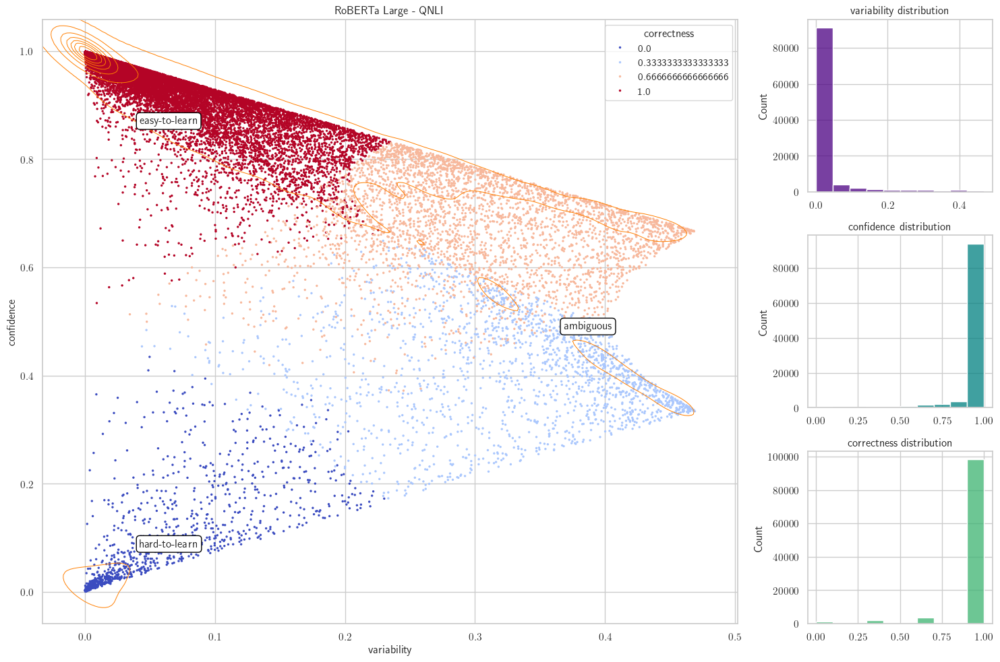

In [70]:
fig = plot_datamap(
    var3q,
    conf3q,
    corr3q,
    var1_name = 'variability',
    var2_name = 'confidence',
    var3_name = 'correctness',
    graph_title = 'RoBERTa Large - QNLI'
)
fig.savefig('images/roberta_large_qnli', dpi=300)

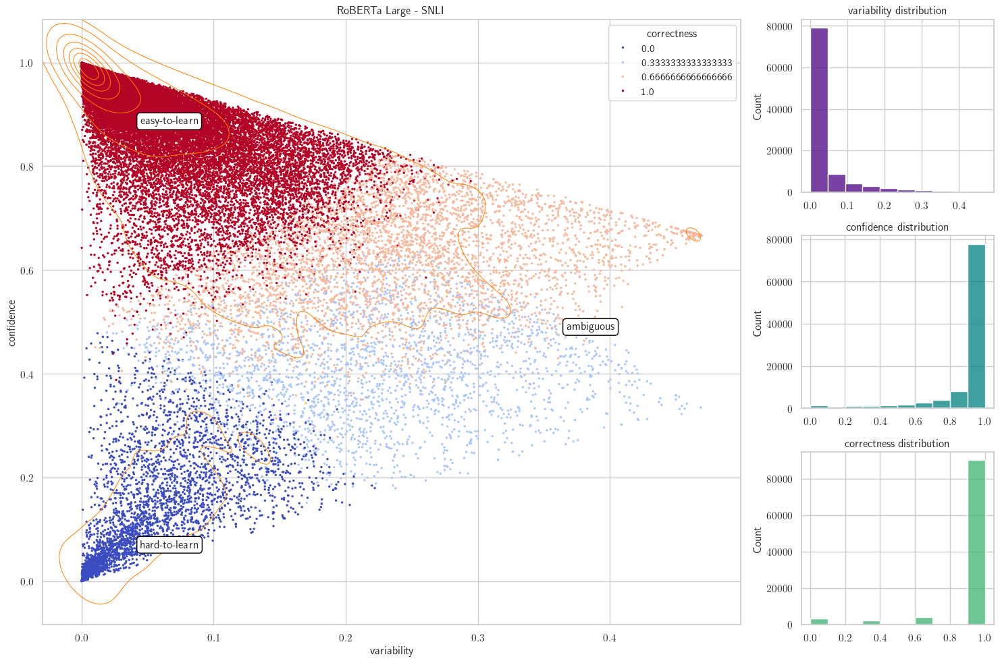

In [71]:
fig = plot_datamap(
    var3s,
    conf3s,
    corr3s,
    var1_name = 'variability',
    var2_name = 'confidence',
    var3_name = 'correctness',
    graph_title = 'RoBERTa Large - SNLI'
)
fig.savefig('images/roberta_large_snli', dpi=300)

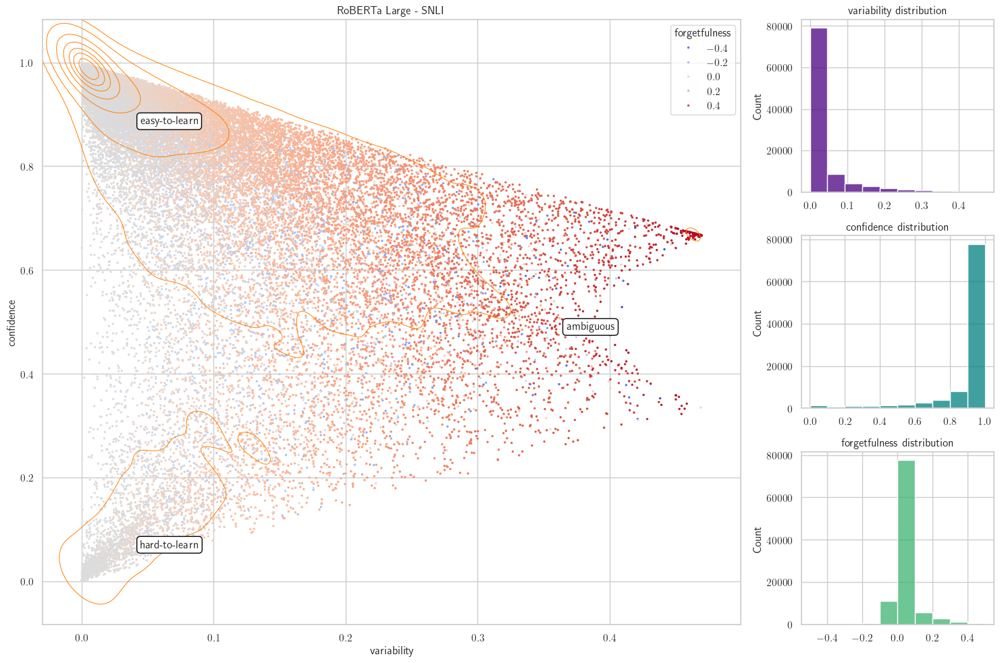

In [72]:
fig = plot_datamap(
    var3s,
    conf3s,
    forg3s,
    var1_name = 'variability',
    var2_name = 'confidence',
    var3_name = 'forgetfulness',
    graph_title = 'RoBERTa Large - SNLI'
)
fig.savefig('images/roberta_large_snli_forgetfulness', dpi=300)

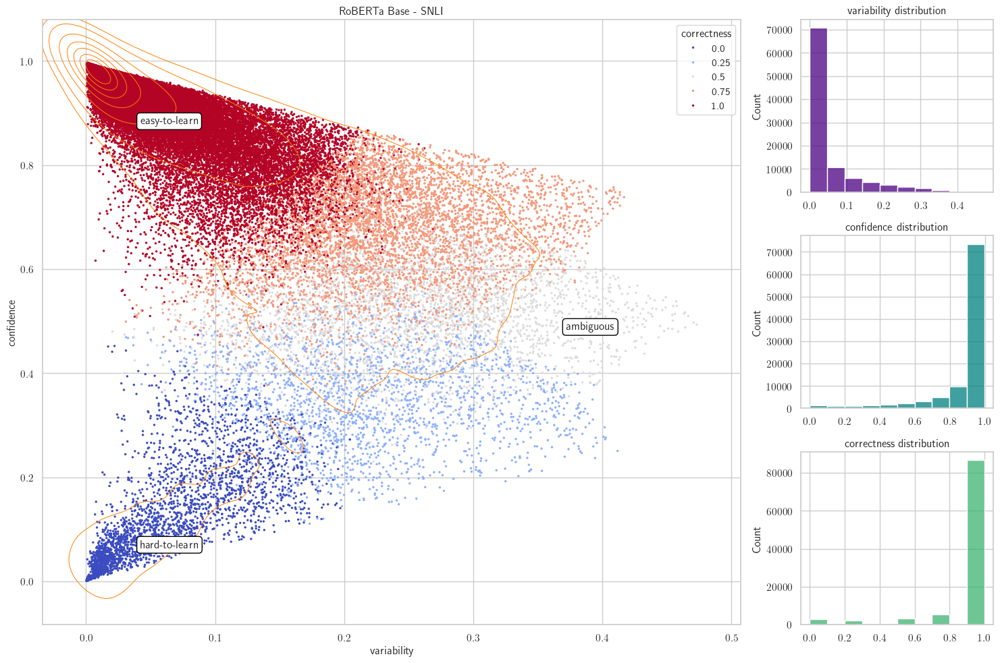

In [76]:
fig = plot_datamap(
    var2s,
    conf2s,
    corr2s,
    var1_name = 'variability',
    var2_name = 'confidence',
    var3_name = 'correctness',
    graph_title = 'RoBERTa Base - SNLI'
)
fig.savefig('images/roberta_base_snli', dpi=300)

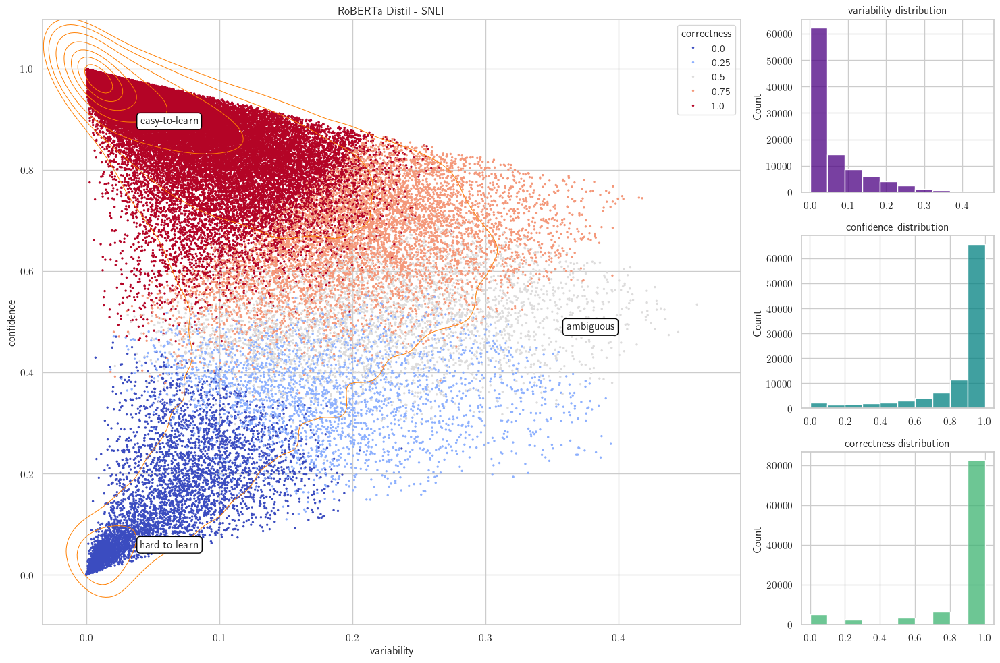

In [73]:
fig = plot_datamap(
    var1s,
    conf1s,
    corr1s,
    var1_name = 'variability',
    var2_name = 'confidence',
    var3_name = 'correctness',
    graph_title = 'RoBERTa Distil - SNLI'
)
fig.savefig('images/roberta_distil_snli', dpi=300)

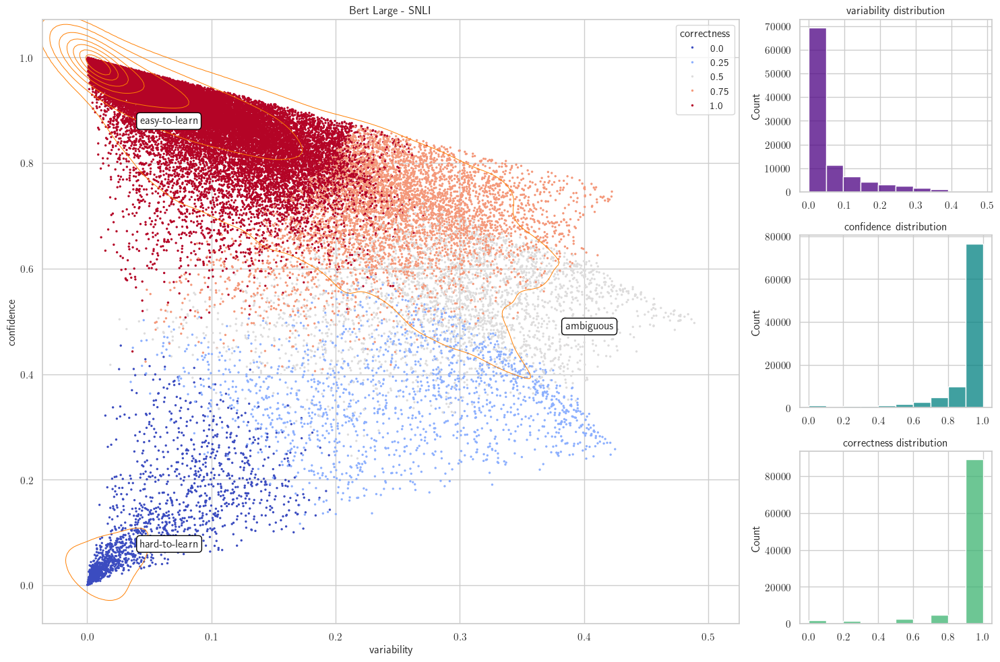

In [74]:
fig = plot_datamap(
    var6s,
    conf6s,
    corr6s,
    var1_name = 'variability',
    var2_name = 'confidence',
    var3_name = 'correctness',
    graph_title = 'Bert Large - SNLI'
)
fig.savefig('images/bert_large_snli', dpi=300)

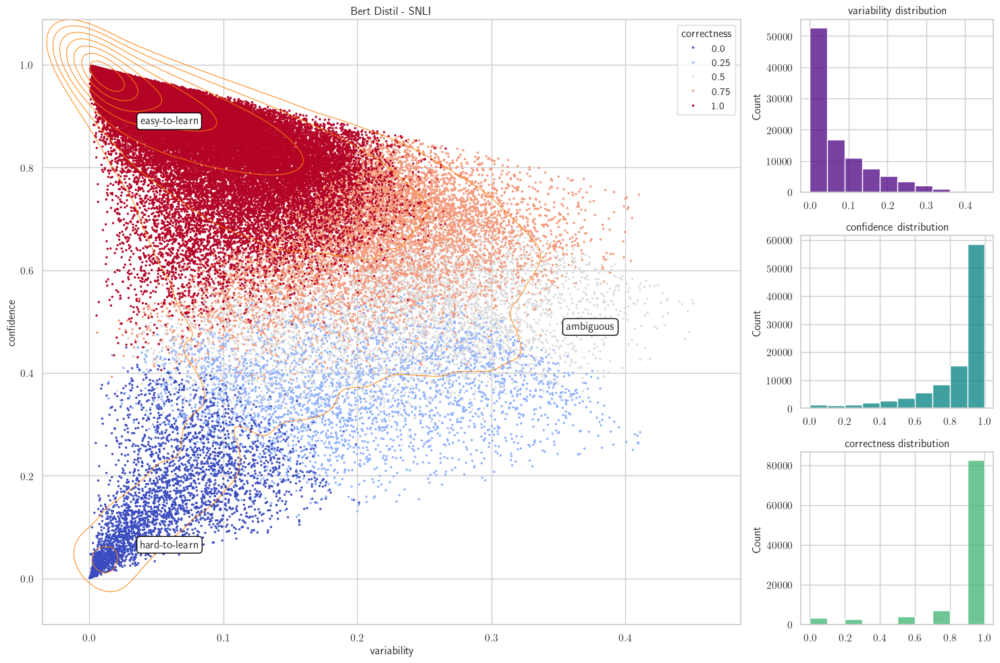

In [75]:
fig = plot_datamap(
    var4s,
    conf4s,
    corr4s,
    var1_name = 'variability',
    var2_name = 'confidence',
    var3_name = 'correctness',
    graph_title = 'Bert Distil - SNLI'
)
fig.savefig('images/bert_distil_snli', dpi=300)

## How many are shifted?

In [35]:
d2s = conf2s-conf3s
d1s = conf1s-conf3s

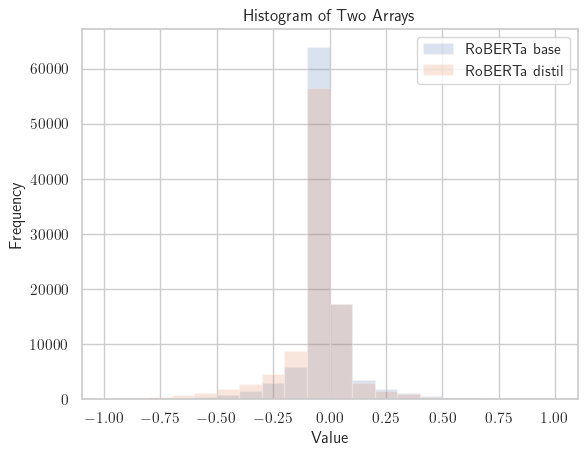

In [42]:
bins = np.linspace(-1, 1, 21)  # 20 bins between -1 and 1

plt.hist(d2s, bins=bins, alpha=0.2, label='RoBERTa base')
plt.hist(d1s, bins=bins, alpha=0.2, label='RoBERTa distil')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.title('Histogram of Two Arrays')
plt.legend()

# Reducing the number of y-axis ticks
# plt.yticks(np.linspace(plt.ylim()[0], plt.ylim()[1], 3))

plt.show()

In [18]:
threshold = 0.05
vast_difference_threshold = 0.5

# Compare elements
def compare_two_arr(arr1, arr2, threshold, vast_difference_threshold):
    about_same_count = 0
    slightly_larger_count = 0
    slightly_smaller_count = 0
    vastly_larger_count = 0
    vastly_smaller_count = 0

    for c3, c2 in zip(arr1, arr2):
        difference = np.abs(c3 - c2)

        if difference <= threshold:
            about_same_count += 1
        elif difference > vast_difference_threshold:
            if c2 > c3:
                vastly_larger_count += 1
            else:
                vastly_smaller_count += 1
        else:
            if c2 > c3:
                slightly_larger_count += 1
            else:
                slightly_smaller_count += 1

    return about_same_count, slightly_larger_count, slightly_smaller_count, vastly_larger_count, vastly_smaller_count


print('Conf: Roberta SNLI')
print(compare_two_arr(conf3s, conf2s, threshold, vast_difference_threshold))
print(compare_two_arr(conf3s, conf1s, threshold, vast_difference_threshold))
print('Conf: Roberta QNLI')
print(compare_two_arr(conf3q, conf2q, threshold, vast_difference_threshold))
print(compare_two_arr(conf3q, conf1q, threshold, vast_difference_threshold))
print('Var: Roberta SNLI')
print(compare_two_arr(var3s, var2s, threshold/2, vast_difference_threshold/2))
print(compare_two_arr(var3s, var1s, threshold/2, vast_difference_threshold/2))
print('Var: Roberta QNLI')
print(compare_two_arr(var3q, var2q, threshold/2, vast_difference_threshold/2))
print(compare_two_arr(var3q, var1q, threshold/2, vast_difference_threshold/2))


print('Conf: BERT SNLI')
print(compare_two_arr(conf6s, conf5s, threshold, vast_difference_threshold))
print(compare_two_arr(conf6s, conf4s, threshold, vast_difference_threshold))
print('Conf: BERT QNLI')
print(compare_two_arr(conf6q, conf5q, threshold, vast_difference_threshold))
print(compare_two_arr(conf6q, conf4q, threshold, vast_difference_threshold))
print('Var: BERT SNLI')
print(compare_two_arr(var6s, var5s, threshold/2, vast_difference_threshold/2))
print(compare_two_arr(var6s, var4s, threshold/2, vast_difference_threshold/2))
print('Var: BERT QNLI')
print(compare_two_arr(var6q, var5q, threshold/2, vast_difference_threshold/2))
print(compare_two_arr(var6q, var4q, threshold/2, vast_difference_threshold/2))

Conf: Roberta SNLI
(70822, 10478, 17700, 388, 612)
(61296, 8976, 26801, 370, 2557)
Conf: Roberta QNLI
(85498, 7005, 10826, 589, 825)
(71708, 5325, 25645, 428, 1637)
Var: Roberta SNLI
(66990, 21612, 9546, 1340, 512)
(56575, 30534, 10562, 1567, 762)
Var: Roberta QNLI
(78942, 14623, 7395, 2679, 1104)
(64976, 29533, 7173, 1731, 1330)
Conf: BERT SNLI
(66467, 10532, 22358, 223, 420)
(56366, 6395, 35499, 118, 1622)
Conf: BERT QNLI
(79237, 12476, 12345, 431, 254)
(59554, 5465, 38424, 164, 1136)
Var: BERT SNLI
(59406, 26008, 12894, 1256, 436)
(53190, 31825, 13017, 1119, 849)
Var: BERT QNLI
(68138, 20887, 13182, 1775, 761)
(43465, 50032, 8446, 1951, 849)


## Roberta Large Hard To Learn

In [10]:
snli_train_unshuffled, snli_train, snli_val, snli_test = get_datasets('snli')
qnli_train_unshuffled, qnli_train, qnli_val, qnli_test = get_datasets('glue/qnli')

Fetching dataset: snli


Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating test examples...:   0%|          | 0/10000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/snli/1.1.0.incomplete8D3UD3/snli-test.tfrecord*...:   0%|          | 0/100…

Generating validation examples...:   0%|          | 0/10000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/snli/1.1.0.incomplete8D3UD3/snli-validation.tfrecord*...:   0%|          |…

Generating train examples...:   0%|          | 0/550152 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/snli/1.1.0.incomplete8D3UD3/snli-train.tfrecord*...:   0%|          | 0/55…

Dataset snli downloaded and prepared to /root/tensorflow_datasets/snli/1.1.0. Subsequent calls will reuse this data.
type of train_unshuffled is: <class 'tensorflow.python.data.ops.prefetch_op._PrefetchDataset'>
type of test is: <class 'tensorflow.python.data.ops.prefetch_op._PrefetchDataset'>
type of train_unshuffled is: <class 'tensorflow.python.data.ops.filter_op._FilterDataset'>
type of test is: <class 'tensorflow.python.data.ops.filter_op._FilterDataset'>
type of train_unshuffled is: <class 'tensorflow.python.data.ops.map_op._ParallelMapDataset'>
type of test is: <class 'tensorflow.python.data.ops.map_op._ParallelMapDataset'>
Fetching dataset: glue/qnli


Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/104743 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/glue/qnli/2.0.0.incompleteY1VGBH/glue-train.tfrecord*...:   0%|          |…

Generating validation examples...:   0%|          | 0/5463 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/glue/qnli/2.0.0.incompleteY1VGBH/glue-validation.tfrecord*...:   0%|      …

Generating test examples...:   0%|          | 0/5463 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/glue/qnli/2.0.0.incompleteY1VGBH/glue-test.tfrecord*...:   0%|          | …

Dataset glue downloaded and prepared to /root/tensorflow_datasets/glue/qnli/2.0.0. Subsequent calls will reuse this data.


In [112]:
roberta_large_snli_e2l = get_data_subset(idxs3s, var3s, conf3s, corr3s, forg3s, p_easytolearn=0.001)
roberta_large_snli_amb = get_data_subset(idxs3s, var3s, conf3s, corr3s, forg3s, p_ambiguous=0.001)
roberta_large_snli_h2l = get_data_subset(idxs3s, var3s, conf3s, corr3s, forg3s, p_hardtolearn=0.001)

roberta_large_qnli_e2l = get_data_subset(idxs3q, var3q, conf3q, corr3q, forg3q, p_easytolearn=0.001)
roberta_large_qnli_amb = get_data_subset(idxs3q, var3q, conf3q, corr3q, forg3q, p_ambiguous=0.001)
roberta_large_qnli_h2l = get_data_subset(idxs3q, var3q, conf3q, corr3q, forg3q, p_hardtolearn=0.001)

Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.


In [12]:
roberta_distil_snli_e2l = get_data_subset(idxs1s, var1s, conf1s, corr1s, forg1s, p_easytolearn=0.001)
roberta_distil_snli_amb = get_data_subset(idxs1s, var1s, conf1s, corr1s, forg1s, p_ambiguous=0.001)
roberta_distil_snli_h2l = get_data_subset(idxs1s, var1s, conf1s, corr1s, forg1s, p_hardtolearn=0.001)

roberta_distil_qnli_e2l = get_data_subset(idxs1q, var1q, conf1q, corr1q, forg1q, p_easytolearn=0.001)
roberta_distil_qnli_amb = get_data_subset(idxs1q, var1q, conf1q, corr1q, forg1q, p_ambiguous=0.001)
roberta_distil_qnli_h2l = get_data_subset(idxs1q, var1q, conf1q, corr1q, forg1q, p_hardtolearn=0.001)

Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.


In [97]:
bert_large_snli_h2l = get_data_subset(idxs6s, var6s, conf6s, corr6s, forg6s, p_hardtolearn=0.001)

Fetching indices of specified training dynamics subset.


In [61]:
snli_easytolearn_samples = get_samples_by_index(snli_train_unshuffled, roberta_large_snli_e2l)
snli_ambiguous_samples = get_samples_by_index(snli_train_unshuffled, roberta_large_snli_amb)
snli_hardtolearn_samples = get_samples_by_index(snli_train_unshuffled, roberta_large_snli_h2l)

qnli_easytolearn_samples = get_samples_by_index(qnli_train_unshuffled, roberta_large_qnli_e2l)
qnli_ambiguous_samples = get_samples_by_index(qnli_train_unshuffled, roberta_large_qnli_amb)
qnli_hardtolearn_samples = get_samples_by_index(qnli_train_unshuffled, roberta_large_qnli_h2l)

In [13]:
robertadistil_snli_easytolearn_samples = get_samples_by_index(snli_train_unshuffled, roberta_distil_snli_e2l)
robertadistil_snli_ambiguous_samples = get_samples_by_index(snli_train_unshuffled, roberta_distil_snli_amb)
robertadistil_snli_hardtolearn_samples = get_samples_by_index(snli_train_unshuffled, roberta_distil_snli_h2l)

robertadistil_qnli_easytolearn_samples = get_samples_by_index(qnli_train_unshuffled, roberta_distil_qnli_e2l)
robertadistil_qnli_ambiguous_samples = get_samples_by_index(qnli_train_unshuffled, roberta_distil_qnli_amb)
robertadistil_qnli_hardtolearn_samples = get_samples_by_index(qnli_train_unshuffled, roberta_distil_qnli_h2l)

In [98]:
snli_hardtolearn_samples_bert = get_samples_by_index(snli_train_unshuffled, bert_large_snli_h2l)

In [14]:
convert_to_csv(robertadistil_snli_hardtolearn_samples, 'samples/robertadistil_snli_hardtolearn_samples.csv', dataset='snli')
convert_to_csv(robertadistil_qnli_hardtolearn_samples, 'samples/robertadistil_qnli_hardtolearn_samples.csv', dataset='glue/qnli')

In [114]:
convert_to_csv(snli_hardtolearn_samples, 'samples/snli_hardtolearn_samples.csv', dataset='snli')
convert_to_csv(qnli_hardtolearn_samples, 'samples/qnli_hardtolearn_samples.csv', dataset='glue/qnli')

convert_to_csv(snli_ambiguous_samples, 'samples/snli_ambiguous_samples.csv', dataset='snli')
convert_to_csv(qnli_ambiguous_samples, 'samples/qnli_ambiguous_samples.csv', dataset='glue/qnli')

convert_to_csv(snli_easytolearn_samples, 'samples/snli_easytolearn_samples.csv', dataset='snli')
convert_to_csv(qnli_easytolearn_samples, 'samples/qnli_easytolearn_samples.csv', dataset='glue/qnli')

In [99]:
convert_to_csv(snli_hardtolearn_samples_bert, 'samples/snli_bert_hardtolearn_samples.csv', dataset='snli')

## SNLI RoBERTa. Which is Easy for Whom?

In [109]:
roberta_large_snli_e2l = get_data_subset(idxs3s, var3s, conf3s, corr3s, forg3s, p_easytolearn=0.01)
roberta_large_snli_amb = get_data_subset(idxs3s, var3s, conf3s, corr3s, forg3s, p_ambiguous=0.01)
roberta_large_snli_h2l = get_data_subset(idxs3s, var3s, conf3s, corr3s, forg3s, p_hardtolearn=0.01)

roberta_large_qnli_e2l = get_data_subset(idxs3q, var3q, conf3q, corr3q, forg3q, p_easytolearn=0.01)
roberta_large_qnli_amb = get_data_subset(idxs3q, var3q, conf3q, corr3q, forg3q, p_ambiguous=0.01)
roberta_large_qnli_h2l = get_data_subset(idxs3q, var3q, conf3q, corr3q, forg3q, p_hardtolearn=0.01)

Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.


In [90]:
rl_hard_dr_easy_idxes = np.argsort(conf1s[roberta_large_snli_h2l])[-10:]

In [88]:
snli_rl_hard_dr_easy = get_samples_by_index(snli_train_unshuffled, rl_hard_dr_easy_idxes)

In [89]:
convert_to_csv(snli_rl_hard_dr_easy, 'samples/snli_rl_hard_dr_easy.csv', dataset='snli')

# DataMap Shifting

In [ ]:
# Fetch training dynamics
# ========
# QNLI
# ========
qglps1, qconf1, qvar1, qcorr1, qforg1, qidxs1, qtddict1 = load_training_dynamics_from_json('training_dynamics/glue/qnli/distilroberta-base.json')
qglps2, qconf2, qvar2, qcorr2, qforg2, qidxs2, qtddict2 = load_training_dynamics_from_json('training_dynamics/glue/qnli/roberta-base.json')
qglps3, qconf3, qvar3, qcorr3, qforg3, qidxs3, qtddict3 = load_training_dynamics_from_json('training_dynamics/glue/qnli/roberta-large.json')

glps4, qconf4, qvar4, qcorr4, qforg4, qidxs4, qtddict4 = load_training_dynamics_from_json('training_dynamics/glue/qnli/distilbert-base-cased.json')
qglps5, qconf5, qvar5, qcorr5, qforg5, qidxs5, qtddict5 = load_training_dynamics_from_json('training_dynamics/glue/qnli/bert-base-cased.json')
qglps6, qconf6, qvar6, qcorr6, qforg6, qidxs6, qtddict6 = load_training_dynamics_from_json('training_dynamics/glue/qnli/bert-large-cased.json')

# ========
# SNLI
# ========
sglps1, sconf1, svar1, scorr1, sforg1, sidxs1, stddict1 = load_training_dynamics_from_json('training_dynamics/snli/100k/distilroberta-base.json')
sglps2, sconf2, svar2, scorr2, sforg2, sidxs2, stddict2 = load_training_dynamics_from_json('training_dynamics/snli/100k/roberta-base.json')
sglps3, sconf3, svar3, scorr3, sforg3, sidxs3, stddict3 = load_training_dynamics_from_json('training_dynamics/snli/100k/roberta-large.json')

sglps4, sconf4, svar4, scorr4, sforg4, sidxs4, stddict4 = load_training_dynamics_from_json('training_dynamics/snli/100k/distilbert-base-cased.json')
sglps5, sconf5, svar5, scorr5, sforg5, sidxs5, stddict5 = load_training_dynamics_from_json('training_dynamics/snli/100k/bert-base-cased.json')
sglps6, sconf6, svar6, scorr6, sforg6, sidxs6, stddict6 = load_training_dynamics_from_json('training_dynamics/snli/100k/bert-large-cased.json')

Fetching training dynamics from saved json file: training_dynamics/glue/qnli/distilroberta-base.json: 100%|██████████| 104743/104743 [00:00<00:00, 408930.62it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/roberta-base.json: 100%|██████████| 104743/104743 [00:00<00:00, 318684.64it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/roberta-large.json: 100%|██████████| 104743/104743 [00:00<00:00, 481217.32it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/distilbert-base-cased.json: 100%|██████████| 104743/104743 [00:00<00:00, 246897.50it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/bert-base-cased.json: 100%|██████████| 104743/104743 [00:00<00:00, 483273.88it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/bert-large-cased.json: 100%|██████████| 104743/104743 [00:00<00:00, 910076.55it/s]
Fetching training dynamics from saved jso

## SNLI

In [ ]:
glps1, conf1, var1, corr1, forg1, idxs1, td_dict = load_training_dynamics_from_json('training_dynamics/snli/100k/roberta-large.json')
glps2, conf2, var2, corr2, forg2, idxs2, td_dict = load_training_dynamics_from_json('training_dynamics/snli/100k/roberta-base.json')
glps3, conf3, var3, corr3, forg3, idxs3, td_dict = load_training_dynamics_from_json('training_dynamics/snli/100k/distilroberta-base.json')

Fetching training dynamics from saved json file: training_dynamics/snli/100k/roberta-large.json: 100%|██████████| 100000/100000 [00:00<00:00, 574695.24it/s]
Fetching training dynamics from saved json file: training_dynamics/snli/100k/roberta-base.json: 100%|██████████| 100000/100000 [00:00<00:00, 1130232.47it/s]
Fetching training dynamics from saved json file: training_dynamics/snli/100k/distilroberta-base.json: 100%|██████████| 100000/100000 [00:00<00:00, 1148551.68it/s]


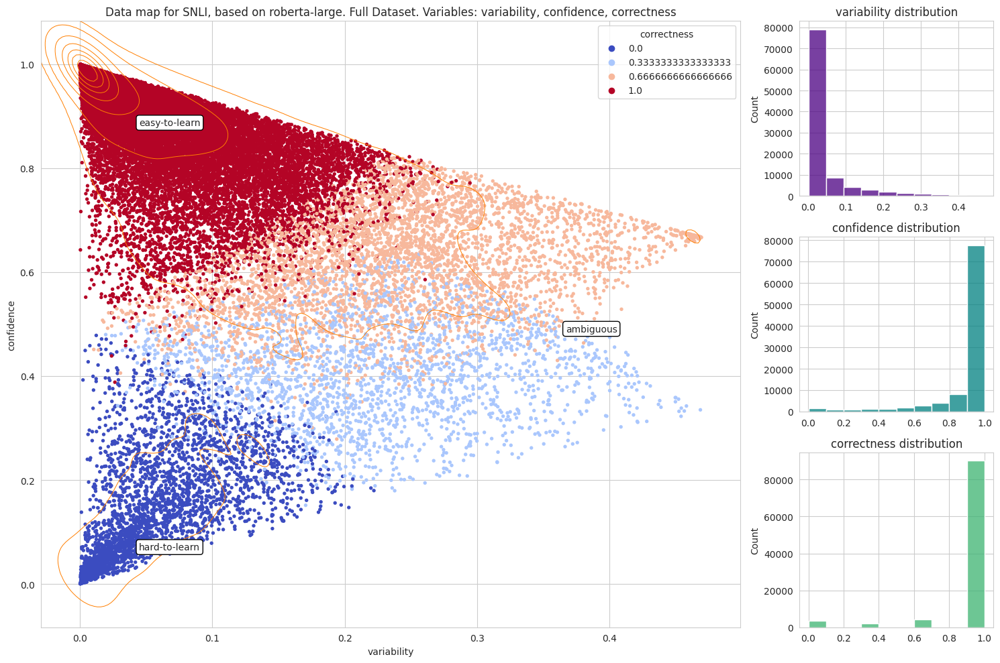

In [ ]:
datamap = plot_datamap(
    var1,
    conf1,
    corr1,
    var1_name='variability',
    var2_name='confidence',
    var3_name='correctness',
    dataset_name='snli',
    model_name='roberta-large',
    subdir='',
    tag='Full Dataset'
)

datamap.show()

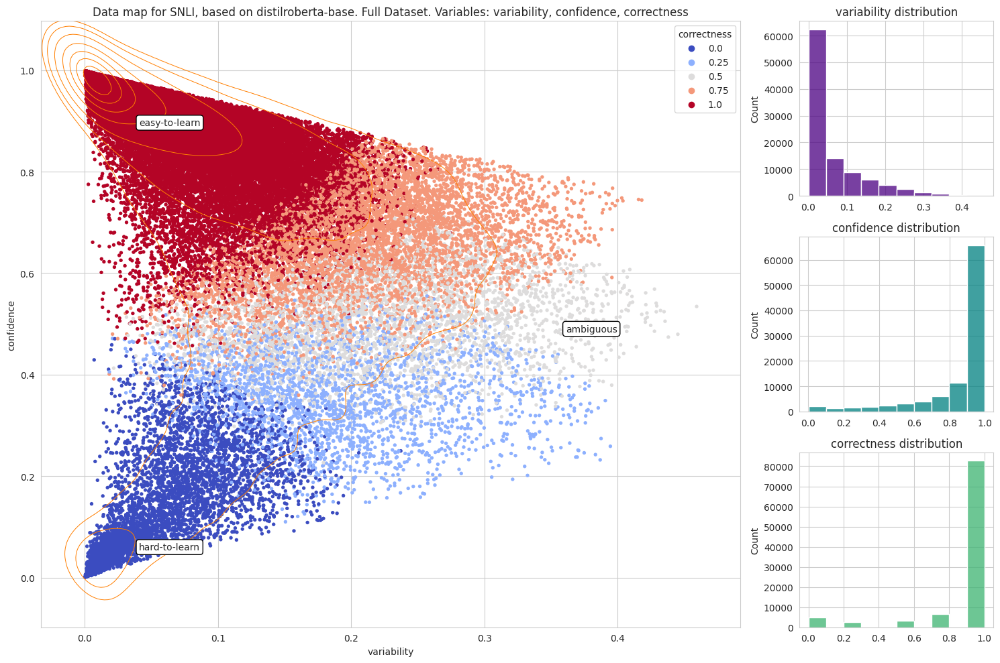

In [ ]:
datamap2 = plot_datamap(
    var3,
    conf3,
    corr3,
    var1_name='variability',
    var2_name='confidence',
    var3_name='correctness',
    dataset_name='snli',
    model_name='distilroberta-base',
    subdir='',
    tag='Full Dataset'
)

datamap2.show()

Generating frames for datamap animation.:  98%|█████████▊| 39/40 [1:02:46<01:27, 87.14s/it]

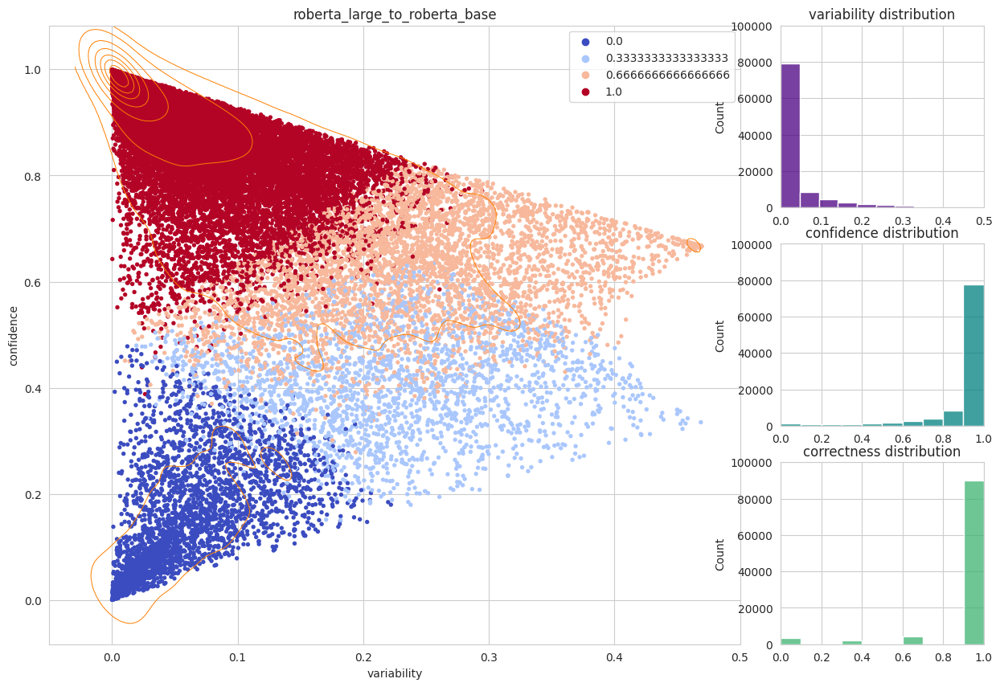

In [ ]:
random_indices = np.random.choice(len(var1), 100000, replace=False)
tag = 'SNLI_roberta_large_to_distilbase_fixed'
save_dir = 'images/snli/'

anim = animate_datamap(var1[random_indices], conf1[random_indices], corr1[random_indices],
                       var3[random_indices], conf3[random_indices], corr3[random_indices],
                    #    var3[random_indices], conf3[random_indices], corr3[random_indices],
                      n_frames=40, fixate=True)

anim.save(os.path.join(save_dir, f'{tag}.gif'), writer='imagemagick')


In [ ]:
%matplotlib inline
from IPython.display import HTML
HTML(anim.to_html5_video())

CalledProcessError: ignored

## QNLI

In [ ]:
glps1, conf1, var1, corr1, forg1, idxs1, td_dict = load_training_dynamics_from_json('training_dynamics/glue/qnli/roberta-large.json')
glps2, conf2, var2, corr2, forg2, idxs2, td_dict = load_training_dynamics_from_json('training_dynamics/glue/qnli/roberta-base.json')
glps3, conf3, var3, corr3, forg3, idxs3, td_dict = load_training_dynamics_from_json('training_dynamics/glue/qnli/distilroberta-base.json')

Fetching training dynamics from saved json file: training_dynamics/glue/qnli/roberta-large.json: 100%|██████████| 104743/104743 [00:00<00:00, 288938.83it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/roberta-base.json: 100%|██████████| 104743/104743 [00:00<00:00, 330918.42it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/distilroberta-base.json: 100%|██████████| 104743/104743 [00:00<00:00, 274342.93it/s]


In [ ]:
len(conf1)

104743

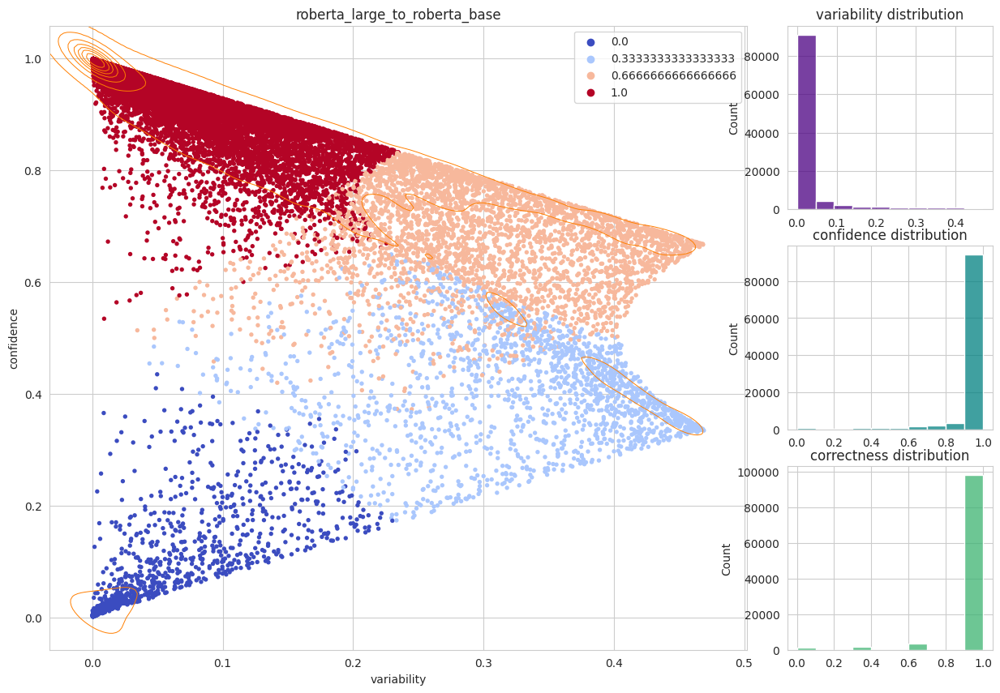

In [ ]:
random_indices = np.random.choice(len(var1), 104743, replace=False)
tag = 'QNLI_roberta_large_to_distilroberta_base'
save_dir = 'images/glue/qnli/'

anim = animate_datamap(var1[random_indices], conf1[random_indices], corr1[random_indices],
                       var2[random_indices], conf2[random_indices], corr2[random_indices],
                    #    var3[random_indices], conf3[random_indices], corr3[random_indices],
                      n_frames=30)

anim.save(os.path.join(save_dir, f'{tag}.gif'), writer='imagemagick')


## KDE Density Plots

In [ ]:
glps1, conf1, var1, corr1, forg1, idxs1, td_dict = load_training_dynamics_from_json('training_dynamics/glue/qnli/distilroberta-base.json')
glps2, conf2, var2, corr2, forg2, idxs2, td_dict = load_training_dynamics_from_json('training_dynamics/glue/qnli/roberta-base.json')
glps3, conf3, var3, corr3, forg3, idxs3, td_dict = load_training_dynamics_from_json('training_dynamics/glue/qnli/roberta-large.json')

glps4, conf4, var4, corr4, forg4, idxs4, td_dict = load_training_dynamics_from_json('training_dynamics/glue/qnli/distilbert-base-cased.json')
glps5, conf5, var5, corr5, forg5, idxs5, td_dict = load_training_dynamics_from_json('training_dynamics/glue/qnli/bert-base-cased.json')
glps6, conf6, var6, corr6, forg6, idxs6, td_dict = load_training_dynamics_from_json('training_dynamics/glue/qnli/bert-large-cased.json')

Fetching training dynamics from saved json file: training_dynamics/glue/qnli/distilroberta-base.json: 100%|██████████| 104743/104743 [00:00<00:00, 459174.56it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/roberta-base.json: 100%|██████████| 104743/104743 [00:00<00:00, 350941.20it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/roberta-large.json: 100%|██████████| 104743/104743 [00:00<00:00, 359496.96it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/distilbert-base-cased.json: 100%|██████████| 104743/104743 [00:00<00:00, 480927.59it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/bert-base-cased.json: 100%|██████████| 104743/104743 [00:00<00:00, 227602.71it/s]
Fetching training dynamics from saved json file: training_dynamics/glue/qnli/bert-large-cased.json: 100%|██████████| 104743/104743 [00:00<00:00, 245211.29it/s]


/usr/local/lib/python3.10/dist-packages/seaborn/distributions.py:1185: UserWarning: The following kwargs were not used by contour: 'linestyle'
  cset = contour_func(
/usr/local/lib/python3.10/dist-packages/seaborn/distributions.py:1185: UserWarning: The following kwargs were not used by contour: 'linestyle'
  cset = contour_func(
/usr/local/lib/python3.10/dist-packages/seaborn/distributions.py:1185: UserWarning: The following kwargs were not used by contour: 'linestyle'
  cset = contour_func(
/usr/local/lib/python3.10/dist-packages/seaborn/distributions.py:1185: UserWarning: The following kwargs were not used by contour: 'linestyle'
  cset = contour_func(
/usr/local/lib/python3.10/dist-packages/seaborn/distributions.py:1185: UserWarning: The following kwargs were not used by contour: 'linestyle'
  cset = contour_func(
/usr/local/lib/python3.10/dist-packages/seaborn/distributions.py:1185: UserWarning: The following kwargs were not used by contour: 'linestyle'
  cset = contour_func(


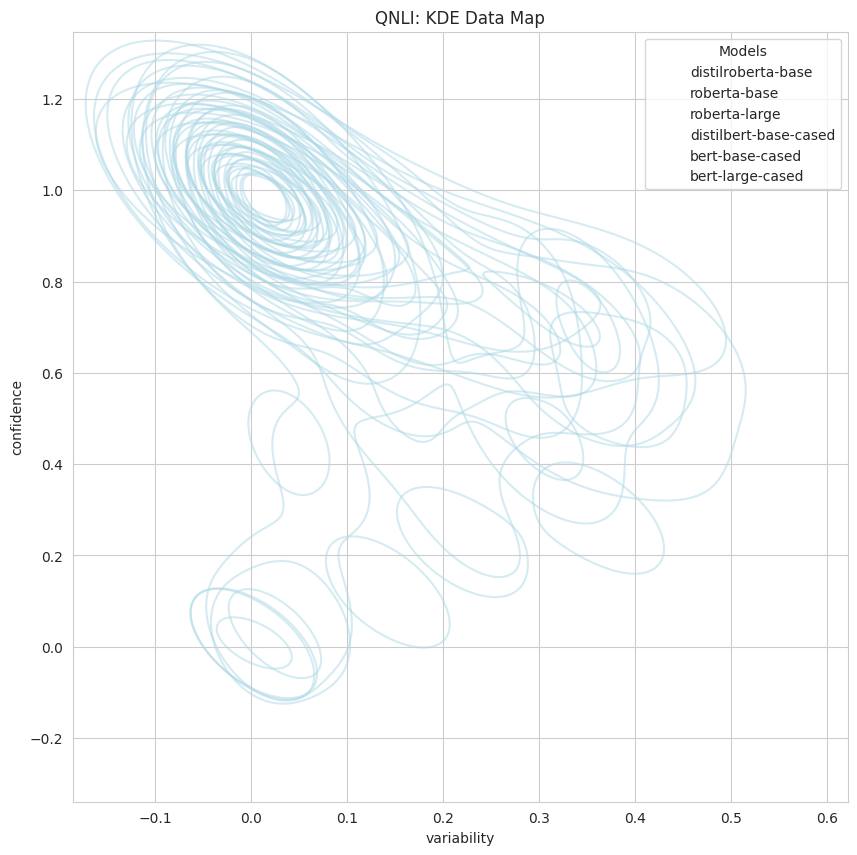

In [ ]:

# def plot_kde_datamap(
#         data_sets,  # List of tuples, where each tuple contains two lists (var1, var2)
#         var_names=('variability', 'confidence'),  # Names for the two variables
#         model_names=[],  # List of strings for legend labels
#         dataset_name='glue/qnli',
#         title_name='KDE Data Map',  # Title of the plot
#         graph_save_name='kde_datamap_plot',  # Name of the graph file when saved
#         subdir='',
#         tag='All Samples',
#     ):


data_sets = [
    (var1, conf1),
    (var2, conf2),
    (var3, conf3),
    (var4, conf4),
    (var5, conf5),
    (var6, conf6),
]

data_sets = [
    (var1[:50], conf1[:50]),
    (var2[:50], conf2[:50]),
    (var3[:50], conf3[:50]),
    (var4[:50], conf4[:50]),
    (var5[:50], conf5[:50]),
    (var6[:50], conf6[:50]),
]

model_names = [
    'distilroberta-base',
    'roberta-base',
    'roberta-large',

    'distilbert-base-cased',
    'bert-base-cased',
    'bert-large-cased',
]

fig = plot_kde_datamap(
    data_sets,
    var_names=('variability', 'confidence'),
    model_names=model_names,  # List of strings for legend labels
    dataset_name='glue/qnli',
    title_name='QNLI: KDE Data Map',  # Title of the plot
    graph_save_name='qnli_kde_datamap_plot',  # Name of the graph file when saved
    subdir='',
)

## Mean shift and KL Divergence

In [ ]:
import numpy as np
from scipy.stats import entropy

def normalize(array):
    return array / np.sum(array)

def kl_divergence(array1, array2):
    norm_array1 = normalize(array1)
    norm_array2 = normalize(array2)
    return entropy(norm_array1, norm_array2)




In [ ]:
kl_div = kl_divergence(qconf3, qconf1)
print("KL Divergence:", kl_div)

KL Divergence: 0.02019699304658108


In [ ]:
len(qconf3)

104743

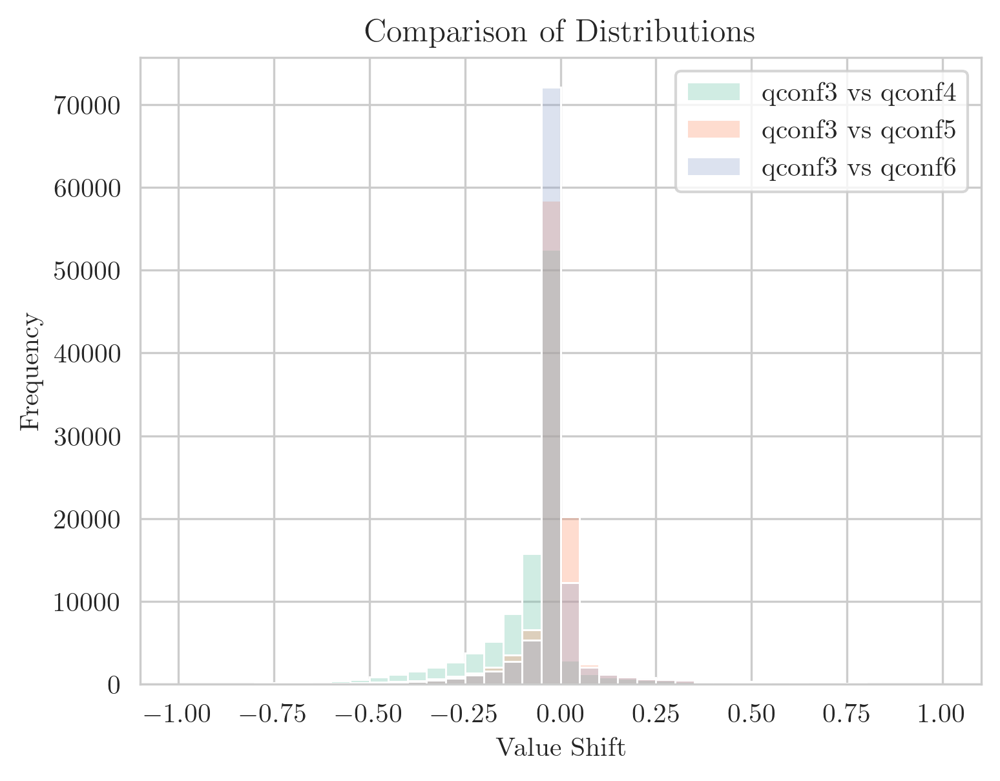

In [ ]:
from matplotlib.ticker import FuncFormatter

kde_only = False
reference_distribution = qconf3

comparison_distributions = [
    # qconf3,
    # qconf2,
    # qconf1,
    qconf4,
    qconf5,
    qconf6
]
labels = [
    # 'qconf3 vs qconf3',
    # 'qconf3 vs qconf2',
    # 'qconf3 vs qconf1',
    'qconf3 vs qconf4',
    'qconf3 vs qconf5',
    'qconf3 vs qconf6'
]

bin_width = 0.05  # Choose a suitable bin width, e.g., 0.05
bins = np.arange(-1.00, 1.00 + bin_width, bin_width)

plt.figure(figsize=(5.6,4.2), dpi=300)

for comparison_distribution, label in zip(comparison_distributions, labels):
    shift = comparison_distribution - reference_distribution
    if kde_only:
        sns.kdeplot(shift, label=label, fill=True, alpha=0.3)
    else:
        sns.histplot(shift, bins=bins, kde=False, label=label, alpha=0.3)

plt.title('Comparison of Distributions')
plt.xlabel('Value Shift')
y_label = 'Density' if kde_only else 'Frequency'
plt.ylabel(y_label)
# plt.yscale('log')

def normal_format(x, pos):
    return f'{int(x)}'

# Apply the formatter to the y-axis
plt.gca().yaxis.set_major_formatter(FuncFormatter(normal_format))

plt.legend()
plt.show()

In [ ]:
reference_distribution = qconf3
for comparison_distribution in [qconf3, qconf2, qconf1]:


0.9088611784880396

In [ ]:
import pandas as pd
import numpy as np

# Example lists as NumPy arrays
list1 = np.array([0.1, 0.2, 0.1, 0.8, 0.9])
list2 = np.array([0.1, 0.25, 0.1, 0.75, 0.9])
# Add more lists as needed

# Function to calculate mean and standard deviation of shifts
def calculate_shift_stats(list_a, list_b):
    shifts = list_b - list_a
    mean_shift = (np.round(np.mean(shifts), 4))
    std_dev_shift = (np.round(np.std(shifts), 4))
    return mean_shift, std_dev_shift

# List of all your lists as NumPy arrays
all_lists = {
    'roberta large': qconf3,
    'roberta base': qconf2,
    'distil roberta': qconf1,
    'bert large': qconf6,
    'bert base': qconf5,
    'distil bert': qconf4,
    # Add more lists as needed
}

# all_lists = {
#     'qnli_var_roberta_large': qvar3,
#     'qnli_var_roberta_base': qvar2,
#     'qnli_var_distilroberta': qvar1,
#     'qnli_var_bert_large': qvar6,
#     'qnli_var_bert_base': qvar5,
#     'qnli_var_distilbert': qvar4,
#     # Add more lists as needed
# }

# all_lists = {
#     'qnli_corr_roberta_large': qcorr3,
#     'qnli_corr_roberta_base': qcorr2,
#     'qnli_corr_distilroberta': qcorr1,
#     'qnli_corr_bert_large': qcorr6,
#     'qnli_corr_bert_base': qcorr5,
#     'qnli_cor_distilbert': qcorr4,
#     # Add more lists as needed
# }

# Creating an empty DataFrame
df = pd.DataFrame(columns=all_lists.keys(), index=all_lists.keys())

# Calculating pairwise statistics
# Calculating pairwise statistics
for list_name_a, values_a in all_lists.items():
    for list_name_b, values_b in all_lists.items():
        mean_shift, std_dev_shift = calculate_shift_stats(values_a, values_b)
        # Format the values as strings with two decimal places
        df.at[list_name_a, list_name_b] = (f"{mean_shift:.3f}", f"{std_dev_shift:.3f}")


df


,roberta large,roberta base,distil roberta,bert large,bert base,distil bert
roberta large,"(0.000, 0.000)","(-0.011, 0.115)","(-0.046, 0.137)","(-0.009, 0.103)","(-0.007, 0.127)","(-0.073, 0.151)"
roberta base,"(0.011, 0.115)","(0.000, 0.000)","(-0.035, 0.109)","(0.002, 0.101)","(0.003, 0.105)","(-0.062, 0.132)"
distil roberta,"(0.046, 0.137)","(0.035, 0.109)","(0.000, 0.000)","(0.037, 0.115)","(0.038, 0.119)","(-0.027, 0.117)"
bert large,"(0.009, 0.103)","(-0.002, 0.101)","(-0.037, 0.115)","(0.000, 0.000)","(0.002, 0.102)","(-0.064, 0.127)"
bert base,"(0.007, 0.127)","(-0.003, 0.105)","(-0.038, 0.119)","(-0.002, 0.102)","(0.000, 0.000)","(-0.065, 0.128)"
distil bert,"(0.073, 0.151)","(0.062, 0.132)","(0.027, 0.117)","(0.064, 0.127)","(0.065, 0.128)","(0.000, 0.000)"


# Fetching Relevant Run Results

In [ ]:
!ls models/snli/100k/bert-large-cased

1.data-00000-of-00001  2.index		      4.data-00000-of-00001
1.index		       3.data-00000-of-00001  4.index
2.data-00000-of-00001  3.index		      checkpoint


In [ ]:
import pandas as pd

qnli_model_to_best_epoch = {
    'distilroberta-base': 2,
    'roberta-base': 1,
    'roberta-large': 3,
    'distilbert-base-cased': 2,
    'bert-base-cased': 2,
    'bert-large-cased': 2,
}

qnli_test_sets = ['qnli', 'advsqu', 'adv_qnli', 'scitail']

# Initialize an empty DataFrame to concatenate the filtered results
filtered_results = pd.DataFrame()

for test_set in qnli_test_sets:
    csv = f'results/qnli_train_{test_set}_test.csv'
    df = pd.read_csv(csv)

    # Filter rows where 'MODEL_NAME' matches the keys and 'EPOCH_TO_LOAD' matches the corresponding values
    for model, epoch in qnli_model_to_best_epoch.items():
        filtered_df = df[(df['MODEL_NAME'] == model) & (df['EPOCH_TO_LOAD'] == epoch)]
        filtered_results = pd.concat([filtered_results, filtered_df])

# Reset the index of the concatenated DataFrame if needed
filtered_results.reset_index(drop=True, inplace=True)
# Assuming filtered_results is your DataFrame
filtered_results['f1'] = (filtered_results['f1'].round(3)) * 100
filtered_results['accuracy'] = (filtered_results['accuracy'].round(3)) * 100


# The variable filtered_results now contains all the concatenated rows that match your criteria


In [ ]:
qnli_results = filtered_results[['MODEL_NAME', 'DATASET_NAME', 'f1']]

In [ ]:
snli_model_to_best_epoch = {
    'distilroberta-base': 3,
    'roberta-base': 3,
    'roberta-large': 3,

    'distilbert-base-cased': 4,
    'bert-base-cased': 4,
    'bert-large-cased': 3,
}

snli_test_sets = ['snli', 'multi_nli', 'gluedia', 'adv_mnli']

# Initialize an empty DataFrame to concatenate the filtered results
filtered_results = pd.DataFrame()

for test_set in snli_test_sets:
    csv = f'results/snli_train_{test_set}_test.csv'
    df = pd.read_csv(csv)

    # Filter rows where 'MODEL_NAME' matches the keys and 'EPOCH_TO_LOAD' matches the corresponding values
    for model, epoch in snli_model_to_best_epoch.items():
        filtered_df = df[(df['MODEL_NAME'] == model) & (df['EPOCH_TO_LOAD'] == epoch)]
        filtered_results = pd.concat([filtered_results, filtered_df])

# Reset the index of the concatenated DataFrame if needed
filtered_results.reset_index(drop=True, inplace=True)
# Assuming filtered_results is your DataFrame
filtered_results['f1'] = (filtered_results['f1'].round(3)) * 100
filtered_results['accuracy'] = (filtered_results['accuracy'].round(3)) * 100


# The variable filtered_results now contains all the concatenated rows that match your criteria


In [ ]:
snli_results = filtered_results[['MODEL_NAME', 'DATASET_NAME', 'DATASET_SUBSET', 'f1']]
# snli_results = snli_results[snli_results['DATASET_SUBSET'].isna()]

In [ ]:
snli_results

,MODEL_NAME,DATASET_NAME,DATASET_SUBSET,f1
0,distilroberta-base,snli,NaN,86.6
1,roberta-base,snli,NaN,88.3
2,roberta-large,snli,NaN,91.0
3,distilbert-base-cased,snli,NaN,83.5
4,bert-base-cased,snli,NaN,85.6
...,...,...,...,...
67,bert-base-cased,adv_mnli,mismatched,26.3
68,bert-base-cased,adv_mnli,NaN,30.3
69,bert-large-cased,adv_mnli,matched,39.5
70,bert-large-cased,adv_mnli,mismatched,31.5


## Plotting change (confidence, variability, correctness, forgetfulness) vs performance on test sets

In [ ]:
# Define means for snli_results
means_snli = {
    'distilroberta-base': (np.mean(sconf1), np.mean(svar1), np.mean(scorr1), np.mean(sforg1)),
    'roberta-base': (np.mean(sconf2), np.mean(svar2), np.mean(scorr2), np.mean(sforg2)),
    'roberta-large': (np.mean(sconf3), np.mean(svar3), np.mean(scorr3), np.mean(sforg3)),
    'distilbert-base-cased': (np.mean(sconf4), np.mean(svar4), np.mean(scorr4), np.mean(sforg4)),
    'bert-base-cased': (np.mean(sconf5), np.mean(svar5), np.mean(scorr5), np.mean(sforg5)),
    'bert-large-cased': (np.mean(sconf6), np.mean(svar6), np.mean(scorr6), np.mean(sforg6))
}

std_devs_snli = {
    'distilroberta-base': (np.std(sconf1), np.std(svar1), np.std(scorr1), np.std(sforg1)),
    'roberta-base': (np.std(sconf2), np.std(svar2), np.std(scorr2), np.std(sforg2)),
    'roberta-large': (np.std(sconf3), np.std(svar3), np.std(scorr3), np.std(sforg3)),
    'distilbert-base-cased': (np.std(sconf4), np.std(svar4), np.std(scorr4), np.std(sforg4)),
    'bert-base-cased': (np.std(sconf5), np.std(svar5), np.std(scorr5), np.std(sforg5)),
    'bert-large-cased': (np.std(sconf6), np.std(svar6), np.std(scorr6), np.std(sforg6))
}



# Define means for qnli_results
means_qnli = {
    'distilroberta-base': (np.mean(qconf1), np.mean(qvar1), np.mean(qcorr1), np.mean(qforg1)),
    'roberta-base': (np.mean(qconf2), np.mean(qvar2), np.mean(qcorr2), np.mean(qforg2)),
    'roberta-large': (np.mean(qconf3), np.mean(qvar3), np.mean(qcorr3), np.mean(qforg3)),
    'distilbert-base-cased': (np.mean(qconf4), np.mean(qvar4), np.mean(qcorr4), np.mean(qforg4)),
    'bert-base-cased': (np.mean(qconf5), np.mean(qvar5), np.mean(qcorr5), np.mean(qforg5)),
    'bert-large-cased': (np.mean(qconf6), np.mean(qvar6), np.mean(qcorr6), np.mean(qforg6))
}

# Define means for qnli_results
std_devs_qnli = {
    'distilroberta-base': (np.std(qconf1), np.std(qvar1), np.std(qcorr1), np.std(qforg1)),
    'roberta-base': (np.std(qconf2), np.std(qvar2), np.std(qcorr2), np.std(qforg2)),
    'roberta-large': (np.std(qconf3), np.std(qvar3), np.std(qcorr3), np.std(qforg3)),
    'distilbert-base-cased': (np.std(qconf4), np.std(qvar4), np.std(qcorr4), np.std(qforg4)),
    'bert-base-cased': (np.std(qconf5), np.std(qvar5), np.std(qcorr5), np.std(qforg5)),
    'bert-large-cased': (np.std(qconf6), np.std(qvar6), np.std(qcorr6), np.std(qforg6))
}

# Update snli_results dataframe
for i, row in snli_results.iterrows():
    if row['MODEL_NAME'] in means_snli:
        snli_results.at[i, 'confidence'], snli_results.at[i, 'variability'], \
        snli_results.at[i, 'correctness'], snli_results.at[i, 'forgetfulness'] = means_snli[row['MODEL_NAME']]

for i, row in snli_results.iterrows():
    if row['MODEL_NAME'] in std_devs_snli:
        snli_results.at[i, 'std_dev_confidence'], snli_results.at[i, 'std_dev_variability'], \
        snli_results.at[i, 'std_dev_correctness'], snli_results.at[i, 'std_dev_forgetfulness'] = std_devs_snli[row['MODEL_NAME']]

# Update qnli_results dataframe
for i, row in qnli_results.iterrows():
    if row['MODEL_NAME'] in means_qnli:
        qnli_results.at[i, 'confidence'], qnli_results.at[i, 'variability'], \
        qnli_results.at[i, 'correctness'], qnli_results.at[i, 'forgetfulness'] = means_qnli[row['MODEL_NAME']]

for i, row in qnli_results.iterrows():
    if row['MODEL_NAME'] in std_devs_qnli:
        qnli_results.at[i, 'std_dev_confidence'], qnli_results.at[i, 'std_dev_variability'], \
        qnli_results.at[i, 'std_dev_correctness'], qnli_results.at[i, 'std_dev_forgetfulness'] = std_devs_qnli[row['MODEL_NAME']]


<ipython-input-16-584b5eefb7d7>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  snli_results.at[i, 'confidence'], snli_results.at[i, 'variability'], \
<ipython-input-16-584b5eefb7d7>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  snli_results.at[i, 'confidence'], snli_results.at[i, 'variability'], \
<ipython-input-16-584b5eefb7d7>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th

In [ ]:
snli_results

,MODEL_NAME,DATASET_NAME,DATASET_SUBSET,f1,confidence,variability,correctness,forgetfulness,std_dev_confidence,std_dev_variability,std_dev_correctness,std_dev_forgetfulness
0,distilroberta-base,snli,NaN,86.6,0.848919,0.059335,0.898005,0.036446,0.223731,0.074673,0.257909,0.062170
1,roberta-base,snli,NaN,88.3,0.883006,0.052793,0.928077,0.023929,0.189860,0.077148,0.212559,0.059574
2,roberta-large,snli,NaN,91.0,0.900735,0.037083,0.936803,0.029998,0.189876,0.066960,0.211871,0.075118
3,distilbert-base-cased,snli,NaN,83.5,0.840249,0.073761,0.905990,0.051649,0.205466,0.079915,0.237115,0.068932
4,bert-base-cased,snli,NaN,85.6,0.883606,0.071838,0.933245,0.046240,0.172027,0.090367,0.191262,0.069880
...,...,...,...,...,...,...,...,...,...,...,...,...
67,bert-base-cased,adv_mnli,mismatched,26.3,0.883606,0.071838,0.933245,0.046240,0.172027,0.090367,0.191262,0.069880
68,bert-base-cased,adv_mnli,NaN,30.3,0.883606,0.071838,0.933245,0.046240,0.172027,0.090367,0.191262,0.069880
69,bert-large-cased,adv_mnli,matched,39.5,0.906338,0.056076,0.944800,0.040734,0.166237,0.082193,0.182703,0.066513
70,bert-large-cased,adv_mnli,mismatched,31.5,0.906338,0.056076,0.944800,0.040734,0.166237,0.082193,0.182703,0.066513


In [ ]:
qnli_results

,MODEL_NAME,DATASET_NAME,f1,confidence,variability,correctness,forgetfulness,std_dev_confidence,std_dev_variability,std_dev_correctness,std_dev_forgetfulness
0,distilroberta-base,glue/qnli,89.9,0.908861,0.049858,0.943989,0.030832,0.161420,0.074533,0.180788,0.057937
1,roberta-base,glue/qnli,91.1,0.944267,0.040904,0.960026,0.020447,0.137617,0.084905,0.149655,0.061321
2,roberta-large,glue/qnli,94.6,0.954744,0.027908,0.966413,0.023860,0.135543,0.074962,0.145681,0.080723
3,distilbert-base-cased,glue/qnli,86.4,0.882036,0.077816,0.931948,0.051052,0.158603,0.080004,0.187641,0.066662
4,bert-base-cased,glue/qnli,90.8,0.947392,0.049897,0.968807,0.031063,0.107317,0.085617,0.116035,0.062284
5,bert-large-cased,glue/qnli,91.4,0.945746,0.038661,0.967740,0.036403,0.123272,0.077145,0.134864,0.083919
6,distilroberta-base,adversarial_squad,42.9,0.908861,0.049858,0.943989,0.030832,0.161420,0.074533,0.180788,0.057937
7,roberta-base,adversarial_squad,63.4,0.944267,0.040904,0.960026,0.020447,0.137617,0.084905,0.149655,0.061321
8,roberta-large,adversarial_squad,85.1,0.954744,0.027908,0.966413,0.023860,0.135543,0.074962,0.145681,0.080723
9,distilbert-base-cased,adversarial_squad,22.4,0.882036,0.077816,0.931948,0.051052,0.158603,0.080004,0.187641,0.066662


In [26]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

data_df = snli_results

# Assuming snli_results is your DataFrame
# Filtering the DataFrame for 'roberta' and 'bert' models
roberta_data = data_df[data_df['MODEL_NAME'].str.contains('roberta')]
bert_data = data_df[data_df['MODEL_NAME'].str.contains('bert') & ~data_df['MODEL_NAME'].str.contains('roberta')]

# Sort the data by 'MODEL_NAME'
roberta_data = roberta_data.sort_values('MODEL_NAME')
bert_data = bert_data.sort_values('MODEL_NAME')

# Define the metrics for the plots
metrics = ['confidence', 'variability', 'correctness', 'forgetfulness']

# Setting up the subplots
sns.set(style="darkgrid")
fig, axes = plt.subplots(1, 4, figsize=(12, 3.5))  # 1 row, 4 columns

# Get unique datasets and sort them
datasets = sorted(data_df['DATASET_NAME'].unique())
colors = sns.color_palette("tab10", len(datasets))

# Function to determine marker based on model name
def get_marker(model_name):
    if 'large' in model_name:
        return '^'  # Triangle marker
    elif 'distil' in model_name:
        return 's'  # Square marker
    else:
        return 'o'  # Default to circle

# Loop through each metric and create a subplot
for i, metric in enumerate(metrics):
    ax = axes[i]

    # Plotting 'roberta' models
    for j, dataset in enumerate(datasets):
        subset = roberta_data[roberta_data['DATASET_NAME'] == dataset]
        sns.lineplot(ax=ax, x=subset[metric], y=subset['f1'], color=colors[j], linestyle='-')
        for index, row in subset.iterrows():
            ax.scatter([row[metric]], [row['f1']], marker=get_marker(row['MODEL_NAME']), color=colors[j])

    # Plotting 'bert' models
    for j, dataset in enumerate(datasets):
        subset = bert_data[bert_data['DATASET_NAME'] == dataset]
        if not subset.empty:
            sns.lineplot(ax=ax, x=subset[metric], y=subset['f1'], color=colors[j], linestyle='--')
            for index, row in subset.iterrows():
                ax.scatter([row[metric]], [row['f1']], marker=get_marker(row['MODEL_NAME']), color=colors[j])

    # Setting titles and labels
    # ax.set_title(f"{metric.title()} vs F1 score")
    ax.set_xlabel(metric.title())
    if i == 0:
        ax.set_ylabel("F1 Score")
    else:
        ax.set_ylabel("")
        ax.set_yticklabels([])  # This removes the y-axis ticks

# Add a legend to the first plot only
# axes[0].legend(title='Model - Dataset', loc='upper right', bbox_to_anchor=(0.5, 1), borderaxespad=0.)

# Adjust layout to prevent overlap
plt.tight_layout()
axes[0].plot([], [], color='red', label='snli')          # Red line for 'snli'
axes[0].plot([], [], color='green', label='multi_nli')   # Green line for 'multi_nli'
axes[0].plot([], [], color='orange', label='diagnostics')# Orange line for 'diagnostics'
axes[0].plot([], [], color='blue', label='adv_mnli')     # Blue line for 'adv_mnli'
axes[0].plot([], [], color='black', label='roberta')     # Black line for 'roberta'
axes[0].plot([], [], color='black', linestyle='dashed', label='bert') # Black dashed line for 'bert'
axes[0].scatter([], [], marker='^', color='black', label='large')     # Triangle for 'large'
axes[0].scatter([], [], marker='o', color='black', label='base')      # Circle for 'base'
axes[0].scatter([], [], marker='s', color='black', label='distil')    # Square for 'distil'
axes[0].legend(loc='center left', bbox_to_anchor=(0.05, 0.4), borderaxespad=0.)

# Show the plots
plt.savefig('images/paper/snli-training-dynamic-to-f1-score.png', dpi=300)
plt.show()


NameError: name 'snli_results' is not defined

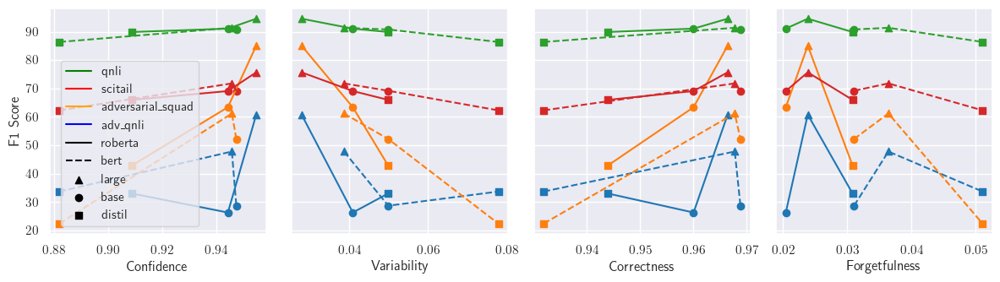

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

data_df = qnli_results

# Assuming snli_results is your DataFrame
# Filtering the DataFrame for 'roberta' and 'bert' models
roberta_data = data_df[data_df['MODEL_NAME'].str.contains('roberta')]
bert_data = data_df[data_df['MODEL_NAME'].str.contains('bert') & ~data_df['MODEL_NAME'].str.contains('roberta')]

# Sort the data by 'MODEL_NAME'
roberta_data = roberta_data.sort_values('MODEL_NAME')
bert_data = bert_data.sort_values('MODEL_NAME')

# Define the metrics for the plots
metrics = ['confidence', 'variability', 'correctness', 'forgetfulness']

# Setting up the subplots
sns.set(style="darkgrid")
fig, axes = plt.subplots(1, 4, figsize=(12, 3.5))  # 1 row, 4 columns

# Get unique datasets and sort them
datasets = sorted(data_df['DATASET_NAME'].unique())
colors = sns.color_palette("tab10", len(datasets))

# Function to determine marker based on model name
def get_marker(model_name):
    if 'large' in model_name:
        return '^'  # Triangle marker
    elif 'distil' in model_name:
        return 's'  # Square marker
    else:
        return 'o'  # Default to circle

# Loop through each metric and create a subplot
for i, metric in enumerate(metrics):
    ax = axes[i]

    # Plotting 'roberta' models
    for j, dataset in enumerate(datasets):
        subset = roberta_data[roberta_data['DATASET_NAME'] == dataset]
        sns.lineplot(ax=ax, x=subset[metric], y=subset['f1'], color=colors[j], linestyle='-')
        for index, row in subset.iterrows():
            ax.scatter([row[metric]], [row['f1']], marker=get_marker(row['MODEL_NAME']), color=colors[j])

    # Plotting 'bert' models
    for j, dataset in enumerate(datasets):
        subset = bert_data[bert_data['DATASET_NAME'] == dataset]
        if not subset.empty:
            sns.lineplot(ax=ax, x=subset[metric], y=subset['f1'], color=colors[j], linestyle='--')
            for index, row in subset.iterrows():
                ax.scatter([row[metric]], [row['f1']], marker=get_marker(row['MODEL_NAME']), color=colors[j])

    # Setting titles and labels
    # ax.set_title(f"{metric.title()} vs F1 score")
    ax.set_xlabel(metric.title())
    if i == 0:
        ax.set_ylabel("F1 Score")
    else:
        ax.set_ylabel("")
        ax.set_yticklabels([])  # This removes the y-axis ticks

# Add a legend to the first plot only
# axes[0].legend(title='Model - Dataset', loc='upper right', bbox_to_anchor=(0.5, 1), borderaxespad=0.)

# Adjust layout to prevent overlap
plt.tight_layout()
axes[0].plot([], [], color='green', label='qnli')   # Green line for 'multi_nli'
axes[0].plot([], [], color='red', label='scitail')          # Red line for 'snli'
axes[0].plot([], [], color='orange', label='adversarial_squad')# Orange line for 'diagnostics'
axes[0].plot([], [], color='blue', label='adv_qnli')     # Blue line for 'adv_mnli'
axes[0].plot([], [], color='black', label='roberta')     # Black line for 'roberta'
axes[0].plot([], [], color='black', linestyle='dashed', label='bert') # Black dashed line for 'bert'
axes[0].scatter([], [], marker='^', color='black', label='large')     # Triangle for 'large'
axes[0].scatter([], [], marker='o', color='black', label='base')      # Circle for 'base'
axes[0].scatter([], [], marker='s', color='black', label='distil')    # Square for 'distil'
axes[0].legend(loc='center left', bbox_to_anchor=(0.05, 0.4), borderaxespad=0.)

# Show the plots
plt.savefig('images/paper/qnli-training-dynamic-to-f1-score.png', dpi=300)
plt.show()


## Plotting the shift visually (colored scatterplot)

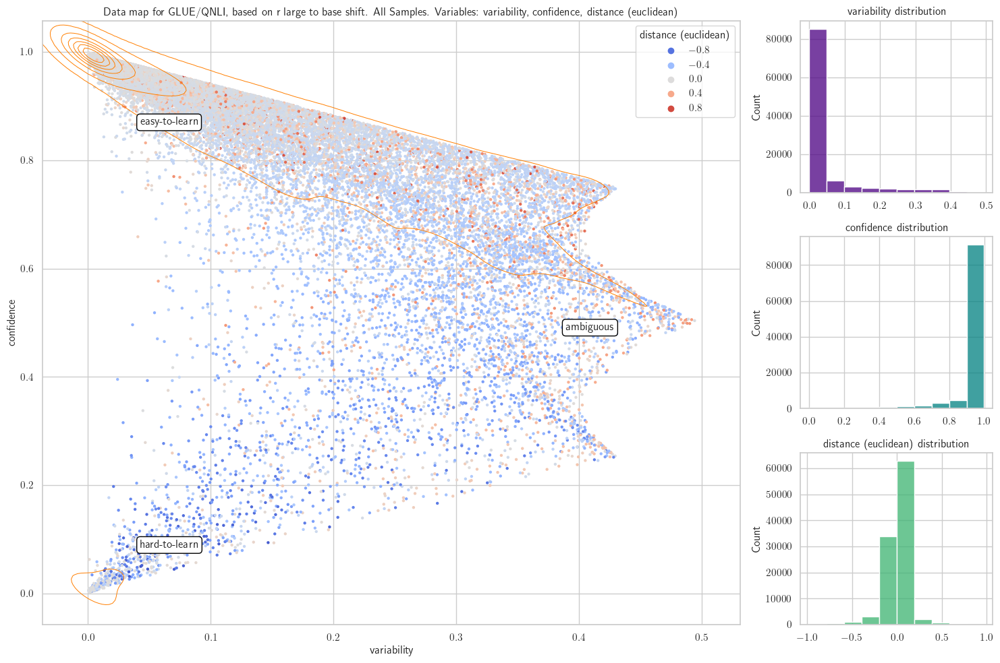

In [ ]:
points1 = np.array(list(zip(qvar3, qconf3)))
points2 = np.array(list(zip(qvar2, qconf2)))

# distances = np.sqrt(np.sum((points1 - points2) ** 2, axis=1))
distances = qconf2 - qconf3

# def plot_datamap(
#         var1, # x axis
#         var2, # y axis
#         var3, # (z axis)
#         var1_name='variability',
#         var2_name='confidence',
#         var3_name='correctness',
#         dataset_name='glue/qnli',
#         model_name='distilbert-base-cased',
#         subdir='',
#         tag='All Samples',
#     ):

fig = plot_datamap(
    qvar2,
    qconf2,
    distances,
    var1_name='variability',
    var2_name='confidence',
    var3_name='distance (euclidean)',
    dataset_name='glue/qnli',
    model_name='r large to base shift',
    subdir='',
    tag='All Samples',
    opacity_changing=False,
    # plot_sorted=True
)

In [12]:
t = []

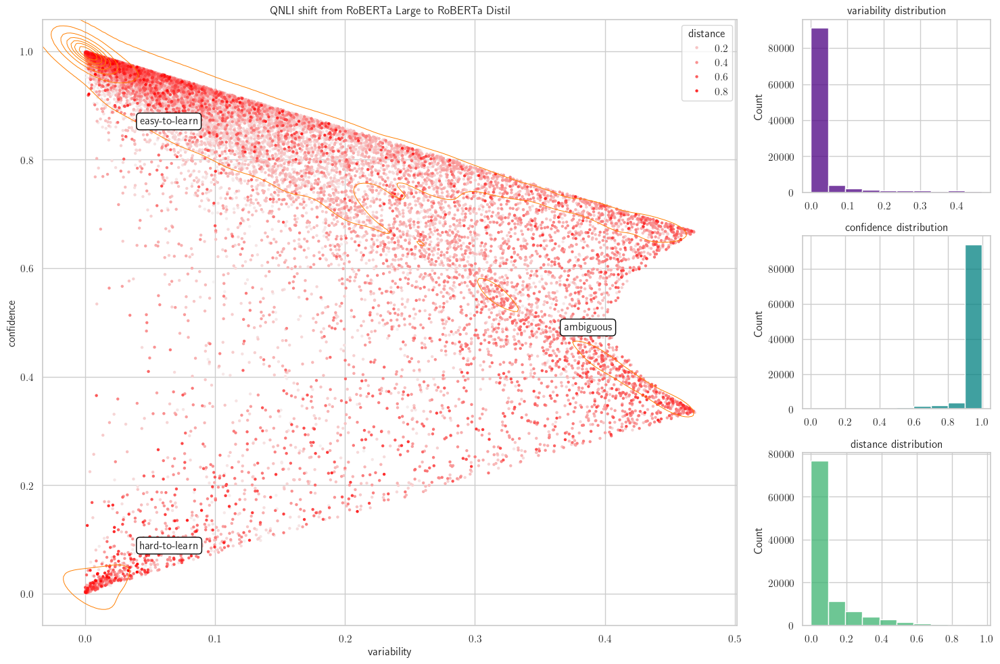

In [32]:
points1 = np.array(list(zip(var3q, conf3q)))
points2 = np.array(list(zip(var1q, conf1q)))

distances = np.sqrt(np.sum((points1 - points2) ** 2, axis=1))


fig = plot_datamap(
    var3q,
    conf3q,
    distances,
    var1_name='variability',
    var2_name='confidence',
    var3_name='distance',
    graph_title='QNLI shift from RoBERTa Large to RoBERTa Distil',
    plot_sorted=True
)


In [17]:
fig.savefig('images/qnli_shift_from_roberta_large_to_roberta_distil.png', dpi=300)

## Qualitative Analysis of the most-moved values from roberta large and roberta distil

## Plotting the moving of ambiguous data points

### QNLI

In [ ]:
percent = 0.3
idxs = qidxs1
var = qvar1
conf = qconf1
corr = qcorr1
forg = qforg1

e_ind = get_data_subset(idxs, var, conf, corr, forg, p_easytolearn=percent)
e_var3 = [qtddict3[str(ind)]['variability'] for ind in e_ind]
e_conf3 = [qtddict3[str(ind)]['confidence'] for ind in e_ind]

e_var2 = [qtddict2[str(ind)]['variability'] for ind in e_ind]
e_conf2 = [qtddict2[str(ind)]['confidence'] for ind in e_ind]

e_var1 = [qtddict1[str(ind)]['variability'] for ind in e_ind]
e_conf1 = [qtddict1[str(ind)]['confidence'] for ind in e_ind]
# ===================================
a_ind = get_data_subset(idxs, var, conf, corr, forg, p_ambiguous=percent)
a_var3 = [qtddict3[str(ind)]['variability'] for ind in a_ind]
a_conf3 = [qtddict3[str(ind)]['confidence'] for ind in a_ind]

a_var2 = [qtddict2[str(ind)]['variability'] for ind in a_ind]
a_conf2 = [qtddict2[str(ind)]['confidence'] for ind in a_ind]

a_var1 = [qtddict1[str(ind)]['variability'] for ind in a_ind]
a_conf1 = [qtddict1[str(ind)]['confidence'] for ind in a_ind]
# ===================================
h_ind = get_data_subset(idxs, var, conf, corr, forg, p_hardtolearn=percent)
h_var3 = [qtddict3[str(ind)]['variability'] for ind in h_ind]
h_conf3 = [qtddict3[str(ind)]['confidence'] for ind in h_ind]

h_var2 = [qtddict2[str(ind)]['variability'] for ind in h_ind]
h_conf2 = [qtddict2[str(ind)]['confidence'] for ind in h_ind]

h_var1 = [qtddict1[str(ind)]['variability'] for ind in h_ind]
h_conf1 = [qtddict1[str(ind)]['confidence'] for ind in h_ind]
data = [
    (e_var3, e_conf3), (e_var2, e_conf2), (e_var1, e_conf1),
    (a_var3, a_conf3), (a_var2, a_conf2), (a_var1, a_conf1),
    (h_var3, h_conf3), (h_var2, h_conf2), (h_var1, h_conf1),

]

Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.


<ipython-input-11-79d0456785d2>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')
<ipython-input-11-79d0456785d2>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')
<ipython-input-11-79d0456785d2>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')
<ipython-input-11-79d0456785d2>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')
<ipython

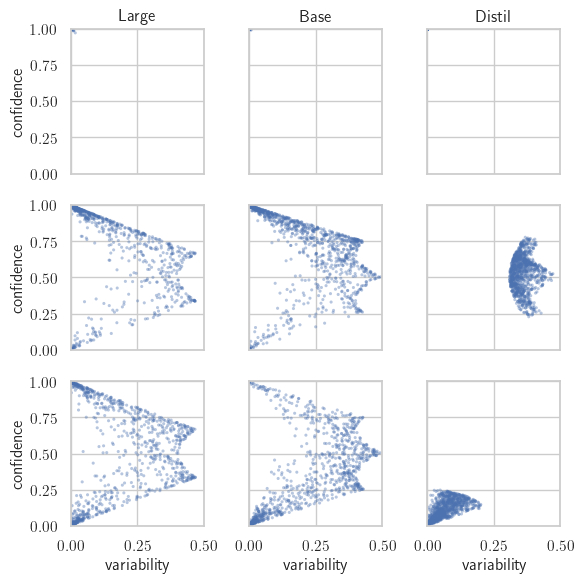

In [ ]:
fig = plot_small_datamaps(data, alpha=0.4)
fig.savefig('images/paper/qnli-roberta-1-percent-region-shift_from_distil.png', dpi=300)

In [ ]:
percent = 0.5
idxs = qidxs3
var = qvar3
conf = qconf3
corr = qcorr3
forg = qforg3

e_ind = get_data_subset(idxs, var, conf, corr, forg, p_easytolearn=percent)
e_var3 = [qtddict3[str(ind)]['variability'] for ind in e_ind]
e_conf3 = [qtddict3[str(ind)]['confidence'] for ind in e_ind]

e_var2 = [qtddict2[str(ind)]['variability'] for ind in e_ind]
e_conf2 = [qtddict2[str(ind)]['confidence'] for ind in e_ind]

e_var1 = [qtddict1[str(ind)]['variability'] for ind in e_ind]
e_conf1 = [qtddict1[str(ind)]['confidence'] for ind in e_ind]
# ===================================
a_ind = get_data_subset(idxs, var, conf, corr, forg, p_ambiguous=percent)
a_var3 = [qtddict3[str(ind)]['variability'] for ind in a_ind]
a_conf3 = [qtddict3[str(ind)]['confidence'] for ind in a_ind]

a_var2 = [qtddict2[str(ind)]['variability'] for ind in a_ind]
a_conf2 = [qtddict2[str(ind)]['confidence'] for ind in a_ind]

a_var1 = [qtddict1[str(ind)]['variability'] for ind in a_ind]
a_conf1 = [qtddict1[str(ind)]['confidence'] for ind in a_ind]
# ===================================
h_ind = get_data_subset(idxs, var, conf, corr, forg, p_hardtolearn=percent)
h_var3 = [qtddict3[str(ind)]['variability'] for ind in h_ind]
h_conf3 = [qtddict3[str(ind)]['confidence'] for ind in h_ind]

h_var2 = [qtddict2[str(ind)]['variability'] for ind in h_ind]
h_conf2 = [qtddict2[str(ind)]['confidence'] for ind in h_ind]

h_var1 = [qtddict1[str(ind)]['variability'] for ind in h_ind]
h_conf1 = [qtddict1[str(ind)]['confidence'] for ind in h_ind]
data = [
    (e_var3, e_conf3), (e_var2, e_conf2), (e_var1, e_conf1),
    (a_var3, a_conf3), (a_var2, a_conf2), (a_var1, a_conf1),
    (h_var3, h_conf3), (h_var2, h_conf2), (h_var1, h_conf1),

]

Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.


In [ ]:
qconf3

array([0.9823067 , 0.9982121 , 0.997808  , ..., 0.97642612, 0.99802699,
       0.9977711 ])

In [ ]:
x = 0.90  # set your threshold value here

# Count values greater than x
count_over_x = np.sum(qconf3 > x)

# Calculate the percentage
percentage = (count_over_x / len(qconf3)) * 100
percentage
# sorted(sconf3)[::-1][90000]

89.82366363384665

In [ ]:
x = 0.90  # set your threshold value here

# Count values greater than x
count_over_x = np.sum(qconf6 > x)

# Calculate the percentage
percentage = (count_over_x / len(qconf6)) * 100
percentage
# sorted(sconf3)[::-1][90000]

85.53316212061904

In [ ]:
x = 0.90  # set your threshold value here

# Count values greater than x
count_over_x = np.sum(sconf3 > x)

# Calculate the percentage
percentage = (count_over_x / len(sconf3)) * 100
percentage
# sorted(sconf3)[::-1][90000]

77.63600000000001

In [ ]:
x = 0.90  # set your threshold value here

# Count values greater than x
count_over_x = np.sum(sconf6 > x)

# Calculate the percentage
percentage = (count_over_x / len(sconf6)) * 100
percentage
# sorted(sconf3)[::-1][90000]

76.46

<ipython-input-11-79d0456785d2>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')
<ipython-input-11-79d0456785d2>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')
<ipython-input-11-79d0456785d2>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')
<ipython-input-11-79d0456785d2>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')
<ipython

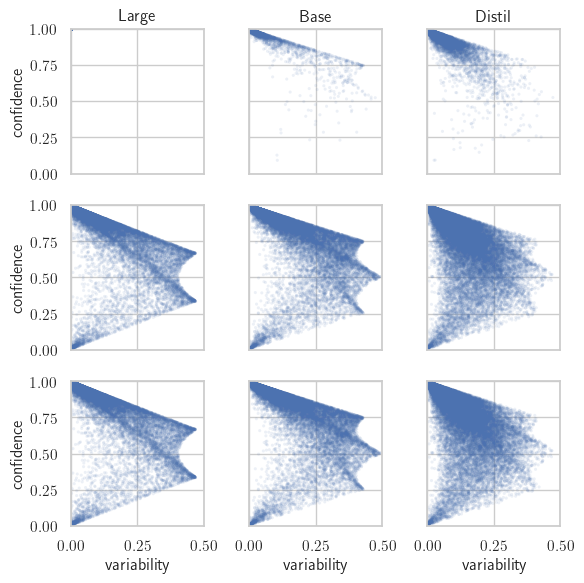

In [ ]:
fig = plot_small_datamaps(data, alpha=0.1)
fig.savefig('images/paper/qnli-roberta-1-percent-region-shift.png', dpi=300)

In [ ]:
percent = 0.02
idxs = qidxs6
var = qvar6
conf = qconf6
corr = qcorr6
forg = qforg6

e_ind = get_data_subset(idxs, var, conf, corr, forg, p_easytolearn=percent)
e_var6 = [qtddict6[str(ind)]['variability'] for ind in e_ind]
e_conf6 = [qtddict6[str(ind)]['confidence'] for ind in e_ind]

e_var5 = [qtddict5[str(ind)]['variability'] for ind in e_ind]
e_conf5 = [qtddict5[str(ind)]['confidence'] for ind in e_ind]

e_var4 = [qtddict4[str(ind)]['variability'] for ind in e_ind]
e_conf4 = [qtddict4[str(ind)]['confidence'] for ind in e_ind]
# ===================================
a_ind = get_data_subset(idxs, var, conf, corr, forg, p_ambiguous=percent)
a_var6 = [qtddict6[str(ind)]['variability'] for ind in a_ind]
a_conf6 = [qtddict6[str(ind)]['confidence'] for ind in a_ind]

a_var5 = [qtddict5[str(ind)]['variability'] for ind in a_ind]
a_conf5 = [qtddict5[str(ind)]['confidence'] for ind in a_ind]

a_var4 = [qtddict4[str(ind)]['variability'] for ind in a_ind]
a_conf4 = [qtddict4[str(ind)]['confidence'] for ind in a_ind]
# ===================================
h_ind = get_data_subset(idxs, var, conf, corr, forg, p_hardtolearn=percent)
h_var6 = [qtddict6[str(ind)]['variability'] for ind in h_ind]
h_conf6 = [qtddict6[str(ind)]['confidence'] for ind in h_ind]

h_var5 = [qtddict5[str(ind)]['variability'] for ind in h_ind]
h_conf5 = [qtddict5[str(ind)]['confidence'] for ind in h_ind]

h_var4 = [qtddict4[str(ind)]['variability'] for ind in h_ind]
h_conf4 = [qtddict4[str(ind)]['confidence'] for ind in h_ind]
data = [
    (e_var6, e_conf6), (e_var5, e_conf5), (e_var4, e_conf4),
    (a_var6, a_conf6), (a_var5, a_conf5), (a_var4, a_conf4),
    (h_var6, h_conf6), (h_var5, h_conf5), (h_var4, h_conf4),

]


Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.


<ipython-input-11-79d0456785d2>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')
<ipython-input-11-79d0456785d2>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')
<ipython-input-11-79d0456785d2>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')
<ipython-input-11-79d0456785d2>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=alpha, legend='auto', ax=ax, edgecolor='none')
<ipython

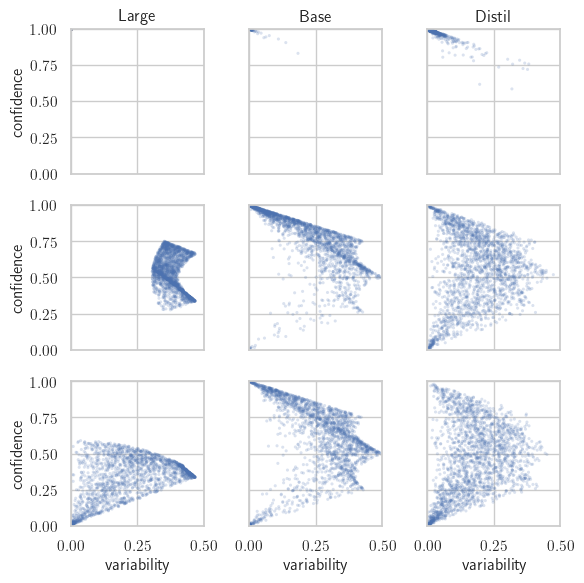

In [ ]:
fig = plot_small_datamaps(data, alpha=0.2)
fig.savefig('images/paper/qnli-bert-1-percent-region-shift.png', dpi=300)

### SNLI

In [ ]:
percent = 0.02
idxs = sidxs3
var = svar3
conf = sconf3
corr = scorr3
forg = sforg3

e_ind = get_data_subset(idxs, var, conf, corr, forg, p_easytolearn=percent)
e_var3 = [stddict3[str(ind)]['variability'] for ind in e_ind]
e_conf3 = [stddict3[str(ind)]['confidence'] for ind in e_ind]

e_var2 = [stddict2[str(ind)]['variability'] for ind in e_ind]
e_conf2 = [stddict2[str(ind)]['confidence'] for ind in e_ind]

e_var1 = [stddict1[str(ind)]['variability'] for ind in e_ind]
e_conf1 = [stddict1[str(ind)]['confidence'] for ind in e_ind]
# ===================================
a_ind = get_data_subset(idxs, var, conf, corr, forg, p_ambiguous=percent)
a_var3 = [stddict3[str(ind)]['variability'] for ind in a_ind]
a_conf3 = [stddict3[str(ind)]['confidence'] for ind in a_ind]

a_var2 = [stddict2[str(ind)]['variability'] for ind in a_ind]
a_conf2 = [stddict2[str(ind)]['confidence'] for ind in a_ind]

a_var1 = [stddict1[str(ind)]['variability'] for ind in a_ind]
a_conf1 = [stddict1[str(ind)]['confidence'] for ind in a_ind]
# ===================================
h_ind = get_data_subset(idxs, var, conf, corr, forg, p_hardtolearn=percent)
h_var3 = [stddict3[str(ind)]['variability'] for ind in h_ind]
h_conf3 = [stddict3[str(ind)]['confidence'] for ind in h_ind]

h_var2 = [stddict2[str(ind)]['variability'] for ind in h_ind]
h_conf2 = [stddict2[str(ind)]['confidence'] for ind in h_ind]

h_var1 = [stddict1[str(ind)]['variability'] for ind in h_ind]
h_conf1 = [stddict1[str(ind)]['confidence'] for ind in h_ind]
data = [
    (e_var3, e_conf3), (e_var2, e_conf2), (e_var1, e_conf1),
    (a_var3, a_conf3), (a_var2, a_conf2), (a_var1, a_conf1),
    (h_var3, h_conf3), (h_var2, h_conf2), (h_var1, h_conf1),

]

Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.


<ipython-input-10-e60289ccd37d>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=0.4, legend='auto', ax=ax, edgecolor='none')
<ipython-input-10-e60289ccd37d>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=0.4, legend='auto', ax=ax, edgecolor='none')
<ipython-input-10-e60289ccd37d>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=0.4, legend='auto', ax=ax, edgecolor='none')
<ipython-input-10-e60289ccd37d>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=0.4, legend='auto', ax=ax, edgecolor='none')
<ipython-input-1

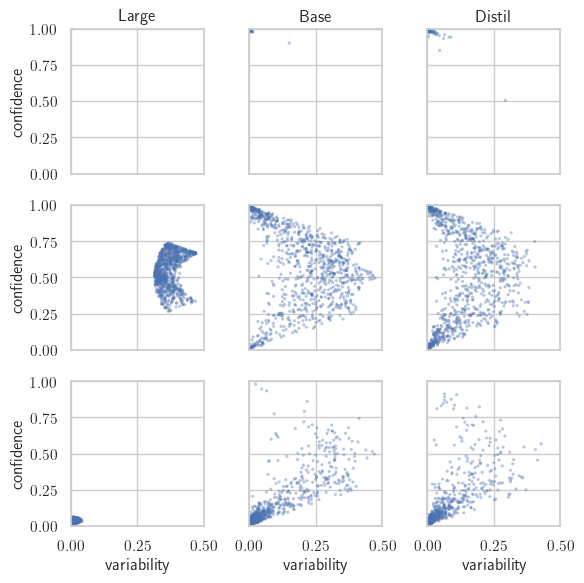

In [ ]:
fig = plot_small_datamaps(data)
fig.savefig('images/paper/snli-roberta-1-percent-region-shift.png', dpi=300)

In [ ]:
percent = 0.01
idxs = sidxs6
var = svar6
conf = sconf6
corr = scorr6
forg = sforg6

e_ind = get_data_subset(idxs, var, conf, corr, forg, p_easytolearn=percent)
e_var6 = [stddict6[str(ind)]['variability'] for ind in e_ind]
e_conf6 = [stddict6[str(ind)]['confidence'] for ind in e_ind]

e_var5 = [stddict5[str(ind)]['variability'] for ind in e_ind]
e_conf5 = [stddict5[str(ind)]['confidence'] for ind in e_ind]

e_var4 = [stddict4[str(ind)]['variability'] for ind in e_ind]
e_conf4 = [stddict4[str(ind)]['confidence'] for ind in e_ind]
# ===================================
a_ind = get_data_subset(idxs, var, conf, corr, forg, p_ambiguous=percent)
a_var6 = [stddict6[str(ind)]['variability'] for ind in a_ind]
a_conf6 = [stddict6[str(ind)]['confidence'] for ind in a_ind]

a_var5 = [stddict5[str(ind)]['variability'] for ind in a_ind]
a_conf5 = [stddict5[str(ind)]['confidence'] for ind in a_ind]

a_var4 = [stddict4[str(ind)]['variability'] for ind in a_ind]
a_conf4 = [stddict4[str(ind)]['confidence'] for ind in a_ind]
# ===================================
h_ind = get_data_subset(idxs, var, conf, corr, forg, p_hardtolearn=percent)
h_var6 = [stddict6[str(ind)]['variability'] for ind in h_ind]
h_conf6 = [stddict6[str(ind)]['confidence'] for ind in h_ind]

h_var5 = [stddict5[str(ind)]['variability'] for ind in h_ind]
h_conf5 = [stddict5[str(ind)]['confidence'] for ind in h_ind]

h_var4 = [stddict4[str(ind)]['variability'] for ind in h_ind]
h_conf4 = [stddict4[str(ind)]['confidence'] for ind in h_ind]
data = [
    (e_var6, e_conf6), (e_var5, e_conf5), (e_var4, e_conf4),
    (a_var6, a_conf6), (a_var5, a_conf5), (a_var4, a_conf4),
    (h_var6, h_conf6), (h_var5, h_conf5), (h_var4, h_conf4),

]


Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.
Fetching indices of specified training dynamics subset.


<ipython-input-10-e60289ccd37d>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=0.4, legend='auto', ax=ax, edgecolor='none')
<ipython-input-10-e60289ccd37d>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=0.4, legend='auto', ax=ax, edgecolor='none')
<ipython-input-10-e60289ccd37d>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=0.4, legend='auto', ax=ax, edgecolor='none')
<ipython-input-10-e60289ccd37d>:927: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=data[var1_name], y=data[var2_name], palette="coolwarm", s=5, alpha=0.4, legend='auto', ax=ax, edgecolor='none')
<ipython-input-1

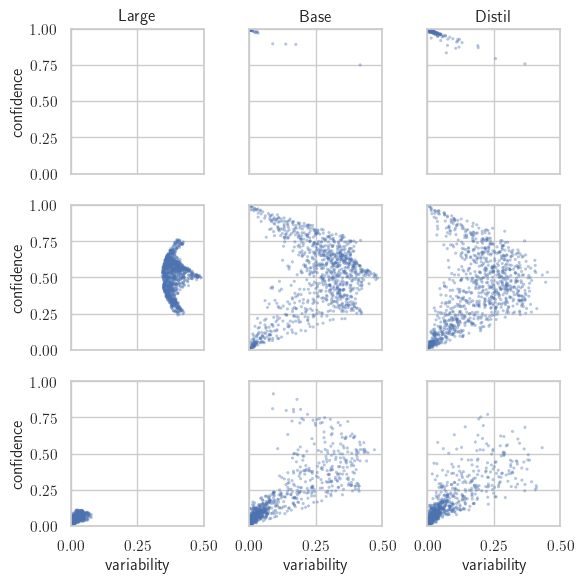

In [ ]:
fig = plot_small_datamaps(data)
fig.savefig('images/paper/snli-bert-1-percent-region-shift.png', dpi=300)

### Analysis of Data Points that Small Models get but large dont

In [ ]:
hard_for_blarge_easy_for_bbase = [(ind, qtddict5[str(ind)]) for ind in h_ind if qtddict5[str(ind)]['confidence'] > 0.90]

In [ ]:
qnli_train_unshuffled, _, _, _ = get_datasets('glue/qnli')

Fetching dataset: glue/qnli


Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/104743 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/glue/qnli/2.0.0.incompleteS44HZV/glue-train.tfrecord*...:   0%|          |…

Generating validation examples...:   0%|          | 0/5463 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/glue/qnli/2.0.0.incompleteS44HZV/glue-validation.tfrecord*...:   0%|      …

Generating test examples...:   0%|          | 0/5463 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/glue/qnli/2.0.0.incompleteS44HZV/glue-test.tfrecord*...:   0%|          | …

Dataset glue downloaded and prepared to /root/tensorflow_datasets/glue/qnli/2.0.0. Subsequent calls will reuse this data.


In [ ]:
for i,d in enumerate(qnli_train_unshuffled):
    if d['idx'] == 93363: print(d)

{'idx': <tf.Tensor: shape=(), dtype=int32, numpy=93363>, 'label': <tf.Tensor: shape=(), dtype=int64, numpy=1>, 'question': <tf.Tensor: shape=(), dtype=string, numpy=b'Who passed the Osborne judgment?'>, 'sentence': <tf.Tensor: shape=(), dtype=string, numpy=b'The 1910 election saw 42 Labour MPs elected to the House of Commons, a significant victory since, a year before the election, the House of Lords had passed the Osborne judgment ruling that Trades Unions in the United Kingdom could no longer donate money to fund the election campaigns and wages of Labour MPs.'>}


KeyboardInterrupt: 

## Plotting Distance from Easy to Learn vs. Shift

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import linregress


def plot_data_shift(
    distance_x,
    distance_y,
    x_name='Distance from EasyToLearn (0,1)',
    y_name='Distance Moved Between Models',
    title='',
    subset_of_data=None):

    if subset_of_data:
        distance_x = distance_x[:subset_of_data]
        distance_y = distance_y[:subset_of_data]

    # Linear regression
    slope, intercept, r_value, p_value, std_err = linregress(distance_x, distance_y)
    line = slope * distance_x + intercept

    # Creating figure and axes with a larger size
    fig, ax = plt.subplots(figsize=(4,3))  # Adjusted figure size

    # Plotting on the axes
    ax.scatter(distance_x, distance_y, s=0.5, alpha=0.1)
    ax.plot(distance_x, line, 'r', label=f'Slope: {slope:.2f}')
    ax.set_xlabel(x_name)
    ax.set_ylabel(y_name)
    ax.set_title(title)
    ax.legend(loc='upper right')

    plt.tight_layout()  # Adjusts the plot to ensure everything fits
    plt.show()

    return fig

### Roberta

In [ ]:
import numpy as np

# Assuming qvar3, qconf3, qvar1, qconf1 are numpy arrays
# percentage_to_exclude = 0.99
# threshold_index = int(len(qconf3) * (1 - percentage_to_exclude / 100))
# threshold_value = np.partition(qconf3, threshold_index)[threshold_index]

threshold_value = 1 # remove points below this value of confidence
# Step 2: Get indices of qconf3 that are less than or equal to the median
indices = np.where(qconf3 <= threshold_value)[0]
print(len(indices))

# Step 3: Filter qvar3, qvar1, and qconf1 using these indices
filtered_qvar3 = qvar3[indices]
filtered_qconf3 = qconf3[indices]
filtered_qvar1 = qvar1[indices]
filtered_qconf1 = qconf1[indices]

# Step 4: Create points1 and points2 using the filtered values
points1 = np.array(list(zip(filtered_qvar3, filtered_qconf3)))
points2 = np.array(list(zip(filtered_qvar1, filtered_qconf1)))

easytolearn_point = np.array([0, 1])
ambiguous_point = np.array([0.5, 0.5])
hardtolearn_point = np.array([0, 0])

distances = np.sqrt(np.sum((points1 - points2) ** 2, axis=1))
distances_from_easytolearn = np.sqrt(np.sum((points1 - easytolearn_point) ** 2, axis=1))
distances_from_ambiguous = np.sqrt(np.sum((points1 - ambiguous_point) ** 2, axis=1))
distances_from_hardtolearn = np.sqrt(np.sum((points1 - hardtolearn_point) ** 2, axis=1))

104743


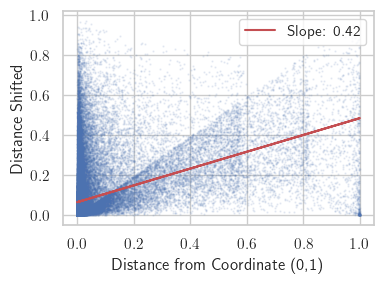

In [ ]:
fig = plot_data_shift(
    distances_from_easytolearn,
    distances,
    x_name = 'Distance from Coordinate (0,1)',
    y_name = 'Distance Shifted',
    title='',
)

fig.savefig('images/paper/roberta-large-to-roberta-distil-easytolearn-shift.png', dpi=300, bbox_inches='tight')

In [ ]:
fig

In [ ]:
# Your data
points1 = np.array(list(zip(qvar3, qconf3))) # base roberta large
points2 = np.array(list(zip(qvar1, qconf1)))

easytolearn_point = np.array([0, 1])
ambiguous_point = np.array([0.5, 0.5])
hardtolearn_point = np.array([0, 0])

distances = np.sqrt(np.sum((points1 - points2) ** 2, axis=1))
distances_from_easytolearn = np.sqrt(np.sum((points1 - easytolearn_point) ** 2, axis=1))
distances_from_ambiguous = np.sqrt(np.sum((points1 - ambiguous_point) ** 2, axis=1))
distances_from_hardtolearn = np.sqrt(np.sum((points1 - hardtolearn_point) ** 2, axis=1))

In [ ]:
plot_data_shift(
    distances_from_easytolearn,
    distances,
    x_name = 'Distance from EasyToLearn (0,1)',
    y_name = 'Distance Shifted',
    title='QNLI: Shift from Roberta Large to Roberta Distil',
)

In [ ]:
# Your data
points1 = np.array(list(zip(svar3, sconf3))) # base roberta large
points2 = np.array(list(zip(svar2, sconf2)))

easytolearn_point = np.array([0, 1])
ambiguous_point = np.array([0.5, 0.5])
hardtolearn_point = np.array([0, 0])

distances = np.sqrt(np.sum((points1 - points2) ** 2, axis=1))
distances_from_easytolearn = np.sqrt(np.sum((points1 - easytolearn_point) ** 2, axis=1))
distances_from_ambiguous = np.sqrt(np.sum((points1 - ambiguous_point) ** 2, axis=1))
distances_from_hardtolearn = np.sqrt(np.sum((points1 - hardtolearn_point) ** 2, axis=1))

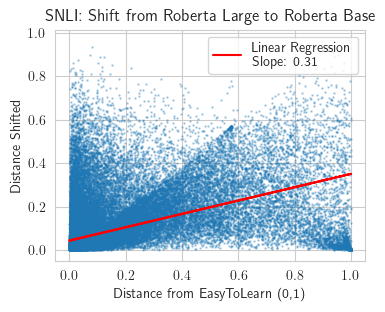

In [ ]:
plot_data_shift(
    distances_from_easytolearn,
    distances,
    x_name = 'Distance from EasyToLearn (0,1)',
    y_name = 'Distance Shifted',
    title='SNLI: Shift from Roberta Large to Roberta Base',
)

In [ ]:
# Your data
points1 = np.array(list(zip(svar3, sconf3))) # base roberta large
points2 = np.array(list(zip(svar1, sconf1)))

easytolearn_point = np.array([0, 1])
ambiguous_point = np.array([0.5, 0.5])
hardtolearn_point = np.array([0, 0])

distances = np.sqrt(np.sum((points1 - points2) ** 2, axis=1))
distances_from_easytolearn = np.sqrt(np.sum((points1 - easytolearn_point) ** 2, axis=1))
distances_from_ambiguous = np.sqrt(np.sum((points1 - ambiguous_point) ** 2, axis=1))
distances_from_hardtolearn = np.sqrt(np.sum((points1 - hardtolearn_point) ** 2, axis=1))

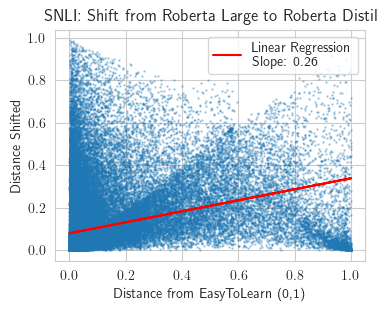

In [ ]:
plot_data_shift(
    distances_from_easytolearn,
    distances,
    x_name = 'Distance from EasyToLearn (0,1)',
    y_name = 'Distance Shifted',
    title='SNLI: Shift from Roberta Large to Roberta Distil',
)

In [ ]:
# Your data
points1 = np.array(list(zip(svar3, sconf3))) # base roberta large
points2 = np.array(list(zip(svar1, sconf1)))

easytolearn_point = np.array([0, 1])
ambiguous_point = np.array([0.5, 0.5])
hardtolearn_point = np.array([0, 0])

distances = np.sqrt(np.sum((points1 - points2) ** 2, axis=1))
distances_from_easytolearn = np.sqrt(np.sum((points1 - easytolearn_point) ** 2, axis=1))
distances_from_ambiguous = np.sqrt(np.sum((points1 - ambiguous_point) ** 2, axis=1))
distances_from_hardtolearn = np.sqrt(np.sum((points1 - hardtolearn_point) ** 2, axis=1))

### Bert

In [ ]:
# Your data
points1 = np.array(list(zip(qvar6, qconf6))) # bert large
points2 = np.array(list(zip(qvar5, qconf5)))

easytolearn_point = np.array([0, 1])
ambiguous_point = np.array([0.5, 0.5])
hardtolearn_point = np.array([0, 0])

distances = np.sqrt(np.sum((points1 - points2) ** 2, axis=1))
distances_from_easytolearn = np.sqrt(np.sum((points1 - easytolearn_point) ** 2, axis=1))
distances_from_ambiguous = np.sqrt(np.sum((points1 - ambiguous_point) ** 2, axis=1))
distances_from_hardtolearn = np.sqrt(np.sum((points1 - hardtolearn_point) ** 2, axis=1))

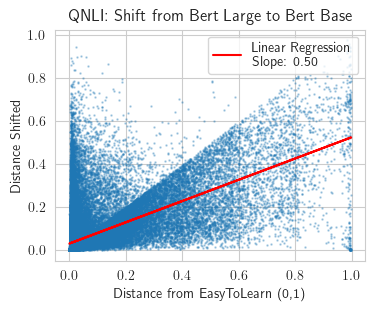

In [ ]:
plot_data_shift(
    distances_from_easytolearn,
    distances,
    x_name = 'Distance from EasyToLearn (0,1)',
    y_name = 'Distance Shifted',
    title='QNLI: Shift from Bert Large to Bert Base',
)

In [ ]:
# Your data
points1 = np.array(list(zip(qvar6, qconf6))) # bert large
points2 = np.array(list(zip(qvar4, qconf4)))

easytolearn_point = np.array([0, 1])
ambiguous_point = np.array([0.5, 0.5])
hardtolearn_point = np.array([0, 0])

distances = np.sqrt(np.sum((points1 - points2) ** 2, axis=1))
distances_from_easytolearn = np.sqrt(np.sum((points1 - easytolearn_point) ** 2, axis=1))
distances_from_ambiguous = np.sqrt(np.sum((points1 - ambiguous_point) ** 2, axis=1))
distances_from_hardtolearn = np.sqrt(np.sum((points1 - hardtolearn_point) ** 2, axis=1))

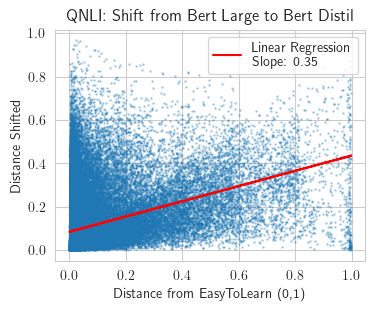

In [ ]:
plot_data_shift(
    distances_from_easytolearn,
    distances,
    x_name = 'Distance from EasyToLearn (0,1)',
    y_name = 'Distance Shifted',
    title='QNLI: Shift from Bert Large to Bert Distil',
)

In [ ]:
# Your data
points1 = np.array(list(zip(svar6, sconf6))) # bert large
points2 = np.array(list(zip(svar5, sconf5)))

easytolearn_point = np.array([0, 1])
ambiguous_point = np.array([0.5, 0.5])
hardtolearn_point = np.array([0, 0])

distances = np.sqrt(np.sum((points1 - points2) ** 2, axis=1))
distances_from_easytolearn = np.sqrt(np.sum((points1 - easytolearn_point) ** 2, axis=1))
distances_from_ambiguous = np.sqrt(np.sum((points1 - ambiguous_point) ** 2, axis=1))
distances_from_hardtolearn = np.sqrt(np.sum((points1 - hardtolearn_point) ** 2, axis=1))

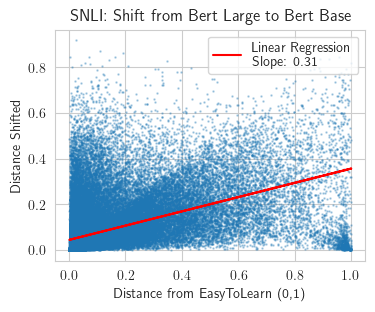

In [ ]:
plot_data_shift(
    distances_from_easytolearn,
    distances,
    x_name = 'Distance from EasyToLearn (0,1)',
    y_name = 'Distance Shifted',
    title='SNLI: Shift from Bert Large to Bert Base',
)

In [ ]:
# Your data
points1 = np.array(list(zip(svar6, sconf6))) # bert large
points2 = np.array(list(zip(svar4, sconf4)))

easytolearn_point = np.array([0, 1])
ambiguous_point = np.array([0.5, 0.5])
hardtolearn_point = np.array([0, 0])

distances = np.sqrt(np.sum((points1 - points2) ** 2, axis=1))
distances_from_easytolearn = np.sqrt(np.sum((points1 - easytolearn_point) ** 2, axis=1))
distances_from_ambiguous = np.sqrt(np.sum((points1 - ambiguous_point) ** 2, axis=1))
distances_from_hardtolearn = np.sqrt(np.sum((points1 - hardtolearn_point) ** 2, axis=1))

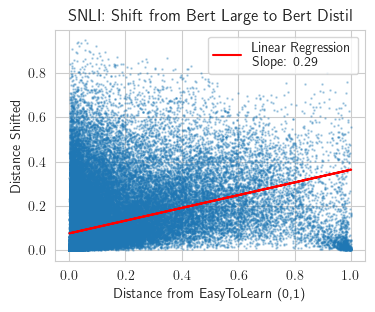

In [ ]:
plot_data_shift(
    distances_from_easytolearn,
    distances,
    x_name = 'Distance from EasyToLearn (0,1)',
    y_name = 'Distance Shifted',
    title='SNLI: Shift from Bert Large to Bert Distil',
)

In [ ]:
# Your data
points1 = np.array(list(zip(svar3, sconf3))) # base roberta large
points2 = np.array(list(zip(svar1, sconf1)))

easytolearn_point = np.array([0, 1])
ambiguous_point = np.array([0.5, 0.5])
hardtolearn_point = np.array([0, 0])

distances = np.sqrt(np.sum((points1 - points2) ** 2, axis=1))
distances_from_easytolearn = np.sqrt(np.sum((points1 - easytolearn_point) ** 2, axis=1))
distances_from_ambiguous = np.sqrt(np.sum((points1 - ambiguous_point) ** 2, axis=1))
distances_from_hardtolearn = np.sqrt(np.sum((points1 - hardtolearn_point) ** 2, axis=1))

## Plotting Just the Adversarial Shifts

## Mean shift vs. Adversarial Performance

# Distribution Divergence

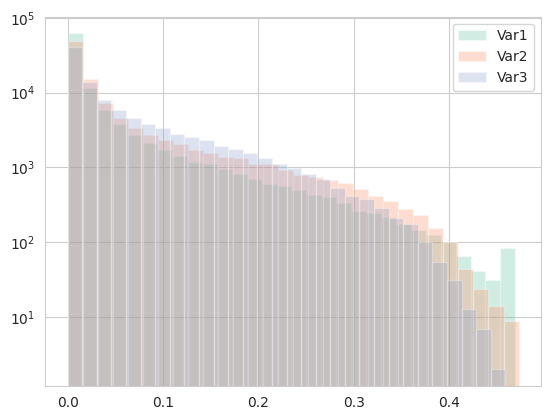

In [ ]:
num_bins = 30  # For example, setting it to 30

plt.hist(var1, bins=num_bins, alpha=0.3, label='Var1')
plt.hist(var2, bins=num_bins, alpha=0.3, label='Var2')
plt.hist(var3, bins=num_bins, alpha=0.3, label='Var3')
plt.legend(loc='upper right')
plt.yscale('log')  # Set the y-axis to a logarithmic scale
plt.show()

In [ ]:
import numpy as np
from scipy.stats import entropy

def normalize(array):
    return array / np.sum(array)

def kl_divergence(array1, array2):
    norm_array1 = normalize(array1)
    norm_array2 = normalize(array2)
    return entropy(norm_array1, norm_array2)

kl_div = kl_divergence(var1, var1)
print("KL Divergence:", kl_div)

KL Divergence: 0.637782879539677


In [ ]:
p[:100]

array([34.12046929, 35.94631143, 37.35734926, 38.31370271, 38.7954937 ,
       38.80353171, 38.35845688, 37.49848885, 36.27606388, 34.75373542,
       32.99975436, 31.08373436, 29.07275261, 27.0281488 , 25.00318086,
       23.04159056, 21.17703785, 19.43329039, 17.82500722, 16.35893468,
       15.03533496, 13.84948723, 12.79313277, 11.85577156, 11.02575413,
       10.29114422,  9.64035367,  9.0625692 ,  8.54800212,  8.08799719,
        7.67503726,  7.30267758,  6.96543844,  6.65867927,  6.37847082,
        6.12147683,  5.88485148,  5.66615497,  5.46328698,  5.27443548,
        5.09803781,  4.93275028,  4.77742319,  4.63107877,  4.49289019,
        4.36216087,  4.23830389,  4.12082193,  4.00928819,  3.90332918,
        3.80260989,  3.70682186,  3.61567424,  3.52888782,  3.44619168,
        3.36732203,  3.29202235,  3.22004443,  3.15114926,  3.08510745,
        3.0216987 ,  2.96071019,  2.90193431,  2.8451662 ,  2.79020178,
        2.73683728,  2.68487092,  2.63410713,  2.58436336,  2.53

# Test Sets (ID and OOD) training dynamic calculation

# Sampling Data Points

In [ ]:
train_u, train, val, test = get_datasets('adversarial_squad')

Fetching dataset: adversarial_squad


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/datasets/load.py:1429: FutureWarning: The repository for squad_adversarial contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/squad_adversarial
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warn

Generating validation split:   0%|          | 0/3560 [00:00<?, ? examples/s]

Map:   0%|          | 0/3560 [00:00<?, ? examples/s]

In [ ]:
tmp_str = """Los Angeles (at 3.7 million people) and San Diego (at 1.3 million people), both in southern California, are the two largest cities in all of California (and two of the eight largest cities in the United States). In southern California there are also twelve cities with more than 200,000 residents and 34 cities over 100,000 in population. Many of southern California's most developed cities lie along or in close proximity to the coast, with the exception of San Bernardino and Riverside. Other than Francisco Riverside , Baltimore is the only other undeveloped northern city not in proximity to the coast."""

In [ ]:
tmp_str[478:]

'Riverside. Other than Francisco Riverside , Baltimore is the only other undeveloped northern city not in proximity to the coast.'

In [ ]:
for i,d in enumerate(val):
    print(d)
    if 1000<i<1200:
        break

{'id': '56be4db0acb8001400a502ee', 'title': 'Super_Bowl_50', 'context': 'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently feature the Arabic numerals 50.', 'question': 'Where did Super Bowl 50 take place?', 'answers': {'text': ['Santa Clara, California', "Levi's Stadium", "Levi's Stadium in the San Fran